### start

In [2]:
# pyright: reportMissingImports=false
# pyright: reportMissingModuleSource=false

import uuid
import random
import hashlib
import os
import sys
import gc
import time
import copy
import logging
import re
from itertools import chain,combinations
import pdb
import math
from pathlib import Path
import datetime
from datetime import datetime,timedelta
import json
import warnings
import yaml
from typing import Dict,Union,List,Any,Tuple
import pytest
import importlib
from dotenv import load_dotenv
import pandas as pd
import numpy as np
import IPython
import requests
import warnings
import boto3
import matplotlib as plt
import sklearn

# load_dotenv(Path("../../../Local/.env"))

# Custom format function for displaying |numbers/
pd.set_option('display.float_format', lambda x: f'{x:.12g}')
# pd.reset_option('display.float_format')

# Suppress warnings
os.environ['PYDEVD_DISABLE_FILE_VALIDATION'] = '1'
warnings.filterwarnings('ignore', message='.*frozen modules.*')
warnings.filterwarnings("ignore", message="MallocStackLogging")

# silence pygame donation request
os.environ['PYGAME_HIDE_SUPPORT_PROMPT'] = "hide"
os.environ['LOGGING_FILE'] = "../../../Local/logs/wallet_modeling.log"
os.environ['NOTIFICATION_SOUNDS_DIR'] = "../../../Local"

# Dark mode charts
plt.rcParams['figure.facecolor'] = '#181818'  # Custom background color (dark gray in this case)
plt.rcParams['axes.facecolor'] = '#181818'
plt.rcParams['text.color'] = '#afc6ba'
plt.rcParams['axes.labelcolor'] = '#afc6ba'
plt.rcParams['xtick.color'] = '#afc6ba'
plt.rcParams['ytick.color'] = '#afc6ba'
plt.rcParams['axes.titlecolor'] = '#afc6ba'
plt.rcParams['text.usetex'] = False
plt.rcParams['mathtext.default'] = 'regular'

# import local modules
# pyright: reportMissingImports=false
sys.path.append('../src')

import sage_utils.config_validation as ucv
import sage_utils.s3_utils as s3u

import sage_wallet_insights.model_evaluation as sime

import sage_wallet_modeling.wallet_modeler as wm
from sage_wallet_modeling.wallet_preprocessor import SageWalletsPreprocessor
import sage_wallet_modeling.wallet_script_modeler as sm
import sage_wallet_modeling.workflow_orchestrator as wo

import script_modeling.entry_helpers as h
# import script_modeling.temporal_cv_model_entry as tme


# import data-science modules
sys.path.append(str(Path("..") / ".." / "data-science" / "src"))
import wallet_insights.model_evaluation as wime
import utils as u
from utils import ConfigError



# reload all modules
modules = [
    ucv, s3u,
    sime,
    wm, sm, wo,
    h,
    wime,
    u,
]

# import utils as u
# Set the custom error handler
ipython = IPython.get_ipython()
# ipython.set_custom_exc((Exception,), u.notify_on_failure)

player = u.AmbientPlayer()
player.stop_all_players()

# configure logger
logger = u.setup_notebook_logger('../logs/notebook_logs.log')
logger.setLevel(logging.INFO)

from IPython.core import ultratb
ultratb.VerboseTB._tb_highlight = "bg:#b45827"


# load all configs
sage_wallets_config = ucv.load_sage_wallets_config(Path('../config/sage_wallets_config.yaml'))
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config(Path('../config/sage_wallets_modeling_config.yaml'))


u.export_code(
    code_directories=[
        # 'config_models',
        'sage_wallet_insights',
        'sage_wallet_modeling',
        'script_modeling',
        # 'sage_utils',
    ],
    # include_config = True,
    # ipynb_notebook = 'DDA-769 coin model score dist toggle.ipynb'
    output_file="temp/sagemaker_code.py"
)

[importlib.reload(module) for module in modules]
u.notify('retro')

logger.milestone("Good morning, let's get to work")

[13/Aug/25 10:54:26] INFO [utils.export_code:1672] Consolidation complete. All files are saved in temp/sagemaker_code.py
[13/Aug/25 10:54:26] MILESTONE [2505902246.<module>:136] Good morning, let's get to work


# Model Training

## Concatenated Model Sequence

#### load all local data

In [9]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


workflow_orch = wo.WalletWorkflowOrchestrator(
    sage_wallets_config,
    sage_wallets_modeling_config
)
workflow_orch.load_all_training_data()

[11/Aug/25 23:43:52] INFO [workflow_orchestrator.load_all_training_data:101] Auto-detected date_suffixes from config: ['210322', '210421', '210521', '210620', '210720', '210819', '210918', '211018', '211117', '211217', '220116', '220215', '220317', '220416', '220516', '220615', '220715', '220814', '220913', '221013', '221112', '221212', '230111', '230210', '230312', '230411', '230511', '230610', '230710', '230809', '230908', '231008', '231107', '231207', '240106', '240205', '240306', '240405', '240505', '240604', '240704', '240803', '241002', '241201', '250130', '250331', '240902', '241101', '241231', '250301', '250430', '250530']
[11/Aug/25 23:43:52] MILESTONE [workflow_orchestrator.load_all_training_data:118] <PROD> Loading training data for 52 periods: ['210322', '210421', '210521', '210620', '210720', '210819', '210918', '211018', '211117', '211217', '220116', '220215', '220317', '220416', '220516', '220615', '220715', '220814', '220913', '221013', '221112', '221212', '230111', '23

#### preprocess and concatenate

In [10]:
results = workflow_orch.preprocess_all_training_data()

[11/Aug/25 23:44:00] INFO [workflow_orchestrator.preprocess_all_training_data:156] Preprocessing 52 date periods...
[11/Aug/25 23:44:00] INFO [wallet_preprocessor.preprocess_training_data:74] Starting preprocessing for SageMaker XGBoost compatibility...
[11/Aug/25 23:44:00] INFO [wallet_preprocessor._handle_missing_values:243] Filled NaN values in 110 columns for x_train.
[11/Aug/25 23:44:00] INFO [wallet_preprocessor._save_preprocessed_df:418] Saved preprocessed train to ../s3_uploads/wallet_training_data_preprocessed/dda_957_coin_model/210322/train.parquet
[11/Aug/25 23:44:00] INFO [wallet_preprocessor._save_preprocessed_df:418] Saved preprocessed train_y to ../s3_uploads/wallet_training_data_preprocessed/dda_957_coin_model/210322/train_y.parquet
[11/Aug/25 23:44:00] INFO [wallet_preprocessor.preprocess_training_data:123] Preprocessed train: 60,736 rows × 231 cols.
[11/Aug/25 23:44:00] INFO [wallet_preprocessor._handle_missing_values:243] Filled NaN values in 110 columns for x_test.


In [11]:
workflow_orch.concatenate_all_preprocessed_data()

[11/Aug/25 23:44:39] INFO [workflow_orchestrator.concatenate_all_preprocessed_data:194] Loading preprocessed training data...
[11/Aug/25 23:44:43] INFO [workflow_orchestrator.concatenate_all_preprocessed_data:197] Beginning concatenation of preprocessed data from Parquet...
[11/Aug/25 23:44:44] INFO [workflow_orchestrator.concatenate_all_preprocessed_data:260] Saved concatenated train_index.parquet with 1148070 rows to ../s3_uploads/wallet_training_data_concatenated/dda_957_coin_model/train_index.parquet
[11/Aug/25 23:50:10] INFO [workflow_orchestrator.concatenate_all_preprocessed_data:267] Saved concatenated train.csv.gz with 1148070 rows to ../s3_uploads/wallet_training_data_concatenated/dda_957_coin_model/train.csv.gz
[11/Aug/25 23:50:10] INFO [workflow_orchestrator.concatenate_all_preprocessed_data:260] Saved concatenated eval_index.parquet with 44811 rows to ../s3_uploads/wallet_training_data_concatenated/dda_957_coin_model/eval_index.parquet
[11/Aug/25 23:50:22] INFO [workflow_or

#### inspect features

In [ ]:
local_s3 = sage_wallets_config['training_data']['local_s3_root']
local_dir = sage_wallets_config['training_data']['local_directory']
local_dir = f"{local_dir}_dev" if sage_wallets_config['training_data']['dataset'] == 'dev' else local_dir
df = pd.read_csv(f'{local_s3}/s3_uploads/wallet_training_data_concatenated/{local_dir}/eval.csv')
with open(f'{local_s3}/s3_uploads/wallet_training_data_concatenated/{local_dir}/metadata.json', 'r') as f:
    metadata = json.load(f)

df.columns = metadata['feature_columns']
u.display_full(df.describe().T)

#### upload

In [12]:
concat_uris = workflow_orch.upload_concatenated_training_data(
    overwrite_existing=True,
    # splits=['val']
)

[11/Aug/25 23:54:34] INFO [credentials.load:1352] Found credentials in shared credentials file: ~/.aws/credentials
[11/Aug/25 23:54:34] INFO [workflow_orchestrator.upload_concatenated_training_data:380] Beginning upload of concatenated training data for splits ['train', 'eval', 'test', 'val', 'train_y', 'eval_y', 'test_y', 'val_y']...
[11/Aug/25 23:54:34] INFO [workflow_orchestrator.upload_concatenated_training_data:383] Uploading concatenated splits in parallel with 4 threads...
[11/Aug/25 23:54:34] INFO [workflow_orchestrator._upload_split:401] Overwriting existing file 's3://wallet-training-data/training-data-concatenated/dda-957-coin-model/train.csv.gz'...
[11/Aug/25 23:54:34] INFO [workflow_orchestrator._upload_split:401] Overwriting existing file 's3://wallet-training-data/training-data-concatenated/dda-957-coin-model/val.csv.gz'...
[11/Aug/25 23:54:34] INFO [workflow_orchestrator._upload_split:401] Overwriting existing file 's3://wallet-training-data/training-data-concatenated/d

### Epoch Shifts Sequence

#### train all epoch shifts

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


workflow_orch = wo.WalletWorkflowOrchestrator(
    sage_wallets_config,
    sage_wallets_modeling_config
)
concat_uris = workflow_orch.upload_concatenated_training_data(overwrite_existing=False)
modeling_results = workflow_orch.train_all_epoch_shift_models(concat_uris)

[12/Aug/25 14:17:32] INFO [credentials.load:1352] Found credentials in shared credentials file: ~/.aws/credentials


[12/Aug/25 14:17:33] INFO [workflow_orchestrator.upload_concatenated_training_data:380] Beginning upload of concatenated training data for splits ['train', 'eval', 'test', 'val', 'train_y', 'eval_y', 'test_y', 'val_y']...
[12/Aug/25 14:17:33] INFO [workflow_orchestrator.upload_concatenated_training_data:383] Uploading concatenated splits in parallel with 4 threads...
[12/Aug/25 14:17:33] INFO [workflow_orchestrator._upload_split:397] File exists, skipping upload of concatenated split 'train': training-data-concatenated/dda-957-coin-model/train.csv.gz
[12/Aug/25 14:17:33] INFO [workflow_orchestrator._upload_split:397] File exists, skipping upload of concatenated split 'test': training-data-concatenated/dda-957-coin-model/test.csv.gz
[12/Aug/25 14:17:33] INFO [workflow_orchestrator._upload_split:397] File exists, skipping upload of concatenated split 'val': training-data-concatenated/dda-957-coin-model/val.csv.gz
[12/Aug/25 14:17:33] INFO [workflow_orchestrator._upload_split:397] File ex

2025-08-12 21:17:39 Starting - Starting the training job2025-08-12 21:17:37 Starting - Starting the training job2025-08-12 21:17:39 Starting - Starting the training job2025-08-12 21:17:37 Starting - Starting the training job2025-08-12 21:17:39 Starting - Starting the training job.2025-08-12 21:17:37 Starting - Starting the training job.....2025-08-12 21:17:42 Starting - Starting the training job2025-08-12 21:17:44 Starting - Starting the training job2025-08-12 21:17:42 Starting - Starting the training job...2025-08-12 21:17:46 Starting - Starting the training job.....................
2025-08-12 21:18:12 Downloading - Downloading input data.
2025-08-12 21:18:09 Downloading - Downloading input data.
2025-08-12 21:17:54 Starting - Preparing the instances for training
2025-08-12 21:18:09 Downloading - Downloading input data..
2025-08-12 21:18:16 Downloading - Downloading input data
2025-08-12 21:18:15 Downloading - Downloading input data..
2025-08-12 21:18:13 Downloading - Downloading inpu

[12/Aug/25 14:21:45] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-240/ws-dda-957--sh-240-0812-141734/output/model.tar.gz
[12/Aug/25 14:21:45] MILESTONE [workflow_orchestrator.train_all_epoch_shift_models:506] Successfully completed training for epoch_shift=-240
[12/Aug/25 14:21:45] INFO [workflow_orchestrator._train_single_epoch_shift:1129] Starting training for epoch_shift=300
[12/Aug/25 14:21:45] INFO [wallet_script_modeler.initiate_script_modeling:57] HPO disabled for sh300, using standard training...
[12/Aug/25 14:21:45] INFO [image_uris._validate_py_version_and_set_if_needed:603] Ignoring unnecessary Python version: py3.
[12/Aug/25 14:21:45] INFO [image_uris._processor:530] Ignoring unnecessary instance type: ml.m6i.2xlarge.


Training seconds: 185
Billable seconds: 185


[12/Aug/25 14:21:46] INFO [wallet_script_modeler._train_single_period_script_model:142] Launching script-mode training job with custom targets: ws-dda-957--sh300-0812-142145
[12/Aug/25 14:21:46] INFO [telemetry_logging.wrapper:92] SageMaker Python SDK will collect telemetry to help us better understand our user's needs, diagnose issues, and deliver additional features.
To opt out of telemetry, please disable via TelemetryOptOut parameter in SDK defaults config. For more information, refer to https://sagemaker.readthedocs.io/en/stable/overview.html#configuring-and-using-defaults-with-the-sagemaker-python-sdk.
[12/Aug/25 14:21:46] INFO [session.submit:1053] Creating training-job with name: ws-dda-957--sh300-0812-142145
[12/Aug/25 14:21:47] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-300/ws-dda-957--sh-300-0812-141734/output/model.tar.gz
[12/Aug/25 14:21:47] MILE

[82]#011eval-aucpr:0.43065
[83]#011eval-aucpr:0.43748
[84]#011eval-aucpr:0.43347
[85]#011eval-aucpr:0.43217
[86]#011eval-aucpr:0.43165
[87]#011eval-aucpr:0.43059
[88]#011eval-aucpr:0.43662
[89]#011eval-aucpr:0.43828
[90]#011eval-aucpr:0.43930
[91]#011eval-aucpr:0.43451
[92]#011eval-aucpr:0.43506
[93]#011eval-aucpr:0.43618
[94]#011eval-aucpr:0.43635
[95]#011eval-aucpr:0.43662
[96]#011eval-aucpr:0.43676


[12/Aug/25 14:21:47] INFO [image_uris._processor:530] Ignoring unnecessary instance type: ml.m6i.2xlarge.
[12/Aug/25 14:21:49] INFO [wallet_script_modeler._train_single_period_script_model:142] Launching script-mode training job with custom targets: ws-dda-957--sh360-0812-142147
[12/Aug/25 14:21:49] INFO [telemetry_logging.wrapper:92] SageMaker Python SDK will collect telemetry to help us better understand our user's needs, diagnose issues, and deliver additional features.
To opt out of telemetry, please disable via TelemetryOptOut parameter in SDK defaults config. For more information, refer to https://sagemaker.readthedocs.io/en/stable/overview.html#configuring-and-using-defaults-with-the-sagemaker-python-sdk.
[12/Aug/25 14:21:50] INFO [session.submit:1053] Creating training-job with name: ws-dda-957--sh360-0812-142147


2025-08-12 21:21:48 Starting - Starting the training job[68]#011eval-aucpr:0.48934
[69]#011eval-aucpr:0.49014
[70]#011eval-aucpr:0.49416
[71]#011eval-aucpr:0.49441
[72]#011eval-aucpr:0.49550
[73]#011eval-aucpr:0.49613
[74]#011eval-aucpr:0.49809
[75]#011eval-aucpr:0.49946
[76]#011eval-aucpr:0.49860
[77]#011eval-aucpr:0.50018
[78]#011eval-aucpr:0.50294
[79]#011eval-aucpr:0.50233
[80]#011eval-aucpr:0.50377
.[82]#011eval-aucpr:0.45883
[83]#011eval-aucpr:0.45776
[84]#011eval-aucpr:0.45808
[85]#011eval-aucpr:0.45788
[86]#011eval-aucpr:0.45765
[87]#011eval-aucpr:0.45898
[88]#011eval-aucpr:0.45868
[89]#011eval-aucpr:0.45970
[90]#011eval-aucpr:0.45997
[91]#011eval-aucpr:0.46010
[92]#011eval-aucpr:0.46082
[93]#011eval-aucpr:0.46127
[94]#011eval-aucpr:0.46121
[95]#011eval-aucpr:0.46151
[96]#011eval-aucpr:0.46118
[97]#011eval-aucpr:0.46140
[98]#011eval-aucpr:0.46216
[99]#011eval-aucpr:0.46225
[100]#011eval-aucpr:0.46178
[101]#011eval-aucpr:0.46296
[75]#011eval-aucpr:0.61258
[76]#011eval-aucpr:0.61

[12/Aug/25 14:22:16] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-360/ws-dda-957--sh-360-0812-141734/output/model.tar.gz
[12/Aug/25 14:22:16] MILESTONE [workflow_orchestrator.train_all_epoch_shift_models:506] Successfully completed training for epoch_shift=-360


[116]#011eval-aucpr:0.46246
[117]#011eval-aucpr:0.46236
[118]#011eval-aucpr:0.46304
[119]#011eval-aucpr:0.46382
[120]#011eval-aucpr:0.46412
[121]#011eval-aucpr:0.46439
[122]#011eval-aucpr:0.46457
[123]#011eval-aucpr:0.46430
[124]#011eval-aucpr:0.46470
[125]#011eval-aucpr:0.46465
[126]#011eval-aucpr:0.46533
[127]#011eval-aucpr:0.46528
[128]#011eval-aucpr:0.46496
.[102]#011eval-aucpr:0.62007
[103]#011eval-aucpr:0.62098
[104]#011eval-aucpr:0.62210
[105]#011eval-aucpr:0.62228
[106]#011eval-aucpr:0.62257
[107]#011eval-aucpr:0.62721
[108]#011eval-aucpr:0.62772
[109]#011eval-aucpr:0.62790
[110]#011eval-aucpr:0.62826
[111]#011eval-aucpr:0.62774
[112]#011eval-aucpr:0.62831
[113]#011eval-aucpr:0.62904
[114]#011eval-aucpr:0.63003
[115]#011eval-aucpr:0.62987
.Training seconds: 200
Billable seconds: 200


[12/Aug/25 14:22:18] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-180/ws-dda-957--sh-180-0812-141734/output/model.tar.gz
[12/Aug/25 14:22:18] MILESTONE [workflow_orchestrator.train_all_epoch_shift_models:506] Successfully completed training for epoch_shift=-180


[126]#011eval-aucpr:0.44842
[127]#011eval-aucpr:0.44363
[128]#011eval-aucpr:0.44283
[129]#011eval-aucpr:0.44316
[130]#011eval-aucpr:0.44330
[131]#011eval-aucpr:0.44280
[132]#011eval-aucpr:0.44138
[133]#011eval-aucpr:0.44261
[134]#011eval-aucpr:0.44401
[135]#011eval-aucpr:0.44133
[136]#011eval-aucpr:0.44168
[137]#011eval-aucpr:0.44196
[138]#011eval-aucpr:0.44522
[139]#011eval-aucpr:0.44219
[60]#011eval-aucpr:0.40198
[61]#011eval-aucpr:0.40178
[62]#011eval-aucpr:0.40199
[63]#011eval-aucpr:0.40090
[64]#011eval-aucpr:0.39908
[65]#011eval-aucpr:0.39968
[66]#011eval-aucpr:0.40126
[67]#011eval-aucpr:0.40121
[68]#011eval-aucpr:0.40105
[69]#011eval-aucpr:0.40147
[70]#011eval-aucpr:0.40129
[71]#011eval-aucpr:0.40169
[72]#011eval-aucpr:0.40064
[73]#011eval-aucpr:0.40039
[74]#011eval-aucpr:0.39973
[75]#011eval-aucpr:0.40043
[76]#011eval-aucpr:0.40070
[77]#011eval-aucpr:0.40070
[78]#011eval-aucpr:0.40111
[79]#011eval-aucpr:0.40001
[80]#011eval-aucpr:0.40030
[81]#011eval-aucpr:0.40121
[82]#011eval-a

[12/Aug/25 14:23:14] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-120/ws-dda-957--sh-120-0812-141734/output/model.tar.gz
[12/Aug/25 14:23:14] MILESTONE [workflow_orchestrator.train_all_epoch_shift_models:506] Successfully completed training for epoch_shift=-120


Training seconds: 275
Billable seconds: 275


[12/Aug/25 14:23:16] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-60/ws-dda-957--sh-60-0812-141734/output/model.tar.gz
[12/Aug/25 14:23:16] MILESTONE [workflow_orchestrator.train_all_epoch_shift_models:506] Successfully completed training for epoch_shift=-60


..
2025-08-12 21:22:54 Completed - Training job completed
[180]#011eval-aucpr:0.52768
[181]#011eval-aucpr:0.52815
Training seconds: 245
Billable seconds: 245


[12/Aug/25 14:23:29] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh120/ws-dda-957--sh120-0812-141734/output/model.tar.gz
[12/Aug/25 14:23:29] MILESTONE [workflow_orchestrator.train_all_epoch_shift_models:506] Successfully completed training for epoch_shift=120



2025-08-12 21:23:15 Training - Training image download completed. Training in progress.
2025-08-12 21:23:13 Training - Training image download completed. Training in progress...
2025-08-12 21:23:14 Uploading - Uploading generated training model
2025-08-12 21:23:14 Completed - Training job completed
Training seconds: 285
Billable seconds: 285


[12/Aug/25 14:23:34] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh180/ws-dda-957--sh180-0812-141734/output/model.tar.gz
[12/Aug/25 14:23:34] MILESTONE [workflow_orchestrator.train_all_epoch_shift_models:506] Successfully completed training for epoch_shift=180


..
2025-08-12 21:23:27 Uploading - Uploading generated training model
2025-08-12 21:23:27 Completed - Training job completed
Training seconds: 300
Billable seconds: 300


[12/Aug/25 14:23:45] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh240/ws-dda-957--sh240-0812-141734/output/model.tar.gz
[12/Aug/25 14:23:45] MILESTONE [workflow_orchestrator.train_all_epoch_shift_models:506] Successfully completed training for epoch_shift=240


..Training seconds: 315
Billable seconds: 315


[12/Aug/25 14:23:58] INFO [wallet_script_modeler._train_single_period_script_model:146] Script-mode training completed. Model URI: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh0/ws-dda-957--sh0-0812-141734/output/model.tar.gz
[12/Aug/25 14:23:58] MILESTONE [workflow_orchestrator.train_all_epoch_shift_models:506] Successfully completed training for epoch_shift=0


/miniconda3/lib/python3.9/site-packages/sagemaker_containers/_server.py:22: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources
[2025-08-12 21:23:50.012 ip-10-0-88-212.us-west-2.compute.internal:7 INFO utils.py:28] RULE_JOB_STOP_SIGNAL_FILENAME: None
[2025-08-12 21:23:50.069 ip-10-0-88-212.us-west-2.compute.internal:7 INFO profiler_config_parser.py:111] User has disabled profiler.
[2025-08-12:21:23:50:INFO] Imported framework sagemaker_xgboost_container.training
[2025-08-12:21:23:50:INFO] No GPUs detected (normal if no gpus installed)
[2025-08-12:21:23:50:INFO] Invoking user training script.
[2025-08-12:21:23:50:INFO] Module single_model_entry does not provide a setup.py. 
Generating setup.py
[2025-08-12:21:23:50:INFO] Generating setup.cfg
[2025-08-12:21:23:50:INFO] Generating

#### predict all epoch_shifts

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


# Load S3 URIs
workflow_orch = wo.WalletWorkflowOrchestrator(sage_wallets_config,sage_wallets_modeling_config)
s3_uris = workflow_orch.retrieve_training_data_uris(['concat'])

workflow_orch.predict_all_epoch_shifts(overwrite_existing=True)

[12/Aug/25 13:20:14] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:693] Starting predictions for 13 epoch shifts using 4 threads...
[12/Aug/25 13:20:15] ERROR [workflow_orchestrator._predict_single_epoch_shift:1233] No model found for epoch_shift=-420
[12/Aug/25 13:20:15] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-360/ws-dda-957--sh-360-0812-131122/output/model.tar.gz
[12/Aug/25 13:20:15] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-300/ws-dda-957--sh-300-0812-131122/output/model.tar.gz
[12/Aug/25 13:20:15] ERROR [workflow_orchestrator.predict_all_epoch_shifts:722] ✗ Failed predictions for epoch_shift=-420: Model file not found at expected location: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-420/ws-dda-957

...................................................................................................................................................................................................................................................................................................................................................................................................................................................!

[12/Aug/25 13:24:59] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-180/wallet-scoring-sh-180-132019-concat-test/test.csv.gz.out


[12/Aug/25 13:25:00] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-180/test.csv.out.
[12/Aug/25 13:25:00] INFO [wallet_modeler.None:296] (4m44s) Completed predict_with_batch_transform.


.................!

[12/Aug/25 13:25:11] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-360/wallet-scoring-sh-360-132015-concat-test/test.csv.gz.out


[12/Aug/25 13:25:12] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-360/test.csv.out.
[12/Aug/25 13:25:12] INFO [wallet_modeler.None:296] (4m56s) Completed predict_with_batch_transform.


..............................!

[12/Aug/25 13:25:38] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-240/wallet-scoring-sh-240-132016-concat-test/test.csv.gz.out



.

[12/Aug/25 13:25:39] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-240/test.csv.out.
[12/Aug/25 13:25:39] INFO [wallet_modeler.None:296] (5m23s) Completed predict_with_batch_transform.


........!

[12/Aug/25 13:25:46] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-300/wallet-scoring-sh-300-132021-concat-test/test.csv.gz.out


[12/Aug/25 13:25:47] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-300/test.csv.out.
[12/Aug/25 13:25:47] INFO [wallet_modeler.None:296] (5m32s) Completed predict_with_batch_transform.


.................!

[12/Aug/25 13:26:09] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-180/wallet-scoring-sh-180-132017-concat-val/val.csv.gz.out


[12/Aug/25 13:26:10] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-180/val.csv.out.
[12/Aug/25 13:26:10] INFO [wallet_modeler.None:296] (5m55s) Completed predict_with_batch_transform.
[12/Aug/25 13:26:10] INFO [wallet_modeler.None:353] (5m55s) Completed batch_predict_test_and_val.
[12/Aug/25 13:26:10] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=-180
[12/Aug/25 13:26:11] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-120/ws-dda-957--sh-120-0812-131122/output/model.tar.gz
[12/Aug/25 13:26:11] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:26:11] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:26:11] INFO [session.submit:4105] Creating model with name: ws-d

.

[12/Aug/25 13:26:11] WARNING [session.submit:4116] Using already existing model: ws-dda-957--sh-120-0812-131122


.

[12/Aug/25 13:26:11] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh-120-132611-concat-test
[12/Aug/25 13:26:11] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh-120-132611-concat-test
[12/Aug/25 13:26:11] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh-120-132611-concat-val
[12/Aug/25 13:26:11] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh-120-132611-concat-val


............!

[12/Aug/25 13:26:27] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-240/wallet-scoring-sh-240-132015-concat-val/val.csv.gz.out



..

[12/Aug/25 13:26:27] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-240/val.csv.out.
[12/Aug/25 13:26:27] INFO [wallet_modeler.None:296] (6m12s) Completed predict_with_batch_transform.
[12/Aug/25 13:26:27] INFO [wallet_modeler.None:353] (6m12s) Completed batch_predict_test_and_val.
[12/Aug/25 13:26:27] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=-240
[12/Aug/25 13:26:28] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-60/ws-dda-957--sh-60-0812-131122/output/model.tar.gz
[12/Aug/25 13:26:28] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:26:28] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:26:28] INFO [session.submit:4105] Creating model with name: ws-dda

.

[12/Aug/25 13:26:29] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh-60-132629-concat-val
[12/Aug/25 13:26:29] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh-60-132629-concat-test
[12/Aug/25 13:26:29] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh-60-132629-concat-val
[12/Aug/25 13:26:29] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh-60-132629-concat-test


...............!

[12/Aug/25 13:26:44] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-300/wallet-scoring-sh-300-132016-concat-val/val.csv.gz.out



..

[12/Aug/25 13:26:45] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-300/val.csv.out.
[12/Aug/25 13:26:45] INFO [wallet_modeler.None:296] (6m30s) Completed predict_with_batch_transform.
[12/Aug/25 13:26:45] INFO [wallet_modeler.None:353] (6m30s) Completed batch_predict_test_and_val.
[12/Aug/25 13:26:45] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=-300
[12/Aug/25 13:26:45] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh0/ws-dda-957--sh0-0812-131122/output/model.tar.gz
[12/Aug/25 13:26:45] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:26:45] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:26:45] INFO [session.submit:4105] Creating model with name: ws-dda-957

.......!

[12/Aug/25 13:26:52] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-360/wallet-scoring-sh-360-132020-concat-val/val.csv.gz.out



..

[12/Aug/25 13:26:53] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-360/val.csv.out.
[12/Aug/25 13:26:53] INFO [wallet_modeler.None:296] (6m38s) Completed predict_with_batch_transform.
[12/Aug/25 13:26:53] INFO [wallet_modeler.None:353] (6m38s) Completed batch_predict_test_and_val.
[12/Aug/25 13:26:53] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=-360
[12/Aug/25 13:26:53] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh120/ws-dda-957--sh120-0812-131122/output/model.tar.gz
[12/Aug/25 13:26:53] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:26:53] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:26:53] INFO [session.submit:4105] Creating model with name: ws-dda

.............................................................................................................................................................................................................................................................................................................................................................................................................................!

[12/Aug/25 13:31:16] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-120/wallet-scoring-sh-120-132611-concat-test/test.csv.gz.out


[12/Aug/25 13:31:17] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-120/test.csv.out.
[12/Aug/25 13:31:17] INFO [wallet_modeler.None:296] (5m6s) Completed predict_with_batch_transform.


.......................!

[12/Aug/25 13:31:34] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-60/wallet-scoring-sh-60-132629-concat-test/test.csv.gz.out



.

[12/Aug/25 13:31:34] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-60/test.csv.out.
[12/Aug/25 13:31:34] INFO [wallet_modeler.None:296] (5m6s) Completed predict_with_batch_transform.


...........................................!

[12/Aug/25 13:32:11] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh0/wallet-scoring-sh0-132646-concat-test/test.csv.gz.out


[12/Aug/25 13:32:12] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh0/test.csv.out.
[12/Aug/25 13:32:12] INFO [wallet_modeler.None:296] (5m26s) Completed predict_with_batch_transform.


!

[12/Aug/25 13:32:12] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-120/wallet-scoring-sh-120-132611-concat-val/val.csv.gz.out


[12/Aug/25 13:32:13] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-120/val.csv.out.
[12/Aug/25 13:32:13] INFO [wallet_modeler.None:296] (6m2s) Completed predict_with_batch_transform.
[12/Aug/25 13:32:13] INFO [wallet_modeler.None:353] (6m2s) Completed batch_predict_test_and_val.
[12/Aug/25 13:32:13] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=-120
[12/Aug/25 13:32:13] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh180/ws-dda-957--sh180-0812-131122/output/model.tar.gz
[12/Aug/25 13:32:13] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:32:13] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:32:13] INFO [session.submit:4105] Creating model with name: ws-dda-9

..

[12/Aug/25 13:32:14] WARNING [session.submit:4116] Using already existing model: ws-dda-957--sh180-0812-131122
[12/Aug/25 13:32:14] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh180-133214-concat-test
[12/Aug/25 13:32:14] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh180-133214-concat-test
[12/Aug/25 13:32:14] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh180-133214-concat-val
[12/Aug/25 13:32:14] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh180-133214-concat-val


...!

[12/Aug/25 13:32:19] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh120/wallet-scoring-sh120-132654-concat-test/test.csv.gz.out



.

[12/Aug/25 13:32:20] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh120/test.csv.out.
[12/Aug/25 13:32:20] INFO [wallet_modeler.None:296] (5m26s) Completed predict_with_batch_transform.


..............!

[12/Aug/25 13:32:35] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-60/wallet-scoring-sh-60-132629-concat-val/val.csv.gz.out



.

[12/Aug/25 13:32:36] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh-60/val.csv.out.
[12/Aug/25 13:32:36] INFO [wallet_modeler.None:296] (6m7s) Completed predict_with_batch_transform.
[12/Aug/25 13:32:36] INFO [wallet_modeler.None:353] (6m7s) Completed batch_predict_test_and_val.
[12/Aug/25 13:32:36] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=-60
[12/Aug/25 13:32:36] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131454): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh240/ws-dda-957--sh240-0812-131454/output/model.tar.gz
[12/Aug/25 13:32:36] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:32:36] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:32:36] INFO [session.submit:4105] Creating model with name: ws-dda-957

..

[12/Aug/25 13:32:37] WARNING [session.submit:4116] Using already existing model: ws-dda-957--sh240-0812-131454
[12/Aug/25 13:32:37] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh240-133237-concat-val
[12/Aug/25 13:32:37] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh240-133237-concat-val
[12/Aug/25 13:32:37] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh240-133237-concat-test
[12/Aug/25 13:32:37] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh240-133237-concat-test


...!

[12/Aug/25 13:32:42] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh0/wallet-scoring-sh0-132646-concat-val/val.csv.gz.out



.

[12/Aug/25 13:32:43] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh0/val.csv.out.
[12/Aug/25 13:32:43] INFO [wallet_modeler.None:296] (5m57s) Completed predict_with_batch_transform.
[12/Aug/25 13:32:43] INFO [wallet_modeler.None:353] (5m57s) Completed batch_predict_test_and_val.
[12/Aug/25 13:32:43] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=0


.

[12/Aug/25 13:32:43] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131516): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh300/ws-dda-957--sh300-0812-131516/output/model.tar.gz
[12/Aug/25 13:32:43] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:32:43] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:32:43] INFO [session.submit:4105] Creating model with name: ws-dda-957--sh300-0812-131516
[12/Aug/25 13:32:43] INFO [session.submit:4105] Creating model with name: ws-dda-957--sh300-0812-131516
[12/Aug/25 13:32:44] WARNING [session.submit:4116] Using already existing model: ws-dda-957--sh300-0812-131516
[12/Aug/25 13:32:44] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh300-133244-concat-val
[12/Aug/25 13:32:44] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh300-

...................!

[12/Aug/25 13:32:59] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh120/wallet-scoring-sh120-132654-concat-val/val.csv.gz.out



..

[12/Aug/25 13:33:00] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh120/val.csv.out.
[12/Aug/25 13:33:00] INFO [wallet_modeler.None:296] (6m7s) Completed predict_with_batch_transform.
[12/Aug/25 13:33:00] INFO [wallet_modeler.None:353] (6m7s) Completed batch_predict_test_and_val.
[12/Aug/25 13:33:00] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=120


.

[12/Aug/25 13:33:01] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131517): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh360/ws-dda-957--sh360-0812-131517/output/model.tar.gz
[12/Aug/25 13:33:01] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:33:01] INFO [image_uris._processor:530] Ignoring unnecessary instance type: None.
[12/Aug/25 13:33:01] INFO [session.submit:4105] Creating model with name: ws-dda-957--sh360-0812-131517
[12/Aug/25 13:33:01] INFO [session.submit:4105] Creating model with name: ws-dda-957--sh360-0812-131517
[12/Aug/25 13:33:01] WARNING [session.submit:4116] Using already existing model: ws-dda-957--sh360-0812-131517
[12/Aug/25 13:33:01] INFO [wallet_modeler._execute_batch_transform:627] Starting batch transform job: wallet-scoring-sh360-133301-concat-val
[12/Aug/25 13:33:01] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh360-

......................................................................................................................................................................................................................................................................................................................................................................................................................................................!

[12/Aug/25 13:37:41] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh180/wallet-scoring-sh180-133214-concat-test/test.csv.gz.out



..

[12/Aug/25 13:37:41] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh180/test.csv.out.
[12/Aug/25 13:37:41] INFO [wallet_modeler.None:296] (5m27s) Completed predict_with_batch_transform.


!

[12/Aug/25 13:37:42] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh240/wallet-scoring-sh240-133237-concat-test/test.csv.gz.out



.

[12/Aug/25 13:37:42] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh240/test.csv.out.
[12/Aug/25 13:37:42] INFO [wallet_modeler.None:296] (5m6s) Completed predict_with_batch_transform.


....!

[12/Aug/25 13:37:46] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh360/wallet-scoring-sh360-133301-concat-test/test.csv.gz.out


[12/Aug/25 13:37:47] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh360/test.csv.out.
[12/Aug/25 13:37:47] INFO [wallet_modeler.None:296] (4m46s) Completed predict_with_batch_transform.


..!

[12/Aug/25 13:37:49] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh300/wallet-scoring-sh300-133244-concat-test/test.csv.gz.out


[12/Aug/25 13:37:50] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh300/test.csv.out.
[12/Aug/25 13:37:50] INFO [wallet_modeler.None:296] (5m6s) Completed predict_with_batch_transform.


.....................................!

[12/Aug/25 13:38:37] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh360/wallet-scoring-sh360-133301-concat-val/val.csv.gz.out


[12/Aug/25 13:38:38] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh360/val.csv.out.
[12/Aug/25 13:38:38] INFO [wallet_modeler.None:296] (5m36s) Completed predict_with_batch_transform.
[12/Aug/25 13:38:38] INFO [wallet_modeler.None:353] (5m36s) Completed batch_predict_test_and_val.
[12/Aug/25 13:38:38] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=360


...!

[12/Aug/25 13:38:43] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh240/wallet-scoring-sh240-133237-concat-val/val.csv.gz.out


[12/Aug/25 13:38:44] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh240/val.csv.out.
[12/Aug/25 13:38:44] INFO [wallet_modeler.None:296] (6m8s) Completed predict_with_batch_transform.
[12/Aug/25 13:38:44] INFO [wallet_modeler.None:353] (6m8s) Completed batch_predict_test_and_val.
[12/Aug/25 13:38:44] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=240


..!

[12/Aug/25 13:38:50] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh300/wallet-scoring-sh300-133244-concat-val/val.csv.gz.out



!

[12/Aug/25 13:38:51] INFO [wallet_modeler._execute_batch_transform:645] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh180/wallet-scoring-sh180-133214-concat-val/val.csv.gz.out
[12/Aug/25 13:38:51] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh300/val.csv.out.
[12/Aug/25 13:38:51] INFO [wallet_modeler.None:296] (6m7s) Completed predict_with_batch_transform.
[12/Aug/25 13:38:51] INFO [wallet_modeler.None:353] (6m7s) Completed batch_predict_test_and_val.
[12/Aug/25 13:38:51] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=300


[12/Aug/25 13:38:52] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_957_coin_model_class40/sh180/val.csv.out.
[12/Aug/25 13:38:52] INFO [wallet_modeler.None:296] (6m38s) Completed predict_with_batch_transform.
[12/Aug/25 13:38:52] INFO [wallet_modeler.None:353] (6m38s) Completed batch_predict_test_and_val.
[12/Aug/25 13:38:52] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:720] ✓ Completed predictions for epoch_shift=180
[12/Aug/25 13:38:52] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:727] Epoch shift predictions complete: 12/13 successful


{-420: {'error': 'Model file not found at expected location: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-420/ws-dda-957--sh-420-0812-131122/output/model.tar.gz'},
 -180: {'test': {'transform_job_name': 'wallet-scoring-sh-180-132019-concat-test',
   'predictions_uri': 's3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-180/wallet-scoring-sh-180-132019-concat-test/test.csv.gz.out',
   'input_data_uri': 's3://wallet-training-data/training-data-concatenated/dda-957-coin-model/test.csv.gz'},
  'val': {'transform_job_name': 'wallet-scoring-sh-180-132017-concat-val',
   'predictions_uri': 's3://wallet-training-data/validation-data-scored/dda-957-coin-model/sh-180/wallet-scoring-sh-180-132017-concat-val/val.csv.gz.out',
   'input_data_uri': 's3://wallet-training-data/training-data-concatenated/dda-957-coin-model/val.csv.gz'},
  'model_uri': 's3://wallet-script-models/model-outputs/dda-957-coin-model/sh-180/ws-dda-957--sh-180-0812-131122/output/model.tar.gz

#### evaluate all epoch shifts

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


workflow_orch = wo.WalletWorkflowOrchestrator(sage_wallets_config,sage_wallets_modeling_config)
evaluators = workflow_orch.build_all_epoch_shift_evaluators()


[12/Aug/25 13:41:49] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:833] Building evaluators for 12 epoch shifts using 2 threads...
[12/Aug/25 13:41:49] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-360/ws-dda-957--sh-360-0812-131122/output/model.tar.gz
[12/Aug/25 13:41:49] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-300/ws-dda-957--sh-300-0812-131122/output/model.tar.gz


Unique offset_date values in data: [1170.0, 1200.0, 1230.0, 1260.0, 1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0, 1680.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0]
Target offset_days after -300 shift: [960, 990, 1020, 1050, 1110, 1170, 1230]
Unique offset_date values in data: [1170.0, 1200.0, 1230.0, 1260.0, 1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0, 1680.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0]
Target offset_days after -360 shift: [900, 930, 960, 990, 1050, 1110, 1170]
Starting with 2,156 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 5,401,224
Starting with 3,913 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 208 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 208 rows (1,948 rem

/Users/jeremymeadow/DreamsData/GitHub/sagemaker/src/script_modeling/custom_transforms.py:255: RuntimeWarning: invalid value encountered in scalar divide
  # Final validation
[12/Aug/25 13:42:27] WARNING [model_evaluation.create_concatenated_sagemaker_evaluator:72] Skipping evaluation for epoch_shift=-360 (all rows filtered out).
[12/Aug/25 13:42:27] WARNING [model_evaluation.create_concatenated_sagemaker_evaluator:72] Skipping evaluation for epoch_shift=-300 (all rows filtered out).
[12/Aug/25 13:42:27] INFO [model_evaluation.None:36] (35.5s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:42:27] INFO [model_evaluation.None:36] (35.5s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:42:27] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=-360
[12/Aug/25 13:42:27] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=-300


Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after -360 shift: [1200, 1230]
Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after -300 shift: [1260, 1290]
Starting with 0 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: nan
  Max: nan
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 0 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 0 rows (0 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: nan
  Max: nan
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 0 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 0 rows (0 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: na

[12/Aug/25 13:42:28] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-240/ws-dda-957--sh-240-0812-131122/output/model.tar.gz
[12/Aug/25 13:42:28] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-180/ws-dda-957--sh-180-0812-131122/output/model.tar.gz


Unique offset_date values in data: [1170.0, 1200.0, 1230.0, 1260.0, 1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0, 1680.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0]
Target offset_days after -240 shift: [1020, 1050, 1080, 1110, 1170, 1230, 1290]
Unique offset_date values in data: [1170.0, 1200.0, 1230.0, 1260.0, 1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0, 1680.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0]
Target offset_days after -180 shift: [1080, 1110, 1140, 1170, 1230, 1290, 1350]
Starting with 5,919 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 5,401,224
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 642 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 642 rows (5,277 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 1
Filter 'macro|btc_

/Users/jeremymeadow/DreamsData/GitHub/sagemaker/src/script_modeling/custom_transforms.py:255: RuntimeWarning: invalid value encountered in scalar divide
  # Final validation
[12/Aug/25 13:42:59] WARNING [model_evaluation.create_concatenated_sagemaker_evaluator:72] Skipping evaluation for epoch_shift=-240 (all rows filtered out).
[12/Aug/25 13:42:59] INFO [model_evaluation.None:36] (29.1s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:42:59] WARNING [model_evaluation.create_concatenated_sagemaker_evaluator:72] Skipping evaluation for epoch_shift=-180 (all rows filtered out).
[12/Aug/25 13:42:59] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=-240
[12/Aug/25 13:42:59] INFO [model_evaluation.None:36] (29.1s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:42:59] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=-180


Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after -240 shift: [1320, 1350]
Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after -180 shift: [1380, 1410]
Starting with 0 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: nan
  Max: nan
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 0 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 0 rows (0 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: nan
  Max: nan
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 0 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 0 rows (0 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: na

[12/Aug/25 13:43:00] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-60/ws-dda-957--sh-60-0812-131122/output/model.tar.gz
[12/Aug/25 13:43:00] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-120/ws-dda-957--sh-120-0812-131122/output/model.tar.gz


Unique offset_date values in data: [1170.0, 1200.0, 1230.0, 1260.0, 1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0, 1680.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0]
Target offset_days after -60 shift: [1200, 1230, 1260, 1290, 1350, 1410, 1470]
Starting with 20,896 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 6,422,828
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 2,019 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 2,019 rows (18,877 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 2
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 4,258 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 3,765 rows (15,112 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,025,540
  Max: 958,033,856
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_

[12/Aug/25 13:43:29] INFO [model_evaluation.None:415] (26.0s) Completed _apply_custom_transforms_to_concatenated_data.
[12/Aug/25 13:43:29] INFO [model_evaluation.None:415] (26.0s) Completed _apply_custom_transforms_to_concatenated_data.


Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after -60 shift: [1500, 1530]
Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after -120 shift: [1440, 1470]
Starting with 114,830 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 10,896,246
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 6,333 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 6,333 rows (108,497 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 3
  Max: 3
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 0 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 0 rows (108,497 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/marke

[12/Aug/25 13:44:11] INFO [model_evaluation.None:36] (1m8s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:44:11] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=-120
[12/Aug/25 13:44:11] INFO [model_evaluation.None:36] (1m8s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:44:11] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=-60
[12/Aug/25 13:44:11] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh0/ws-dda-957--sh0-0812-131122/output/model.tar.gz
[12/Aug/25 13:44:11] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh120/ws-dda-957--sh120-0812-131122/output/model.tar.gz


Unique offset_date values in data: [1170.0, 1200.0, 1230.0, 1260.0, 1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0, 1680.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0]
Target offset_days after 0 shift: [1260, 1290, 1320, 1350, 1410, 1470, 1530]
Starting with 27,311 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 8,201,573
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 2,280 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 2,280 rows (25,031 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 3
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 3,733 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 3,254 rows (21,777 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,010,704
  Max: 958,033,856
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_ca

[12/Aug/25 13:44:36] INFO [model_evaluation.None:415] (21.4s) Completed _apply_custom_transforms_to_concatenated_data.
[12/Aug/25 13:44:36] WARNING [model_evaluation.create_concatenated_sagemaker_evaluator:72] Skipping evaluation for epoch_shift=120 (all rows filtered out).
[12/Aug/25 13:44:36] INFO [model_evaluation.None:36] (21.4s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:44:36] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=120


Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after 0 shift: [1560, 1590]
Starting with 97,832 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 12,657,555
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 7,933 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 7,933 rows (89,899 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 2
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 46,778 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 43,008 rows (46,891 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,061,324
  Max: 914,435,776
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1' min 15000000: removed 0 rows
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_cap

[12/Aug/25 13:44:36] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131122): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh180/ws-dda-957--sh180-0812-131122/output/model.tar.gz


Unique offset_date values in data: [1170.0, 1200.0, 1230.0, 1260.0, 1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0, 1680.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0]
Target offset_days after 180 shift: [1440, 1470, 1500, 1530, 1590, 1650, 1710]
Starting with 48,735 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 8,525,499
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 4,004 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 4,004 rows (44,731 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 3
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 7,202 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 6,453 rows (38,278 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,005,112
  Max: 988,590,720
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_

[12/Aug/25 13:44:57] INFO [model_evaluation.None:415] (17.4s) Completed _apply_custom_transforms_to_concatenated_data.


Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after 180 shift: [1740, 1770]
Starting with 127,994 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 7,964,963
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 11,782 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 11,782 rows (116,212 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 2
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 60,738 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 53,853 rows (62,359 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,033,892
  Max: 996,896,256
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1' min 15000000: removed 0 rows
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/marke

[12/Aug/25 13:45:06] INFO [model_evaluation.None:36] (51.4s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:45:06] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=0
[12/Aug/25 13:45:06] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131454): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh240/ws-dda-957--sh240-0812-131454/output/model.tar.gz


Unique offset_date values in data: [1170.0, 1200.0, 1230.0, 1260.0, 1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0, 1680.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0]
Target offset_days after 240 shift: [1500, 1530, 1560, 1590, 1650, 1710, 1770]
Starting with 54,979 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 8,491,719
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 4,422 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 4,422 rows (50,557 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 3
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 14,219 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 12,889 rows (37,668 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,005,112
  Max: 988,590,720
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/marke

[12/Aug/25 13:45:24] INFO [model_evaluation.None:36] (43.7s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:45:24] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=180
[12/Aug/25 13:45:24] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131516): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh300/ws-dda-957--sh300-0812-131516/output/model.tar.gz
[12/Aug/25 13:45:25] INFO [model_evaluation.None:415] (16.0s) Completed _apply_custom_transforms_to_concatenated_data.


Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after 240 shift: [1800, 1830]
Starting with 113,792 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 9,069,569
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 11,016 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 11,016 rows (102,776 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 2
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 0 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 0 rows (102,776 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,045,044
  Max: 929,659,456
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1' min 15000000: removed 0 rows
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_cap_fil

[12/Aug/25 13:45:40] WARNING [model_evaluation.create_concatenated_sagemaker_evaluator:72] Skipping evaluation for epoch_shift=300 (all rows filtered out).
[12/Aug/25 13:45:40] INFO [model_evaluation.None:36] (12.8s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:45:40] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=300


Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after 300 shift: [1860, 1890]
Starting with 54,241 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 10,271,335
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 9,508 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 9,508 rows (44,733 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 1
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 54,241 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 44,733 rows (0 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,132,480
  Max: 943,570,880
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1' min 15000000: removed 0 rows
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_cap_fi

[12/Aug/25 13:45:40] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0812-131517): s3://wallet-script-models/model-outputs/dda-957-coin-model/sh360/ws-dda-957--sh360-0812-131517/output/model.tar.gz


Unique offset_date values in data: [1170.0, 1200.0, 1230.0, 1260.0, 1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0, 1680.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0]
Target offset_days after 360 shift: [1620, 1650, 1680, 1710, 1770, 1830, 1890]
Starting with 45,952 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 9,088,927
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 5,460 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 5,460 rows (40,492 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 2
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 16,229 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 13,894 rows (26,598 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,005,112
  Max: 988,590,720
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/marke

[12/Aug/25 13:45:49] INFO [model_evaluation.None:36] (39.9s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:45:49] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=240
[12/Aug/25 13:45:57] INFO [model_evaluation.None:415] (14.8s) Completed _apply_custom_transforms_to_concatenated_data.


Unique offset_date values in data: [1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1710.0, 1740.0, 1770.0, 1800.0, 1830.0, 1860.0, 1890.0, 1920.0, 1950.0, 1980.0]
Target offset_days after 360 shift: [1920, 1950]
Starting with 53,164 rows before custom filtering
Column stats for cw_balance|total_usd_balance|w1:
  Min: 0
  Max: 6,584,846
Filter 'cw_balance|total_usd_balance|w1' min 1000: removed 8,465 rows
Filter 'cw_balance|total_usd_balance|w1' total impact: removed 8,465 rows (44,699 remaining)
Column stats for macro|btc_vdd_multiple_last|w1:
  Min: 1
  Max: 1
Filter 'macro|btc_vdd_multiple_last|w1' min 1.0: removed 27,369 rows
Filter 'macro|btc_vdd_multiple_last|w1' total impact: removed 22,704 rows (21,995 remaining)
Column stats for cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1:
  Min: 25,219,076
  Max: 892,680,128
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_cap_filled|w1' min 15000000: removed 0 rows
Filter 'cw_mktcap|end_portfolio_wtd_market_cap/market_ca

[12/Aug/25 13:46:20] INFO [model_evaluation.None:36] (37.6s) Completed create_concatenated_sagemaker_evaluator.
[12/Aug/25 13:46:20] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:850] ✓ Built evaluator for epoch_shift=360
[12/Aug/25 13:46:20] INFO [workflow_orchestrator.None:819] (4m31s) Completed build_all_epoch_shift_evaluators.


[12/Aug/25 13:46:20] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:20] WARNING [176173847.<module>:6]                 -360: 2023-04-11
[12/Aug/25 13:46:20] INFO [176173847.<module>:7] -------------------------------------------------
[12/Aug/25 13:46:20] WARNING [176173847.<module>:9] All rows filtered out
[12/Aug/25 13:46:20] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:20] WARNING [176173847.<module>:6]                 -300: 2023-06-10
[12/Aug/25 13:46:20] INFO [176173847.<module>:7] -------------------------------------------------
[12/Aug/25 13:46:20] WARNING [176173847.<module>:9] All rows filtered out
[12/Aug/25 13:46:20] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:20] WARNING [176173847.<module>:6]                 -240: 2023-08-09
[12/Aug/25 13:46:20] INFO [176173847.<module>:7] -------------------------------------------------
[12

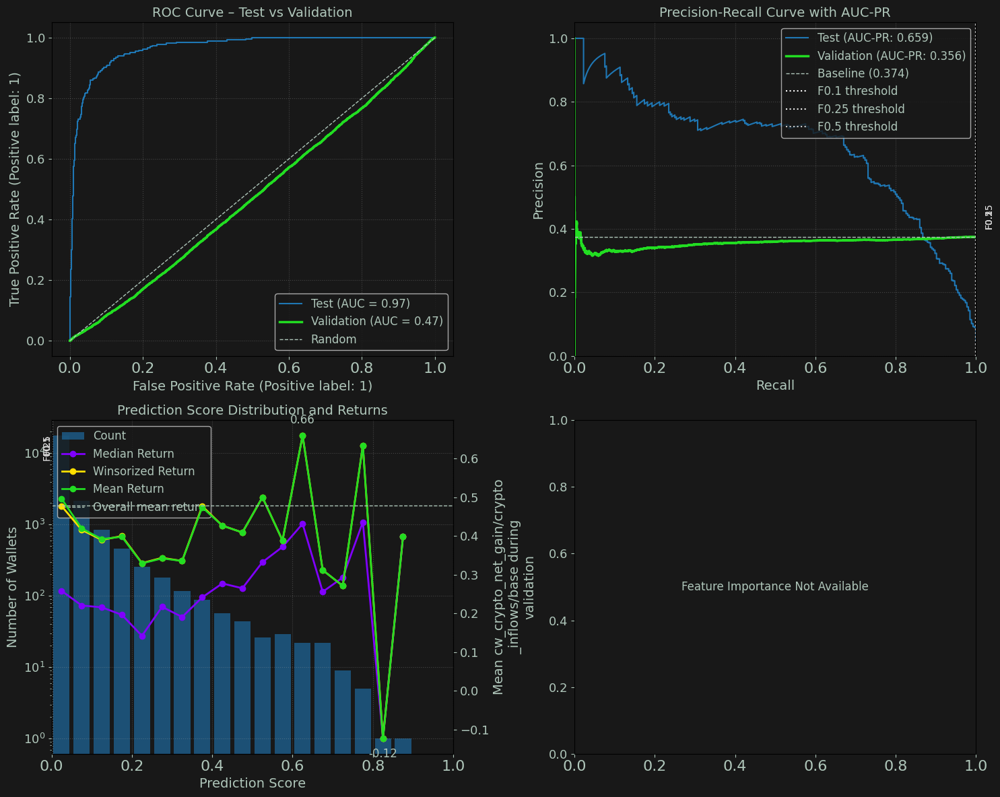

[12/Aug/25 13:46:20] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:20] WARNING [176173847.<module>:6]                 -60: 2024-02-05
[12/Aug/25 13:46:20] INFO [176173847.<module>:7] -------------------------------------------------
[12/Aug/25 13:46:20] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-60/ws-dda-957--sh-60-0812-131122/output/model.tar.gz
Test Samples:             8,800
Val Positive Samples:     5,393 (7.9%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.559  |  0.954
Val Accuracy:               0.794  |  0.896
Val Precision:              0.110  |  0.651
Val Recall:                 0.225  |  0.888
Val F1 Score:               0.148  |  0.751

Validation Retur

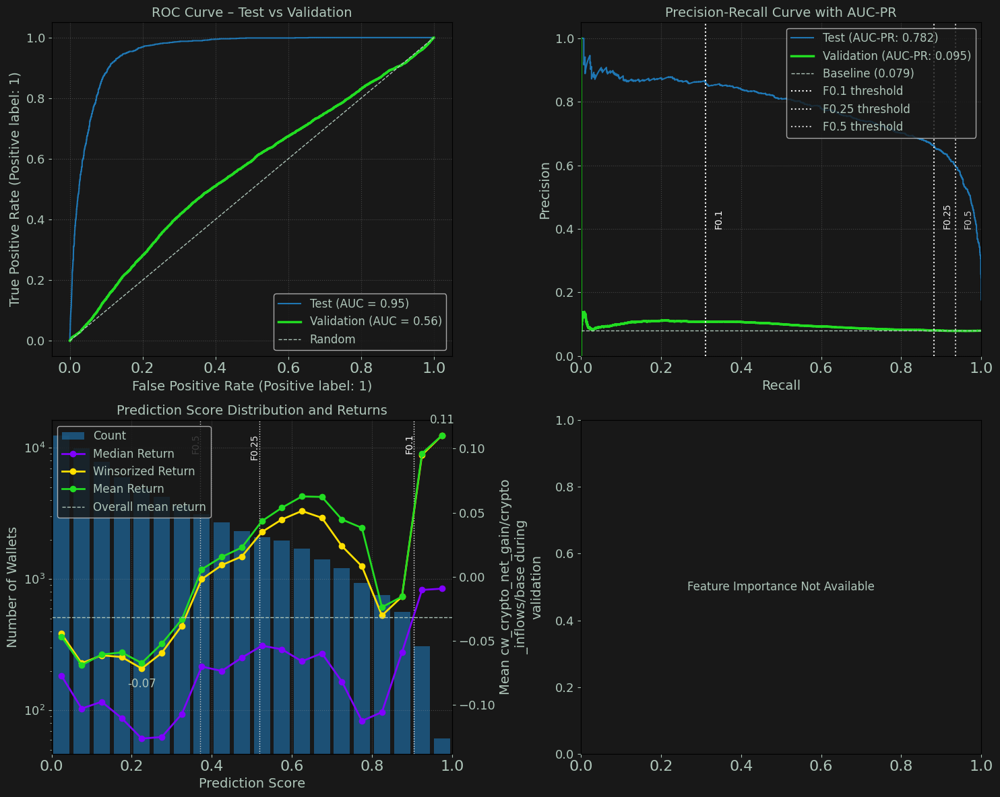

[12/Aug/25 13:46:21] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:21] WARNING [176173847.<module>:6]                 0: 2024-04-05
[12/Aug/25 13:46:21] INFO [176173847.<module>:7] -------------------------------------------------
[12/Aug/25 13:46:21] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh0/ws-dda-957--sh0-0812-131122/output/model.tar.gz
Test Samples:             13,215
Val Positive Samples:     172 (0.6%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.503  |  0.969
Val Accuracy:               0.991  |  0.932
Val Precision:              0.000  |  0.668
Val Recall:                 0.000  |  0.857
Val F1 Score:               0.000  |  0.750

Validation Returns    |

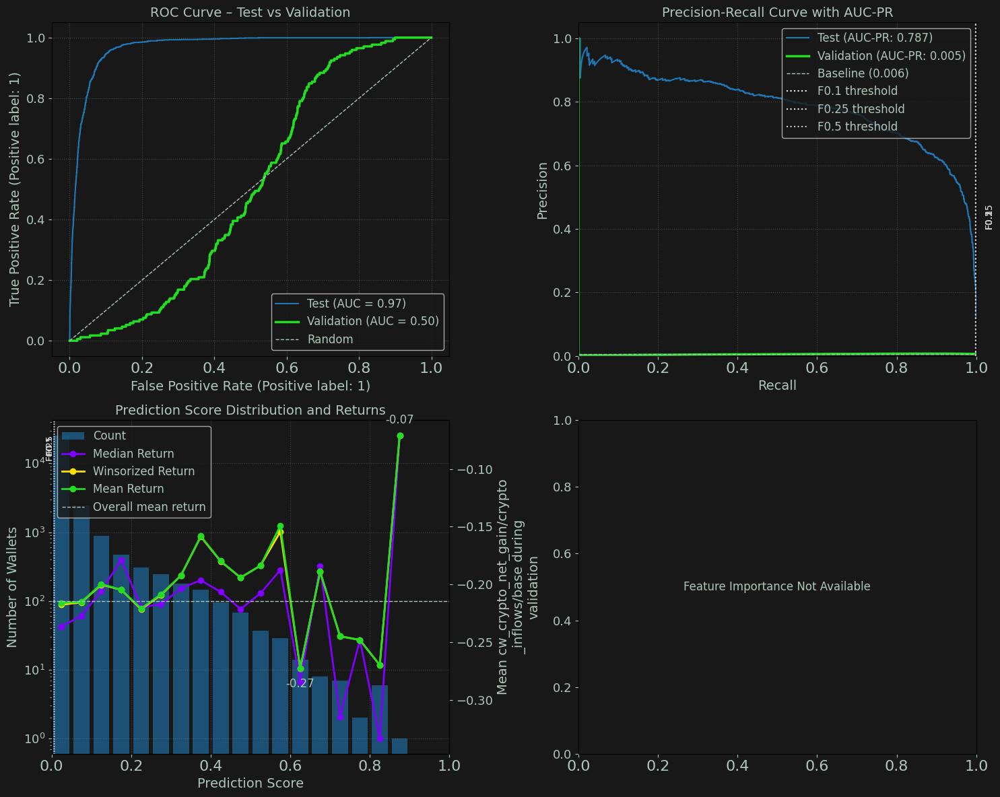

[12/Aug/25 13:46:21] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:21] WARNING [176173847.<module>:6]                 120: 2024-08-03
[12/Aug/25 13:46:21] INFO [176173847.<module>:7] -------------------------------------------------
[12/Aug/25 13:46:21] WARNING [176173847.<module>:9] All rows filtered out
[12/Aug/25 13:46:21] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:21] WARNING [176173847.<module>:6]                 180: 2024-10-02
[12/Aug/25 13:46:21] INFO [176173847.<module>:7] -------------------------------------------------
[12/Aug/25 13:46:21] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh180/ws-dda-957--sh180-0812-131122/output/model.tar.gz
Test Samples:             24,175
Val Positive Samples:     2,401 (6.0%

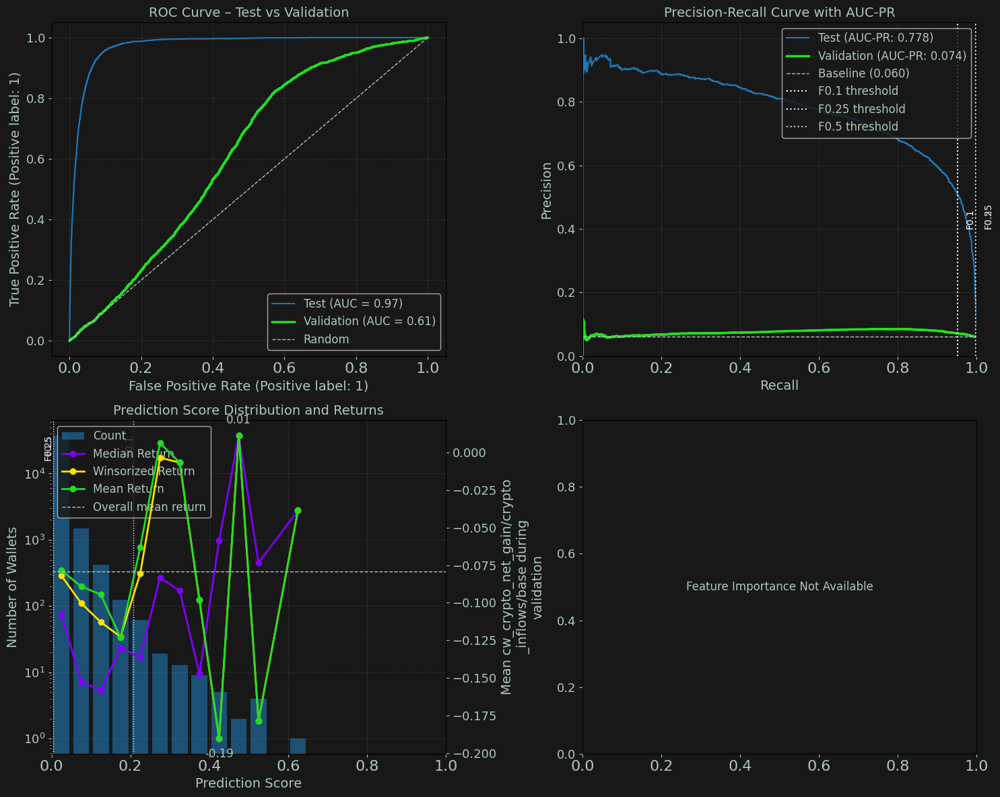

[12/Aug/25 13:46:22] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:22] WARNING [176173847.<module>:6]                 240: 2024-12-01
[12/Aug/25 13:46:22] INFO [176173847.<module>:7] -------------------------------------------------
[12/Aug/25 13:46:22] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh240/ws-dda-957--sh240-0812-131454/output/model.tar.gz
Test Samples:             24,121
Val Positive Samples:     1,555 (2.4%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.537  |  0.975
Val Accuracy:               0.972  |  0.965
Val Precision:              0.012  |  0.642
Val Recall:                 0.003  |  0.775
Val F1 Score:               0.004  |  0.702

Validation Retu

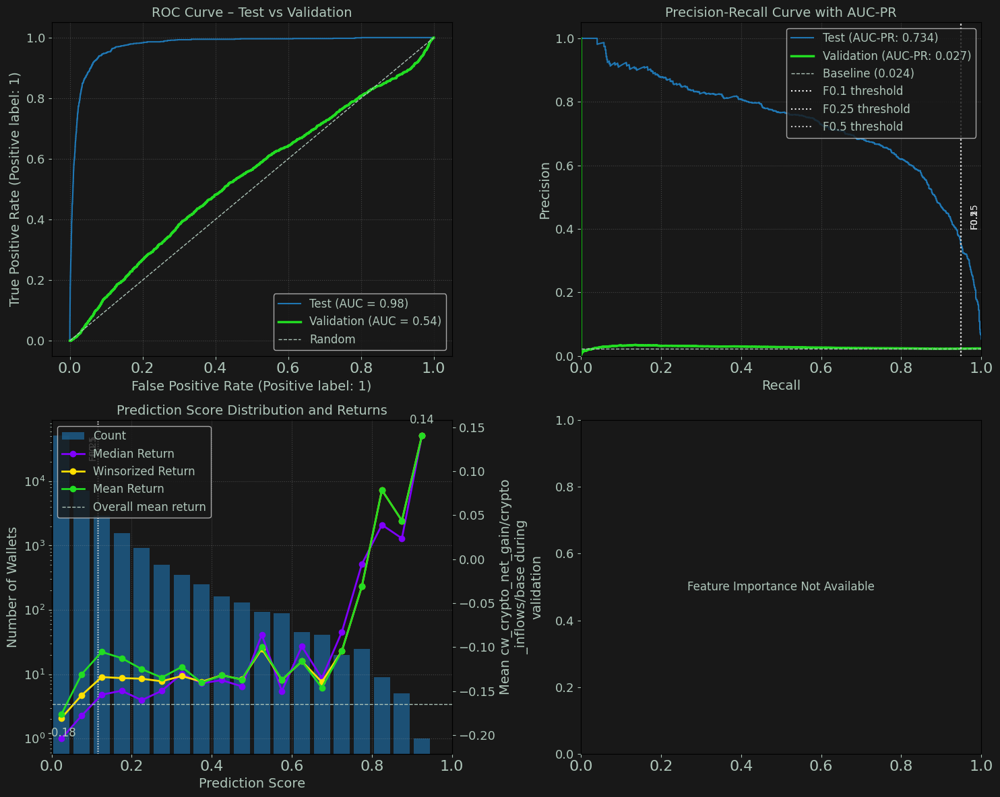

[12/Aug/25 13:46:22] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:22] WARNING [176173847.<module>:6]                 300: 2025-01-30
[12/Aug/25 13:46:22] INFO [176173847.<module>:7] -------------------------------------------------
[12/Aug/25 13:46:22] WARNING [176173847.<module>:9] All rows filtered out
[12/Aug/25 13:46:22] INFO [176173847.<module>:5] -------------------------------------------------
[12/Aug/25 13:46:22] WARNING [176173847.<module>:6]                 360: 2025-03-31
[12/Aug/25 13:46:22] INFO [176173847.<module>:7] -------------------------------------------------
[12/Aug/25 13:46:22] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh360/ws-dda-957--sh360-0812-131517/output/model.tar.gz
Test Samples:             17,120
Val Positive Samples:     349 (2.4%)


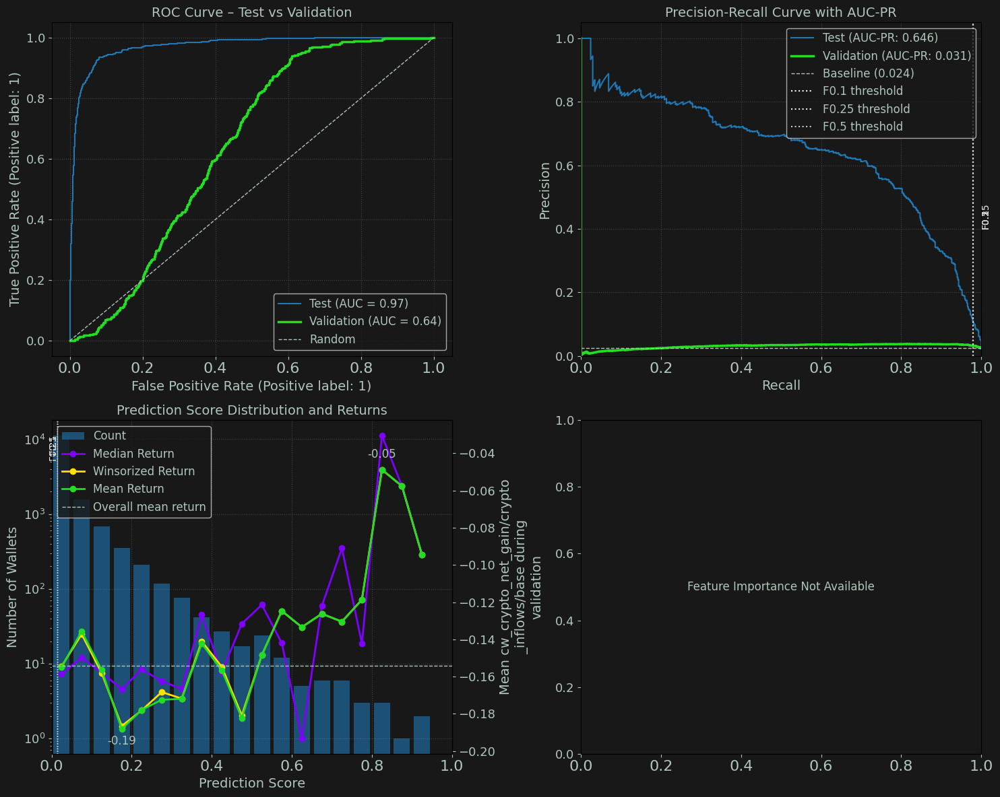

In [9]:
# prod rerun w index save working add back overlap
for e in evaluators:
    # evaluators[e].summary_report()
    date = (pd.to_datetime('2024-04-05') + timedelta(days=e)).strftime('%Y-%m-%d')
    logger.info('-------------------------------------------------')
    logger.warning(f'                {e}: {date}')
    logger.info('-------------------------------------------------')
    if evaluators[e] is None:
        logger.warning("All rows filtered out")
        continue
    evaluators[e].summary_report()
    evaluators[e].plot_wallet_evaluation()


[12/Aug/25 00:49:28] INFO [1297509504.<module>:5] -------------------------------------------------
[12/Aug/25 00:49:28] WARNING [1297509504.<module>:6]                 -120: 2023-12-07
[12/Aug/25 00:49:28] INFO [1297509504.<module>:7] -------------------------------------------------
[12/Aug/25 00:49:28] WARNING [1297509504.<module>:9] All rows filtered out
[12/Aug/25 00:49:28] INFO [1297509504.<module>:5] -------------------------------------------------
[12/Aug/25 00:49:28] WARNING [1297509504.<module>:6]                 -60: 2024-02-05
[12/Aug/25 00:49:28] INFO [1297509504.<module>:7] -------------------------------------------------
[12/Aug/25 00:49:28] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh-60/wscr-dda-957--sh-60-0812-002828/output/model.tar.gz
Test Samples:             9,385
Val Positive Samples:     9,

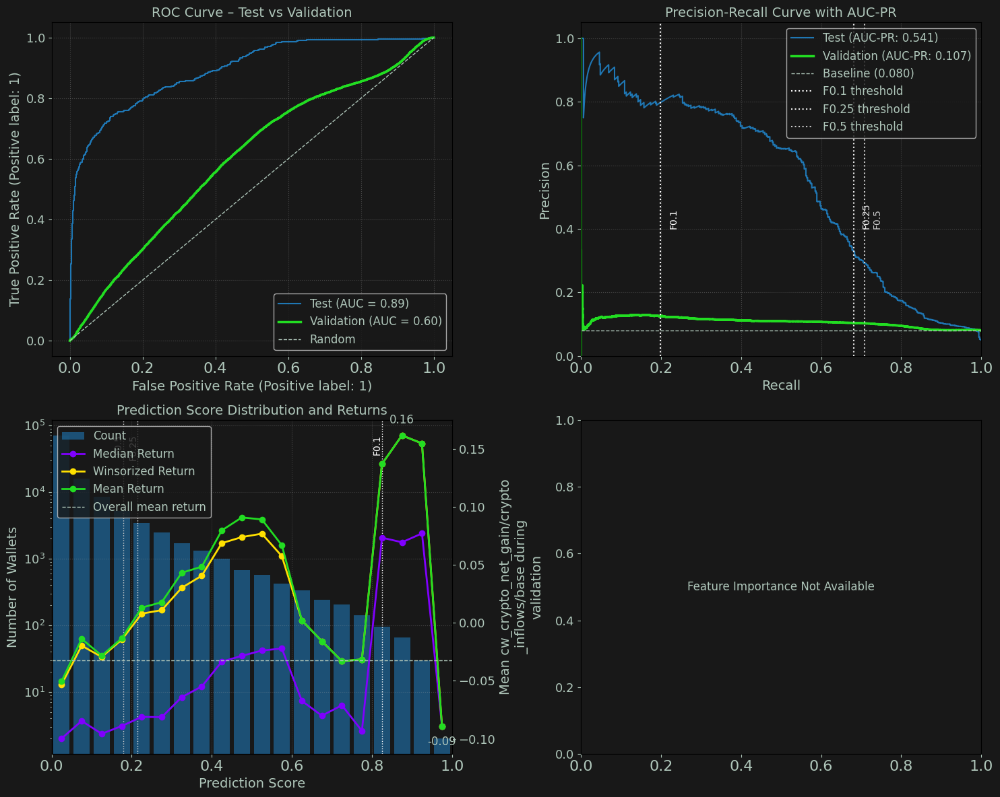

[12/Aug/25 00:49:29] INFO [1297509504.<module>:5] -------------------------------------------------
[12/Aug/25 00:49:29] WARNING [1297509504.<module>:6]                 0: 2024-04-05
[12/Aug/25 00:49:29] INFO [1297509504.<module>:7] -------------------------------------------------
[12/Aug/25 00:49:29] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh0/wscr-dda-957--sh0-0812-002828/output/model.tar.gz
Test Samples:             26,421
Val Positive Samples:     2,408 (2.5%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.493  |  0.633
Val Accuracy:               0.974  |  0.933
Val Precision:              0.000  |  0.575
Val Recall:                 0.000  |  0.166
Val F1 Score:               0.000  |  0.257

Validation Retur

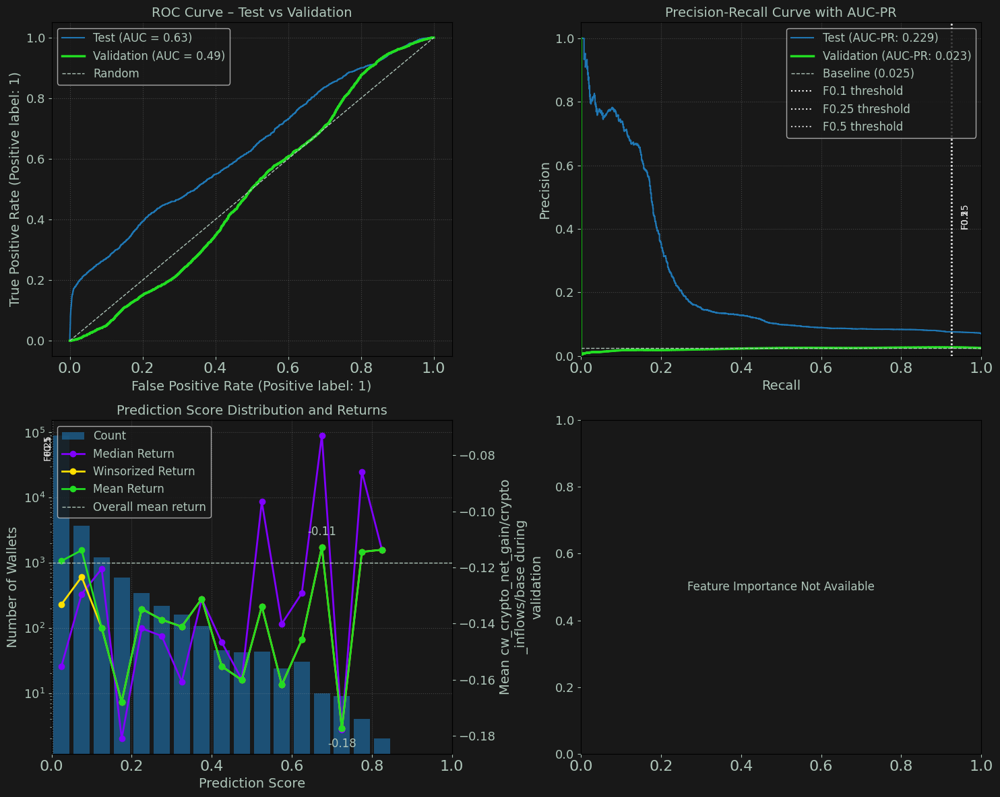

[12/Aug/25 00:49:30] INFO [1297509504.<module>:5] -------------------------------------------------
[12/Aug/25 00:49:30] WARNING [1297509504.<module>:6]                 120: 2024-08-03
[12/Aug/25 00:49:30] INFO [1297509504.<module>:7] -------------------------------------------------
[12/Aug/25 00:49:30] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh120/wscr-dda-957--sh120-0812-002828/output/model.tar.gz
Test Samples:             53,598
Val Positive Samples:     4,921 (10.4%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.563  |  0.667
Val Accuracy:               0.896  |  0.953
Val Precision:              0.000  |  0.592
Val Recall:                 0.000  |  0.151
Val F1 Score:               0.000  |  0.241

Validatio

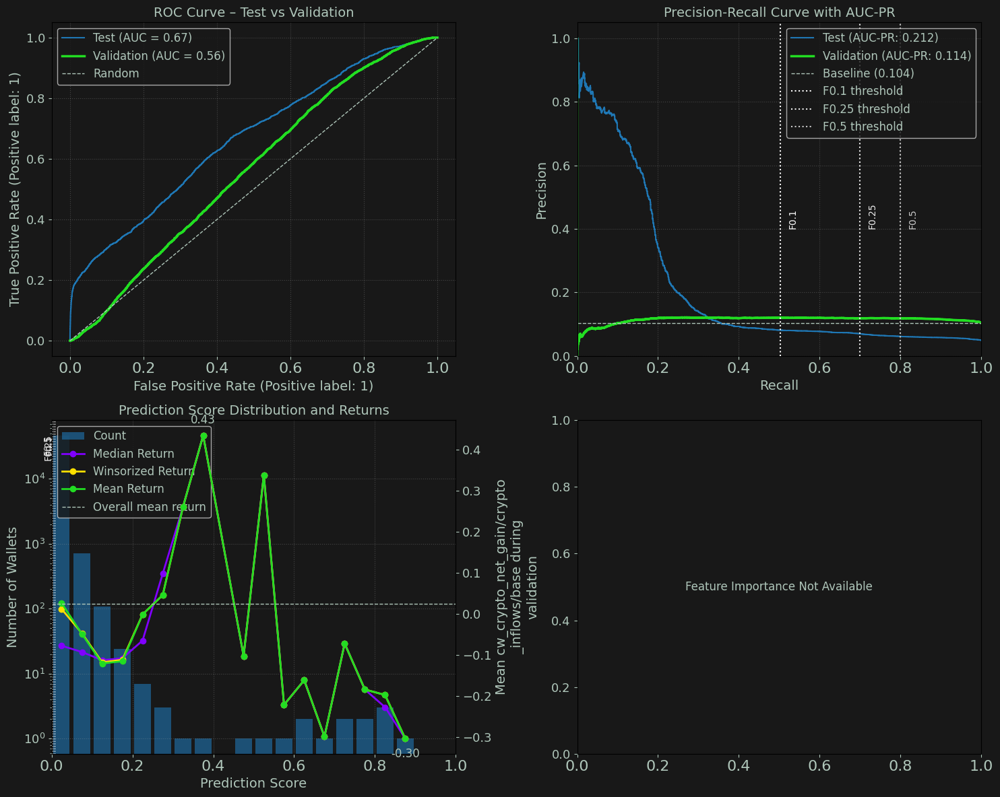

[12/Aug/25 00:49:30] INFO [1297509504.<module>:5] -------------------------------------------------
[12/Aug/25 00:49:30] WARNING [1297509504.<module>:6]                 180: 2024-10-02
[12/Aug/25 00:49:30] INFO [1297509504.<module>:7] -------------------------------------------------
[12/Aug/25 00:49:30] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh180/wscr-dda-957--sh180-0812-002828/output/model.tar.gz
Test Samples:             51,319
Val Positive Samples:     23,762 (18.8%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.448  |  0.789
Val Accuracy:               0.814  |  0.950
Val Precision:              0.652  |  0.614
Val Recall:                 0.022  |  0.279
Val F1 Score:               0.042  |  0.383

Validati

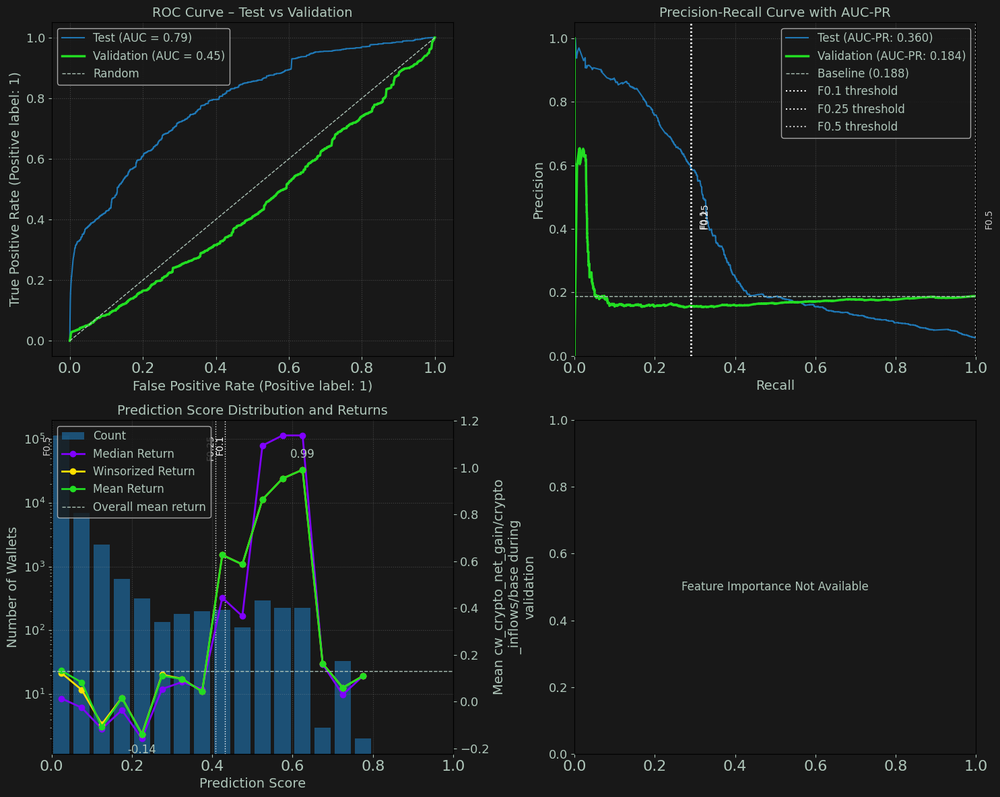

[12/Aug/25 00:49:31] INFO [1297509504.<module>:5] -------------------------------------------------
[12/Aug/25 00:49:31] WARNING [1297509504.<module>:6]                 240: 2024-12-01
[12/Aug/25 00:49:31] INFO [1297509504.<module>:7] -------------------------------------------------
[12/Aug/25 00:49:31] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh240/wscr-dda-957--sh240-0812-002828/output/model.tar.gz
Test Samples:             61,812
Val Positive Samples:     2,901 (2.6%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.548  |  0.690
Val Accuracy:               0.970  |  0.925
Val Precision:              0.011  |  0.626
Val Recall:                 0.002  |  0.254
Val F1 Score:               0.003  |  0.362

Validation

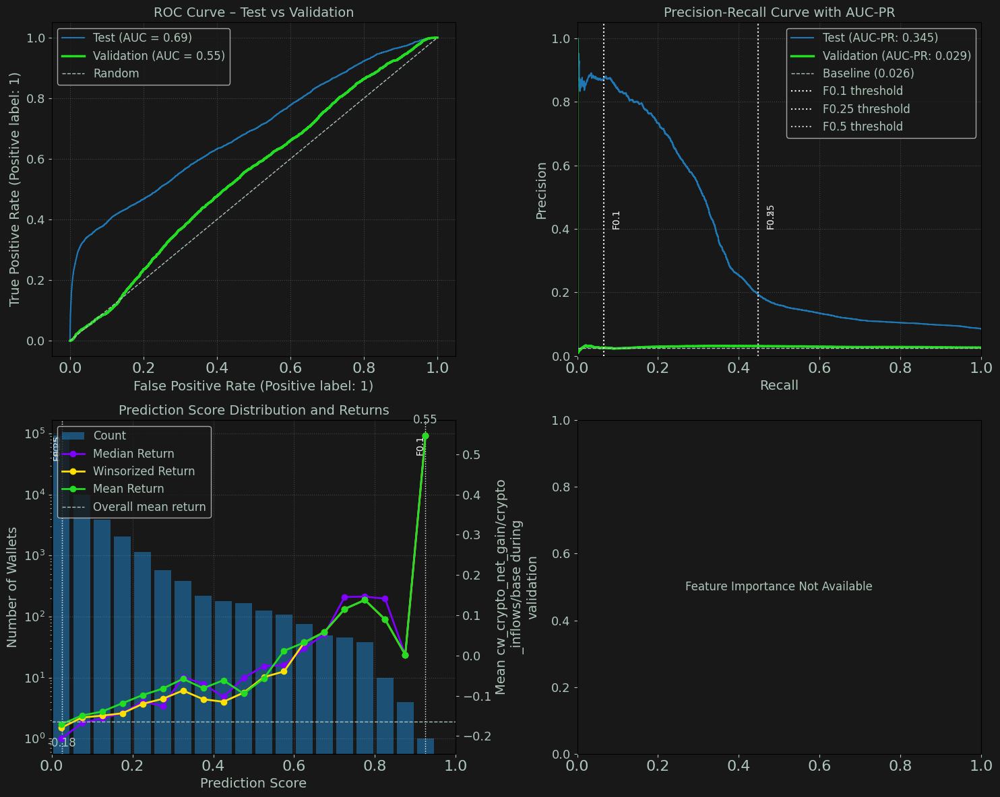

[12/Aug/25 00:49:32] INFO [1297509504.<module>:5] -------------------------------------------------
[12/Aug/25 00:49:32] WARNING [1297509504.<module>:6]                 300: 2025-01-30
[12/Aug/25 00:49:32] INFO [1297509504.<module>:7] -------------------------------------------------
[12/Aug/25 00:49:32] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh300/wscr-dda-957--sh300-0812-002904/output/model.tar.gz
Test Samples:             63,157
Val Positive Samples:     2,455 (4.6%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.510  |  0.633
Val Accuracy:               0.951  |  0.927
Val Precision:              0.000  |  0.616
Val Recall:                 0.000  |  0.255
Val F1 Score:               0.000  |  0.360

Validation

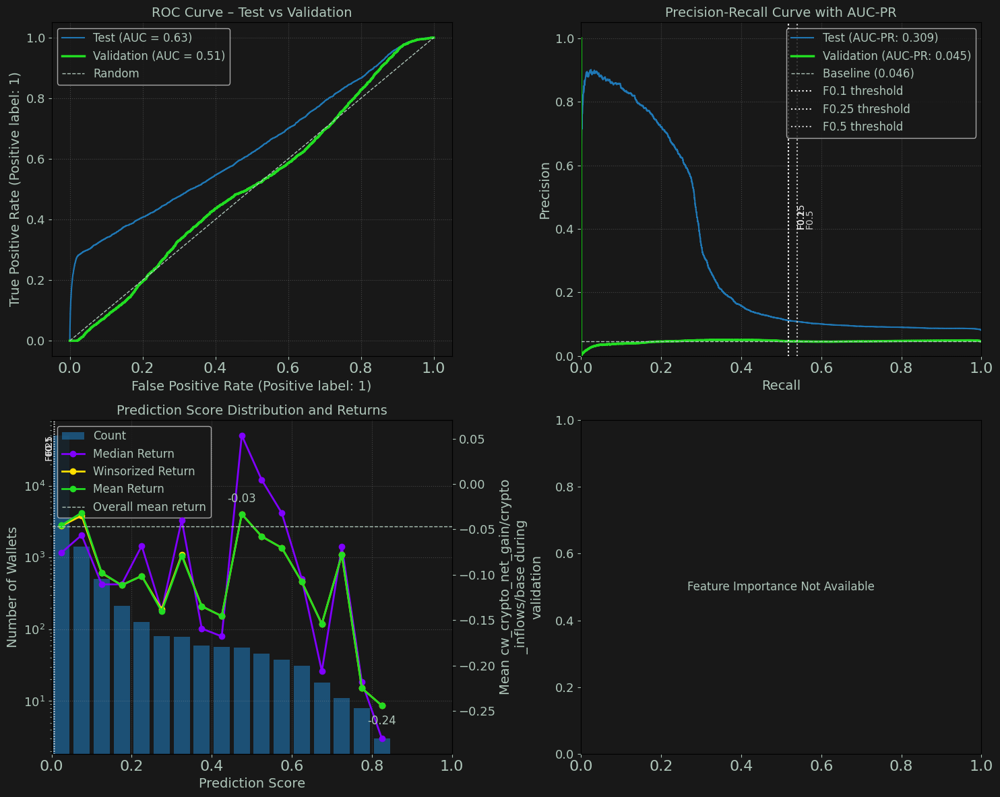

[12/Aug/25 00:49:33] INFO [1297509504.<module>:5] -------------------------------------------------
[12/Aug/25 00:49:33] WARNING [1297509504.<module>:6]                 360: 2025-03-31
[12/Aug/25 00:49:33] INFO [1297509504.<module>:7] -------------------------------------------------
[12/Aug/25 00:49:33] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-957-coin-model/sh360/wscr-dda-957--sh360-0812-002828/output/model.tar.gz
Test Samples:             56,595
Val Positive Samples:     4,177 (8.0%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.503  |  0.690
Val Accuracy:               0.918  |  0.917
Val Precision:              0.016  |  0.606
Val Recall:                 0.000  |  0.285
Val F1 Score:               0.001  |  0.387

Validation

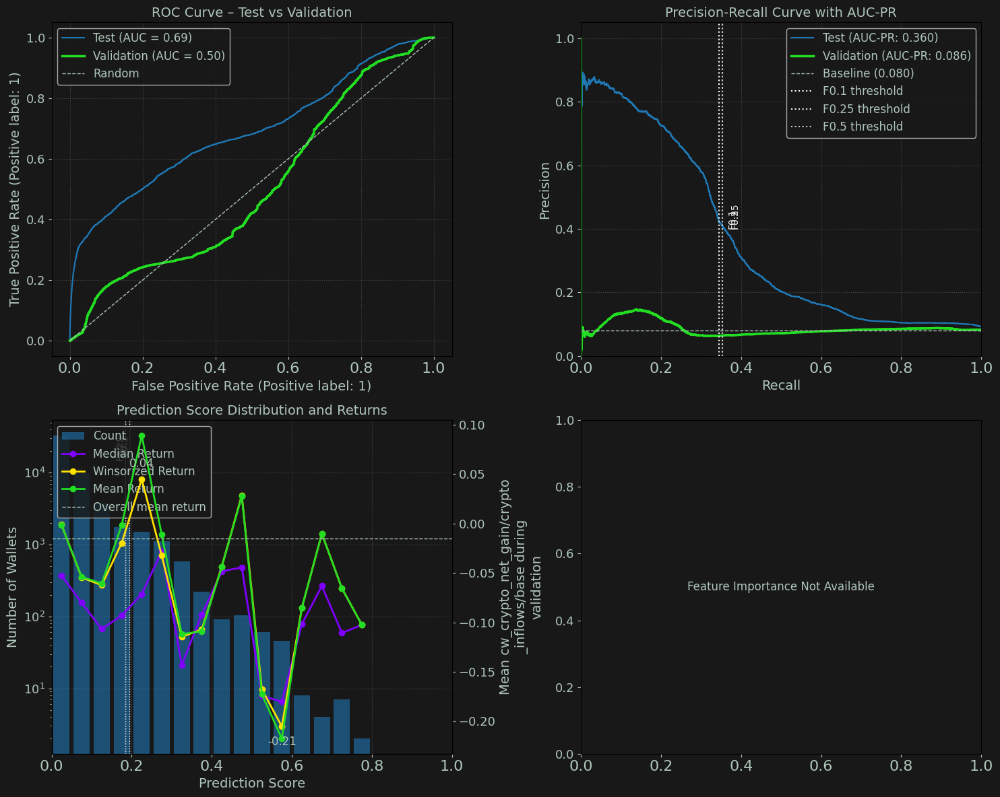

In [16]:
# prod rerun w index save working
for e in evaluators:
    # evaluators[e].summary_report()
    date = (pd.to_datetime('2024-04-05') + timedelta(days=e)).strftime('%Y-%m-%d')
    logger.info('-------------------------------------------------')
    logger.warning(f'                {e}: {date}')
    logger.info('-------------------------------------------------')
    if evaluators[e] is None:
        logger.warning("All rows filtered out")
        continue
    evaluators[e].summary_report()
    evaluators[e].plot_wallet_evaluation()


[11/Aug/25 17:44:17] INFO [1211033011.<module>:5] -------------------------------------------------
[11/Aug/25 17:44:17] WARNING [1211033011.<module>:6]                 -120: 2023-12-07
[11/Aug/25 17:44:17] INFO [1211033011.<module>:7] -------------------------------------------------
[11/Aug/25 17:44:17] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh-120/wscr-dda-951--sh-120-0811-144158/output/model.tar.gz
Test Samples:             4,732
Val Positive Samples:     1,157 (3.7%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.579  |  0.970
Val Accuracy:               0.952  |  0.961
Val Precision:              0.017  |  0.686
Val Recall:                 0.005  |  0.781
Val F1 Score:               0.008  |  0.730

Validat

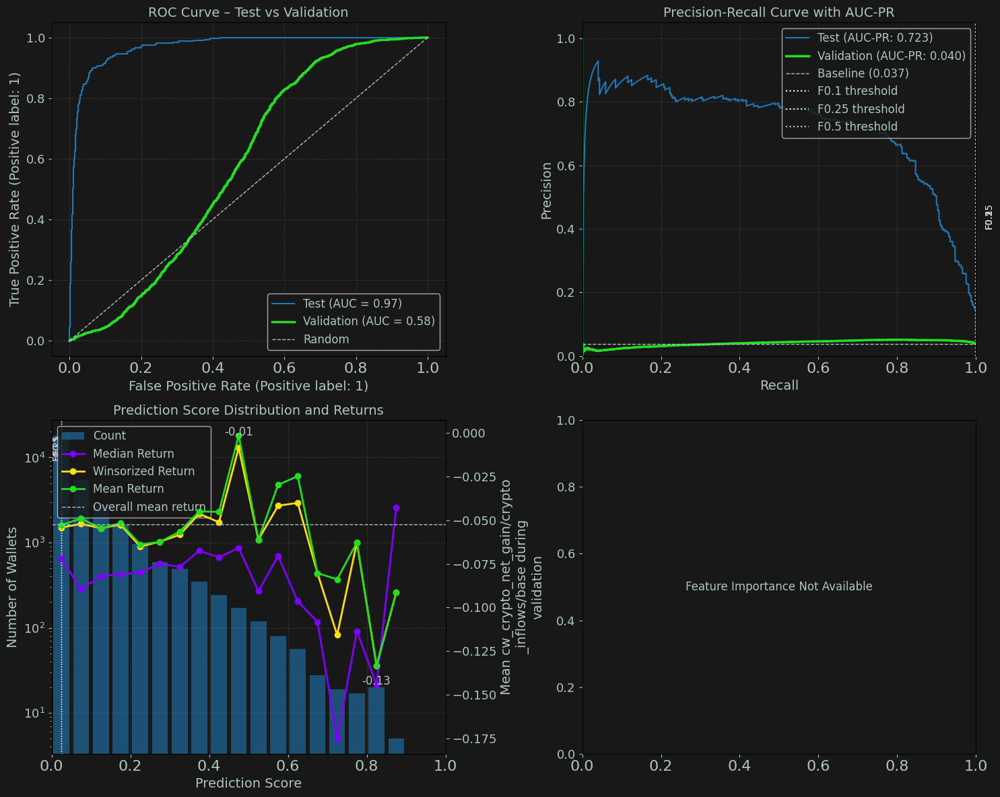

[11/Aug/25 17:44:18] INFO [1211033011.<module>:5] -------------------------------------------------
[11/Aug/25 17:44:18] WARNING [1211033011.<module>:6]                 -60: 2024-02-05
[11/Aug/25 17:44:18] INFO [1211033011.<module>:7] -------------------------------------------------
[11/Aug/25 17:44:18] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh-60/wscr-dda-951--sh-60-0811-144158/output/model.tar.gz
Test Samples:             9,385
Val Positive Samples:     9,102 (8.0%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.597  |  0.892
Val Accuracy:               0.905  |  0.960
Val Precision:              0.106  |  0.625
Val Recall:                 0.025  |  0.541
Val F1 Score:               0.040  |  0.580

Validation

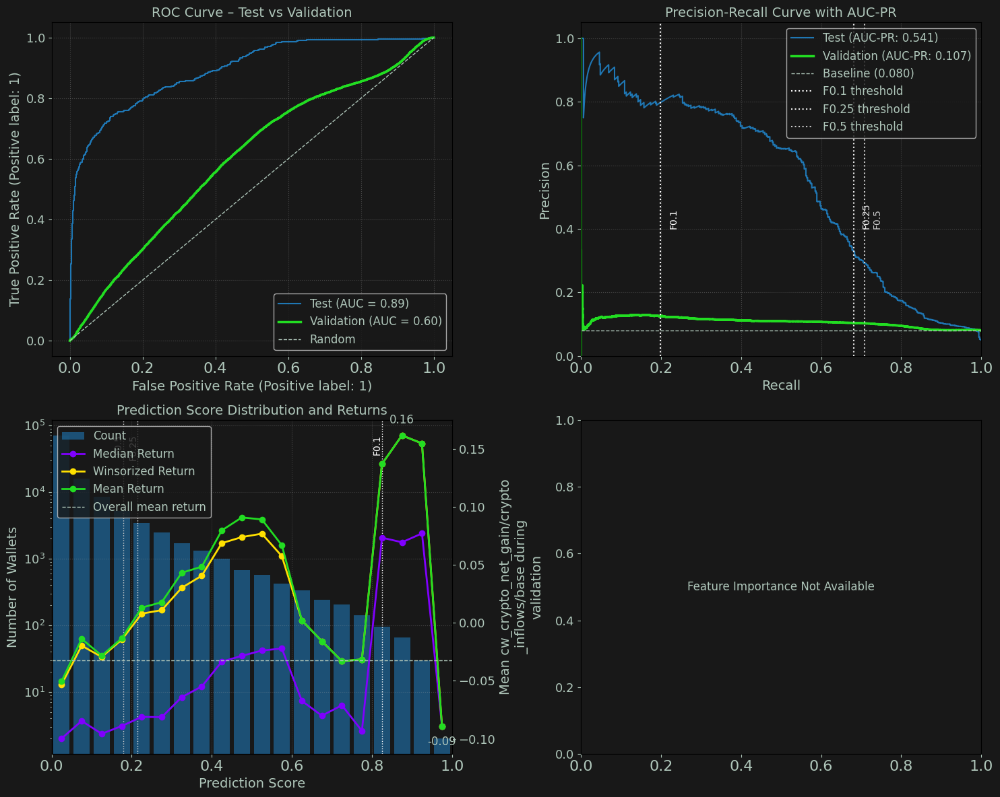

[11/Aug/25 17:44:18] INFO [1211033011.<module>:5] -------------------------------------------------
[11/Aug/25 17:44:18] WARNING [1211033011.<module>:6]                 0: 2024-04-05
[11/Aug/25 17:44:18] INFO [1211033011.<module>:7] -------------------------------------------------
[11/Aug/25 17:44:18] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh0/wscr-dda-951--sh0-0811-144158/output/model.tar.gz
Test Samples:             26,421
Val Positive Samples:     2,408 (2.5%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.493  |  0.633
Val Accuracy:               0.974  |  0.933
Val Precision:              0.000  |  0.575
Val Recall:                 0.000  |  0.166
Val F1 Score:               0.000  |  0.257

Validation Retu

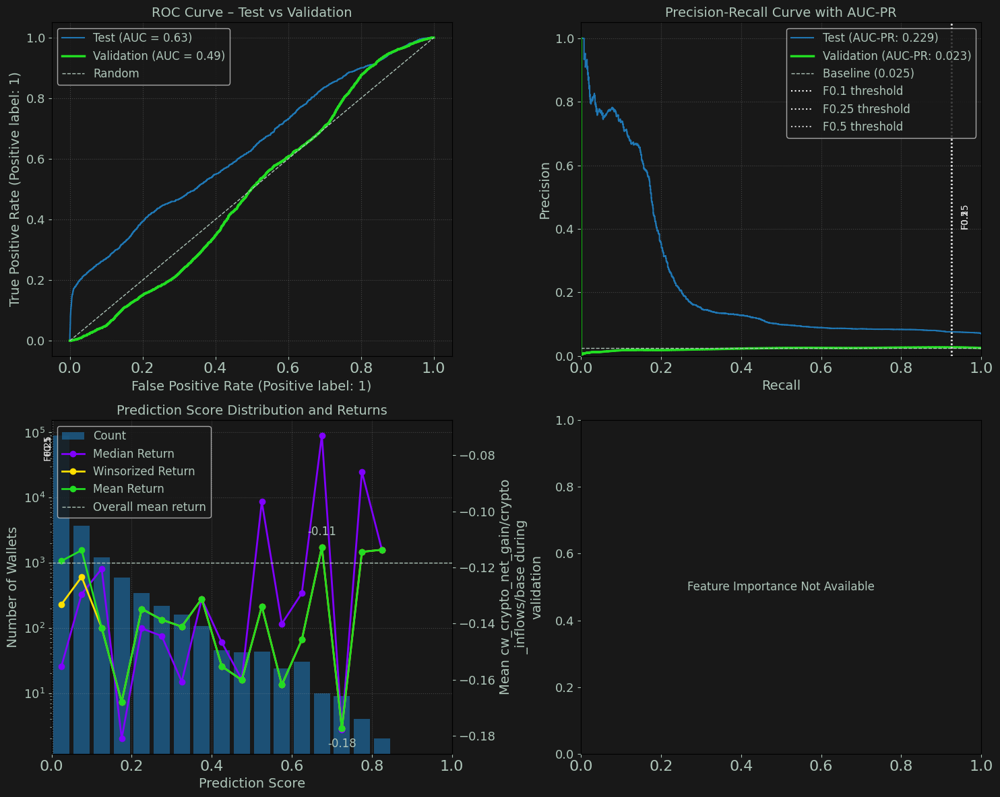

[11/Aug/25 17:44:19] INFO [1211033011.<module>:5] -------------------------------------------------
[11/Aug/25 17:44:19] WARNING [1211033011.<module>:6]                 120: 2024-08-03
[11/Aug/25 17:44:19] INFO [1211033011.<module>:7] -------------------------------------------------
[11/Aug/25 17:44:19] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh120/wscr-dda-951--sh120-0811-144158/output/model.tar.gz
Test Samples:             53,598
Val Positive Samples:     4,921 (10.4%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.563  |  0.667
Val Accuracy:               0.896  |  0.953
Val Precision:              0.000  |  0.592
Val Recall:                 0.000  |  0.151
Val F1 Score:               0.000  |  0.241

Validati

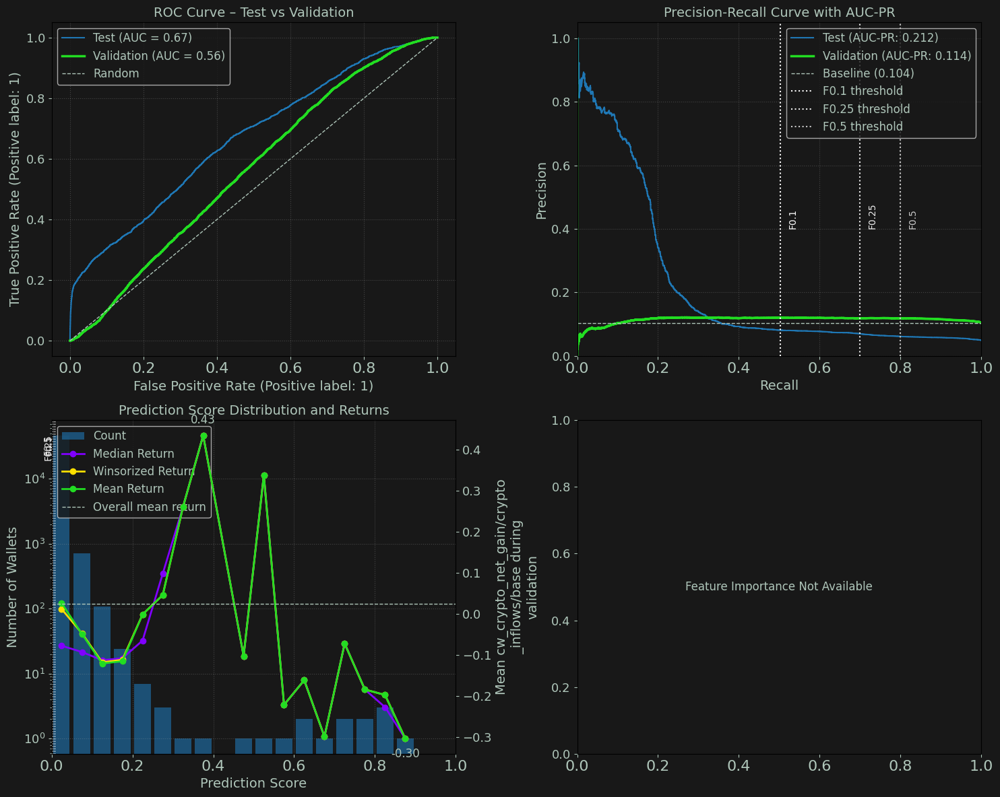

[11/Aug/25 17:44:19] INFO [1211033011.<module>:5] -------------------------------------------------
[11/Aug/25 17:44:19] WARNING [1211033011.<module>:6]                 180: 2024-10-02
[11/Aug/25 17:44:19] INFO [1211033011.<module>:7] -------------------------------------------------
[11/Aug/25 17:44:19] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh180/wscr-dda-951--sh180-0811-144158/output/model.tar.gz
Test Samples:             51,319
Val Positive Samples:     23,762 (18.8%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.448  |  0.789
Val Accuracy:               0.814  |  0.950
Val Precision:              0.652  |  0.614
Val Recall:                 0.022  |  0.279
Val F1 Score:               0.042  |  0.383

Validat

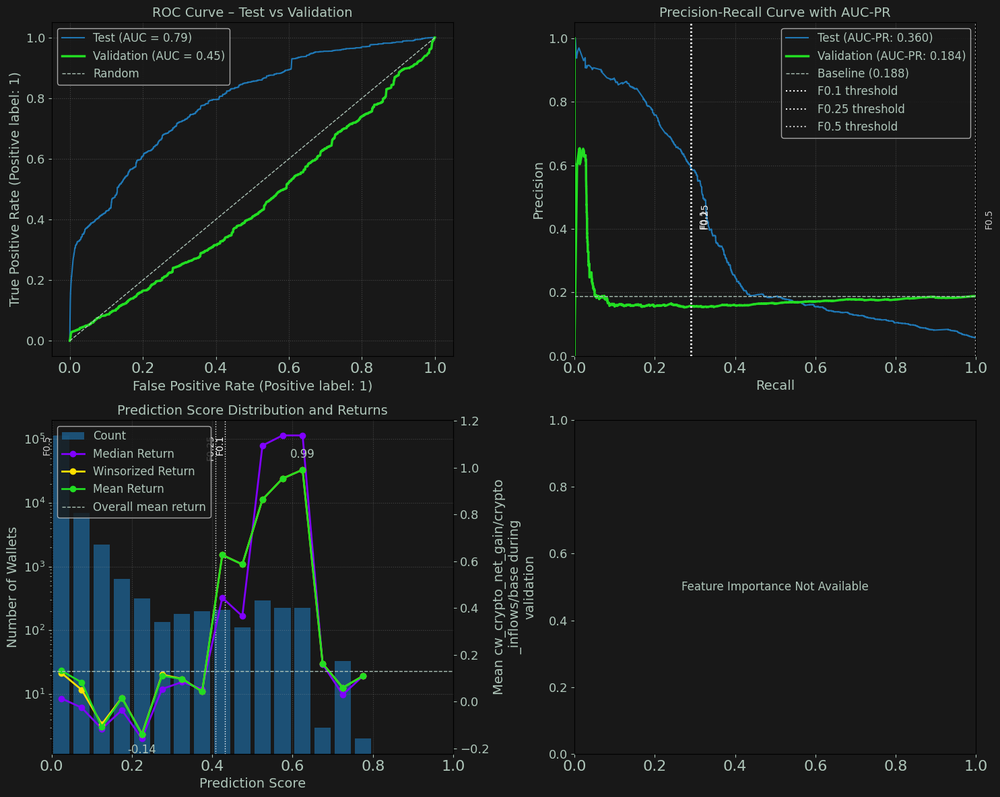

[11/Aug/25 17:44:20] INFO [1211033011.<module>:5] -------------------------------------------------
[11/Aug/25 17:44:20] WARNING [1211033011.<module>:6]                 240: 2024-12-01
[11/Aug/25 17:44:20] INFO [1211033011.<module>:7] -------------------------------------------------
[11/Aug/25 17:44:20] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh240/wscr-dda-951--sh240-0811-144158/output/model.tar.gz
Test Samples:             61,812
Val Positive Samples:     2,901 (2.6%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.548  |  0.690
Val Accuracy:               0.970  |  0.925
Val Precision:              0.011  |  0.626
Val Recall:                 0.002  |  0.254
Val F1 Score:               0.003  |  0.362

Validatio

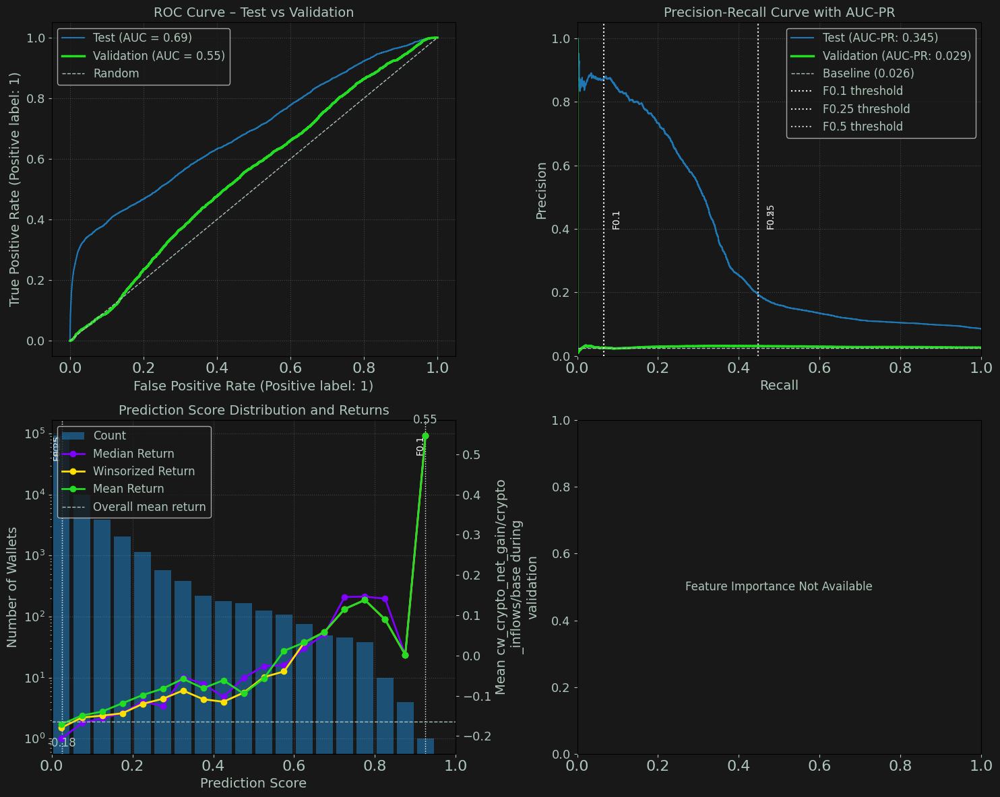

[11/Aug/25 17:44:20] INFO [1211033011.<module>:5] -------------------------------------------------
[11/Aug/25 17:44:20] WARNING [1211033011.<module>:6]                 300: 2025-01-30
[11/Aug/25 17:44:20] INFO [1211033011.<module>:7] -------------------------------------------------
[11/Aug/25 17:44:20] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh300/wscr-dda-951--sh300-0811-144158/output/model.tar.gz
Test Samples:             63,157
Val Positive Samples:     2,455 (4.6%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.510  |  0.633
Val Accuracy:               0.951  |  0.927
Val Precision:              0.000  |  0.616
Val Recall:                 0.000  |  0.255
Val F1 Score:               0.000  |  0.360

Validatio

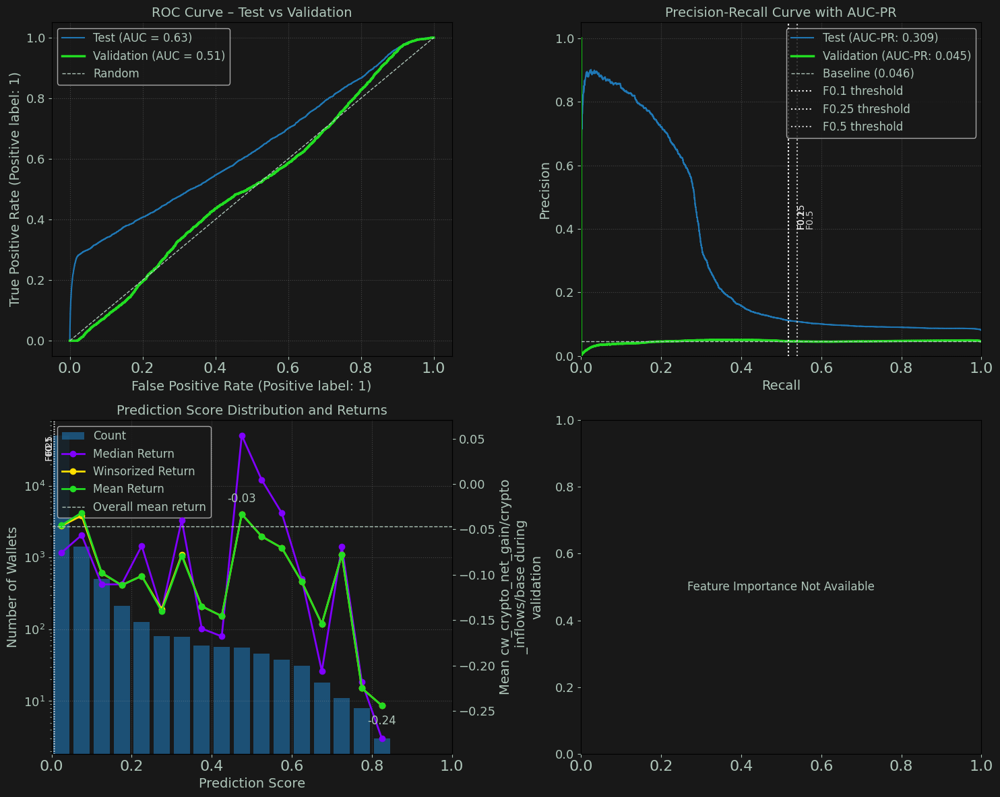

[11/Aug/25 17:44:21] INFO [1211033011.<module>:5] -------------------------------------------------
[11/Aug/25 17:44:21] WARNING [1211033011.<module>:6]                 360: 2025-03-31
[11/Aug/25 17:44:21] INFO [1211033011.<module>:7] -------------------------------------------------
[11/Aug/25 17:44:21] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh360/wscr-dda-951--sh360-0811-144158/output/model.tar.gz
Test Samples:             56,595
Val Positive Samples:     4,177 (8.0%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.503  |  0.690
Val Accuracy:               0.918  |  0.917
Val Precision:              0.016  |  0.606
Val Recall:                 0.000  |  0.285
Val F1 Score:               0.001  |  0.387

Validatio

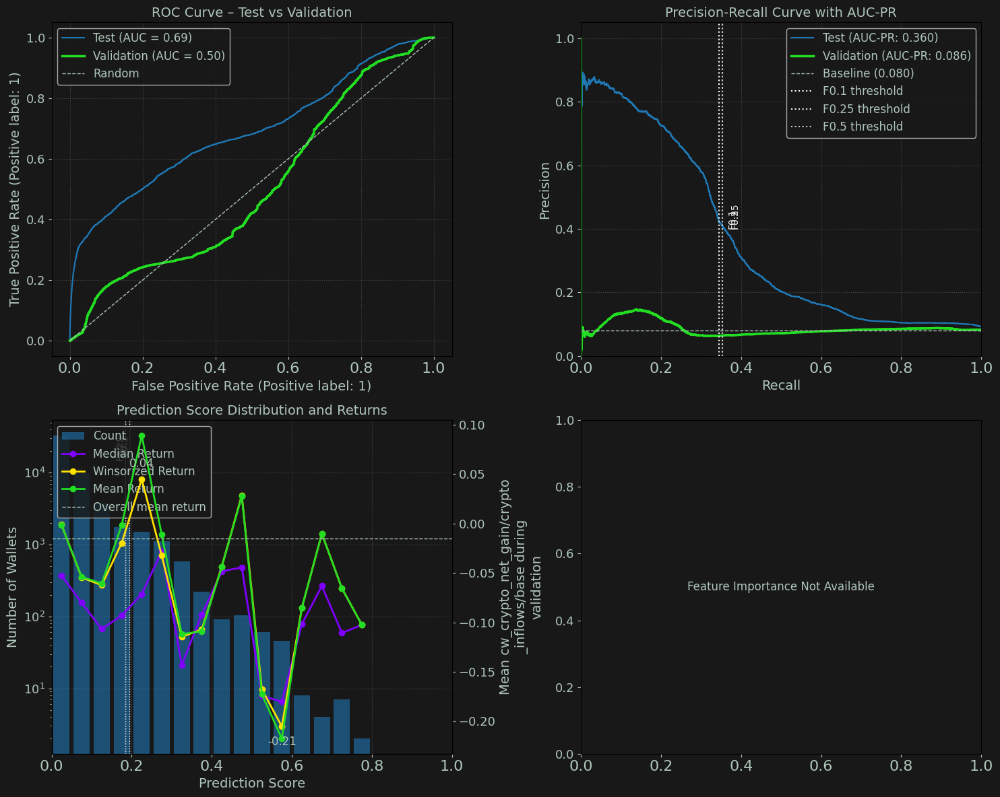

In [11]:
# copy claude chat config cw_ target rebuild
for e in evaluators:
    # evaluators[e].summary_report()
    date = (pd.to_datetime('2024-04-05') + timedelta(days=e)).strftime('%Y-%m-%d')
    logger.info('-------------------------------------------------')
    logger.warning(f'                {e}: {date}')
    logger.info('-------------------------------------------------')
    evaluators[e].summary_report()
    evaluators[e].plot_wallet_evaluation()


[11/Aug/25 13:40:11] INFO [2800625385.<module>:5] -------------------------------------------------
[11/Aug/25 13:40:11] WARNING [2800625385.<module>:6]                 -120: 2023-12-07
[11/Aug/25 13:40:11] INFO [2800625385.<module>:7] -------------------------------------------------
[11/Aug/25 13:40:11] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh-120/wscr-dda-951--sh-120-0811-131302/output/model.tar.gz
Test Samples:             4,732
Val Positive Samples:     1,157 (3.7%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.579  |  0.970
Val Accuracy:               0.952  |  0.961
Val Precision:              0.017  |  0.686
Val Recall:                 0.005  |  0.781
Val F1 Score:               0.008  |  0.730

Validat

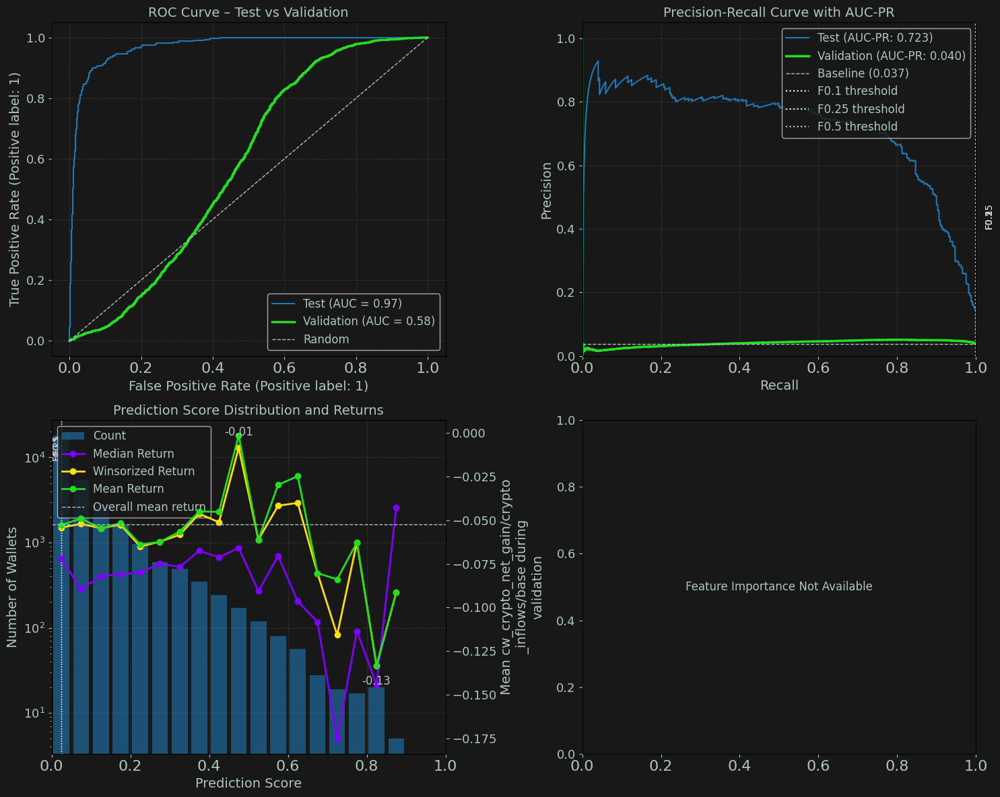

[11/Aug/25 13:40:12] INFO [2800625385.<module>:5] -------------------------------------------------
[11/Aug/25 13:40:12] WARNING [2800625385.<module>:6]                 -60: 2024-02-05
[11/Aug/25 13:40:12] INFO [2800625385.<module>:7] -------------------------------------------------
[11/Aug/25 13:40:12] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh-60/wscr-dda-951--sh-60-0811-131302/output/model.tar.gz
Test Samples:             9,385
Val Positive Samples:     9,102 (8.0%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.597  |  0.892
Val Accuracy:               0.905  |  0.960
Val Precision:              0.106  |  0.625
Val Recall:                 0.025  |  0.541
Val F1 Score:               0.040  |  0.580

Validation

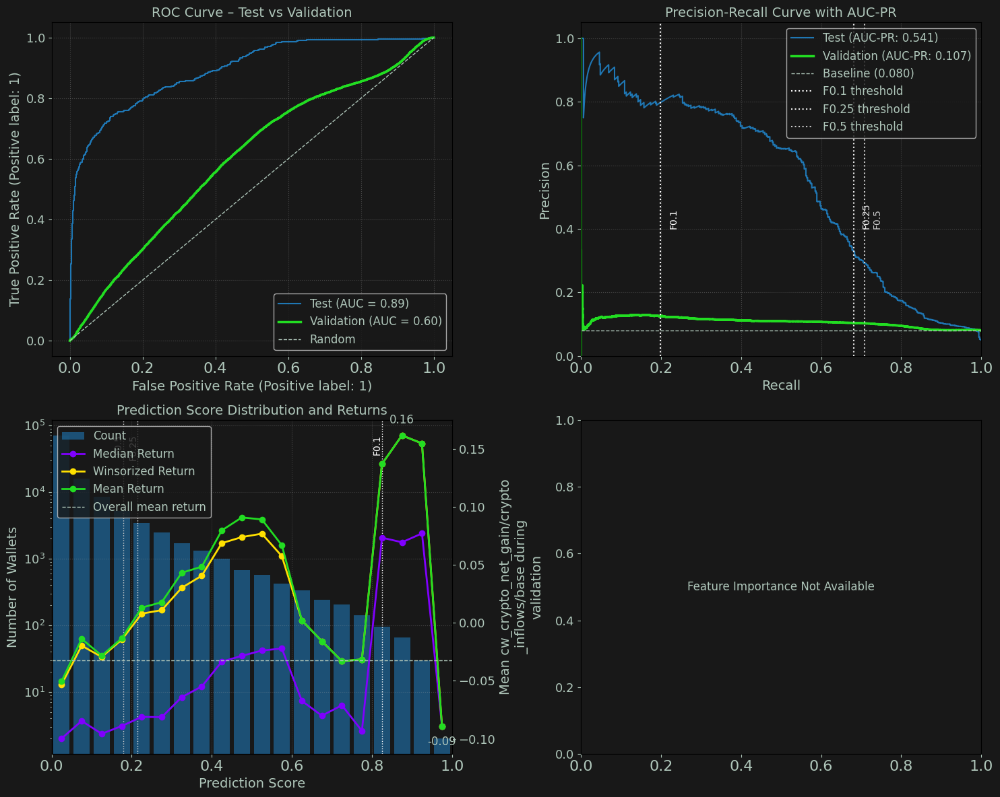

[11/Aug/25 13:40:12] INFO [2800625385.<module>:5] -------------------------------------------------
[11/Aug/25 13:40:12] WARNING [2800625385.<module>:6]                 0: 2024-04-05
[11/Aug/25 13:40:12] INFO [2800625385.<module>:7] -------------------------------------------------
[11/Aug/25 13:40:12] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh0/wscr-dda-951--sh0-0811-131301/output/model.tar.gz
Test Samples:             26,421
Val Positive Samples:     2,937 (1.9%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.604  |  0.633
Val Accuracy:               0.981  |  0.933
Val Precision:              0.459  |  0.575
Val Recall:                 0.121  |  0.166
Val F1 Score:               0.191  |  0.257

Validation Retu

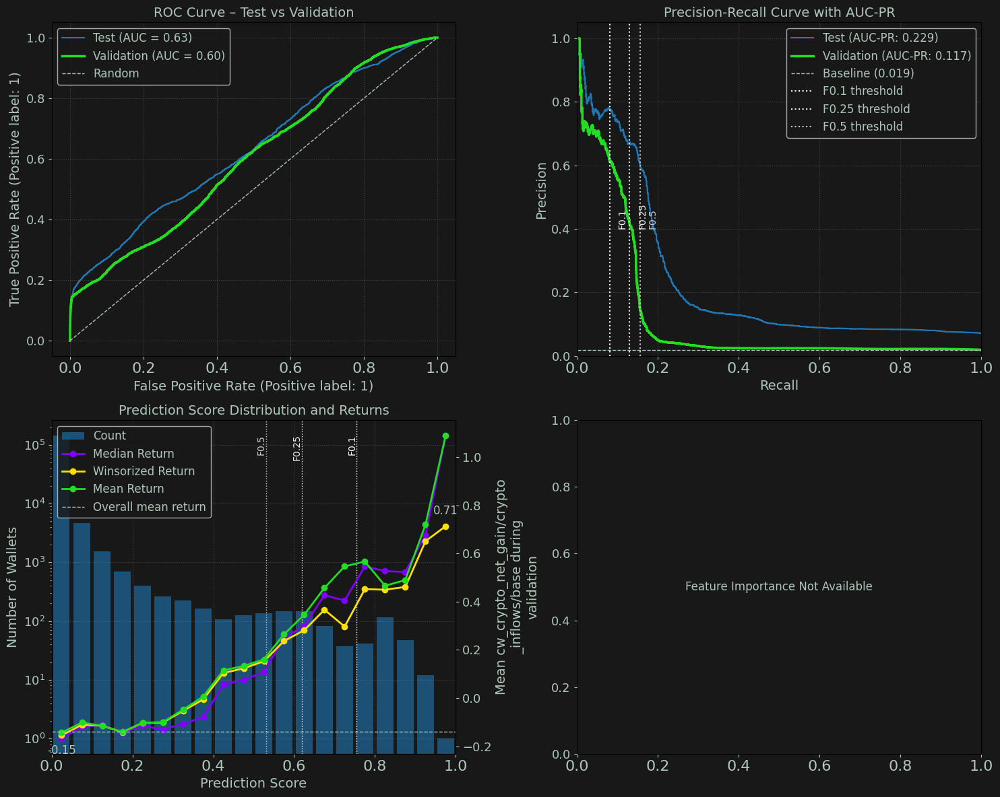

[11/Aug/25 13:40:13] INFO [2800625385.<module>:5] -------------------------------------------------
[11/Aug/25 13:40:13] WARNING [2800625385.<module>:6]                 120: 2024-08-03
[11/Aug/25 13:40:13] INFO [2800625385.<module>:7] -------------------------------------------------
[11/Aug/25 13:40:13] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh120/wscr-dda-951--sh120-0811-131301/output/model.tar.gz
Test Samples:             53,598
Val Positive Samples:     5,577 (6.5%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.638  |  0.667
Val Accuracy:               0.938  |  0.953
Val Precision:              0.655  |  0.592
Val Recall:                 0.095  |  0.151
Val F1 Score:               0.167  |  0.241

Validatio

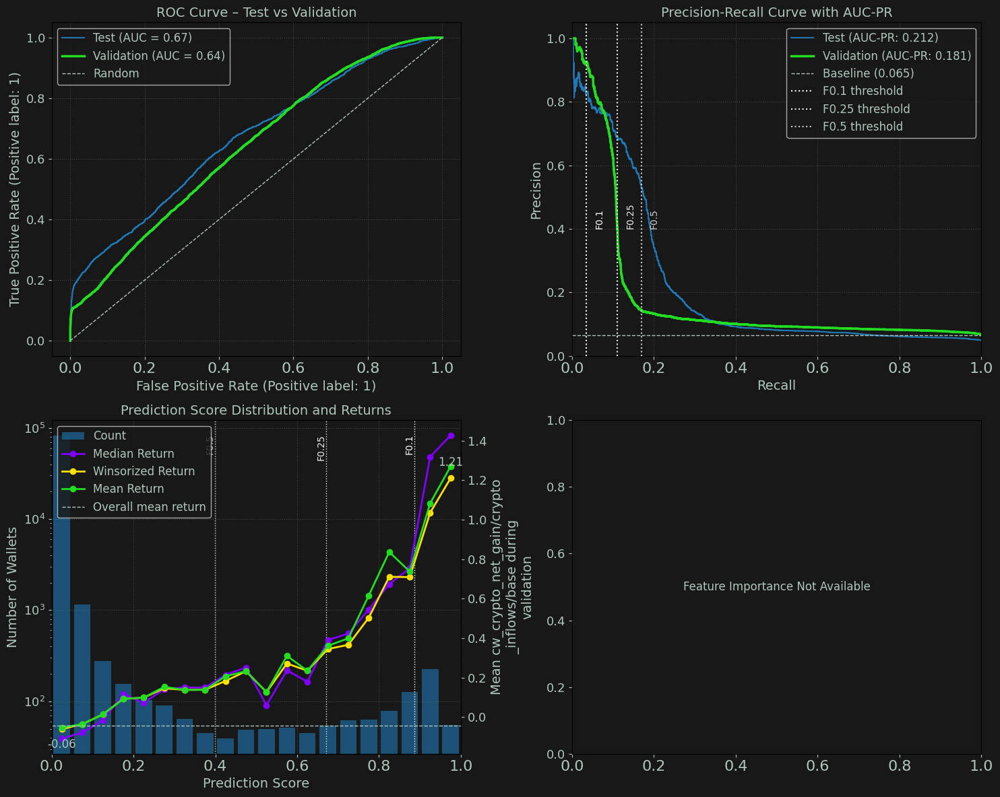

[11/Aug/25 13:40:13] INFO [2800625385.<module>:5] -------------------------------------------------
[11/Aug/25 13:40:13] WARNING [2800625385.<module>:6]                 180: 2024-10-02
[11/Aug/25 13:40:13] INFO [2800625385.<module>:7] -------------------------------------------------
[11/Aug/25 13:40:13] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh180/wscr-dda-951--sh180-0811-131302/output/model.tar.gz
Test Samples:             51,319
Val Positive Samples:     28,683 (16.5%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.513  |  0.789
Val Accuracy:               0.848  |  0.950
Val Precision:              0.655  |  0.614
Val Recall:                 0.175  |  0.279
Val F1 Score:               0.276  |  0.383

Validat

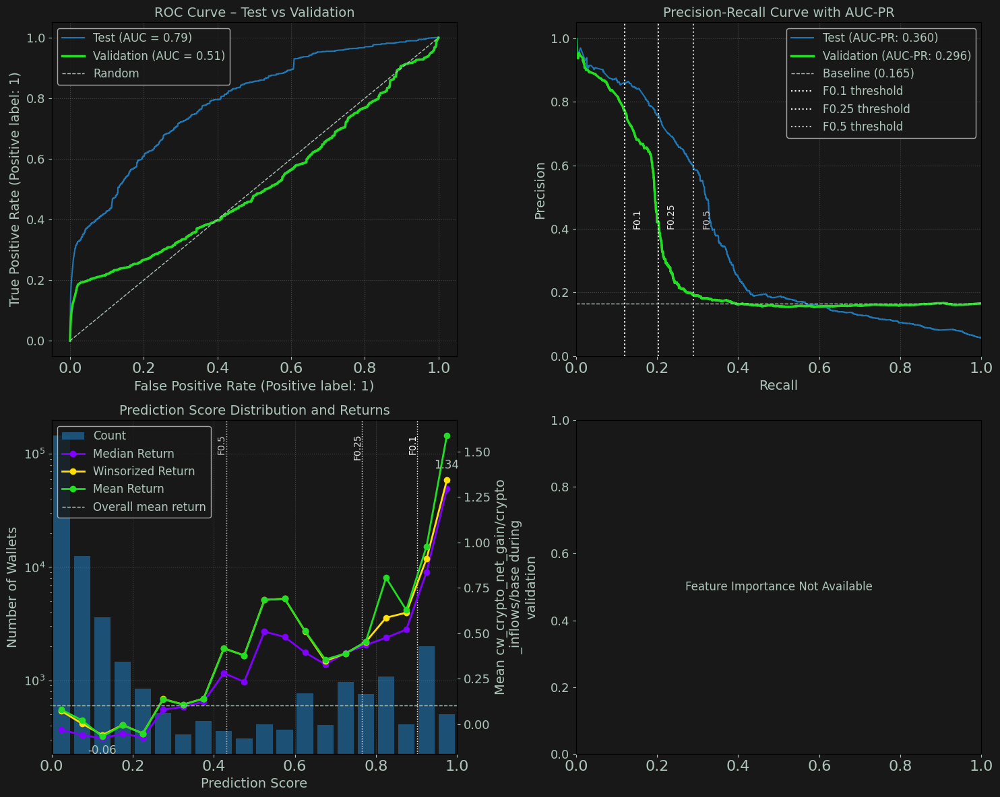

[11/Aug/25 13:40:14] INFO [2800625385.<module>:5] -------------------------------------------------
[11/Aug/25 13:40:14] WARNING [2800625385.<module>:6]                 240: 2024-12-01
[11/Aug/25 13:40:14] INFO [2800625385.<module>:7] -------------------------------------------------
[11/Aug/25 13:40:14] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh240/wscr-dda-951--sh240-0811-131301/output/model.tar.gz
Test Samples:             61,812
Val Positive Samples:     6,831 (3.8%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.795  |  0.690
Val Accuracy:               0.967  |  0.925
Val Precision:              0.593  |  0.626
Val Recall:                 0.456  |  0.254
Val F1 Score:               0.515  |  0.362

Validatio

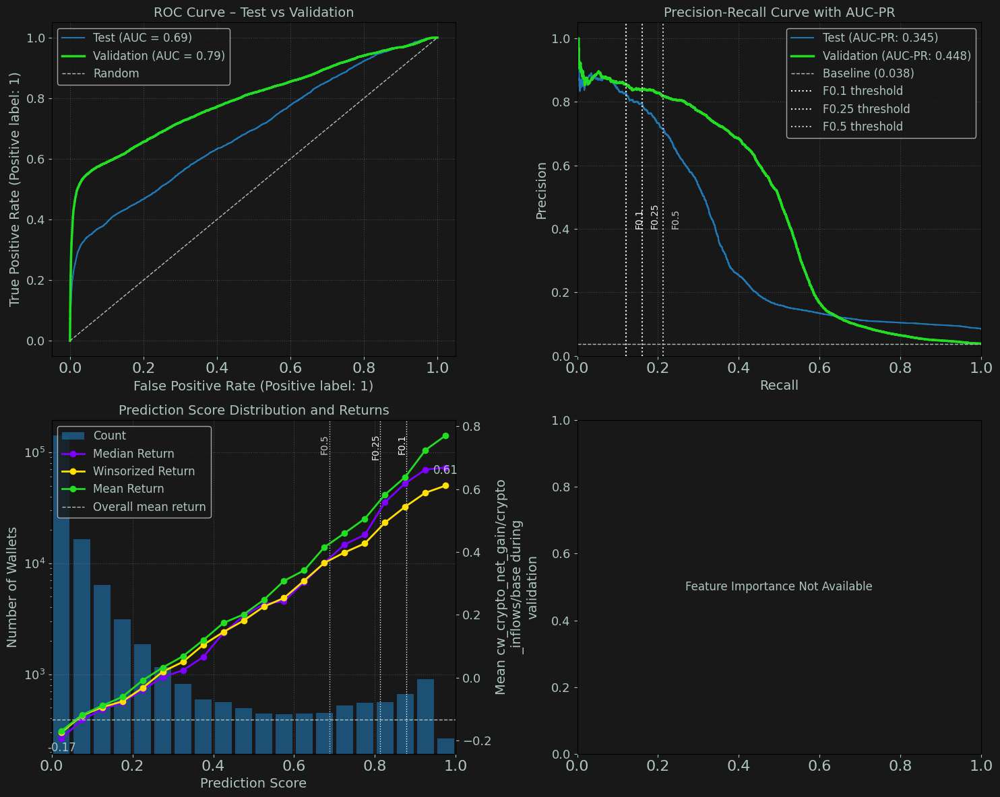

[11/Aug/25 13:40:14] INFO [2800625385.<module>:5] -------------------------------------------------
[11/Aug/25 13:40:14] WARNING [2800625385.<module>:6]                 300: 2025-01-30
[11/Aug/25 13:40:14] INFO [2800625385.<module>:7] -------------------------------------------------
[11/Aug/25 13:40:14] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh300/wscr-dda-951--sh300-0811-131301/output/model.tar.gz
Test Samples:             63,157
Val Positive Samples:     3,031 (3.1%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.588  |  0.633
Val Accuracy:               0.968  |  0.927
Val Precision:              0.445  |  0.616
Val Recall:                 0.140  |  0.255
Val F1 Score:               0.213  |  0.360

Validatio

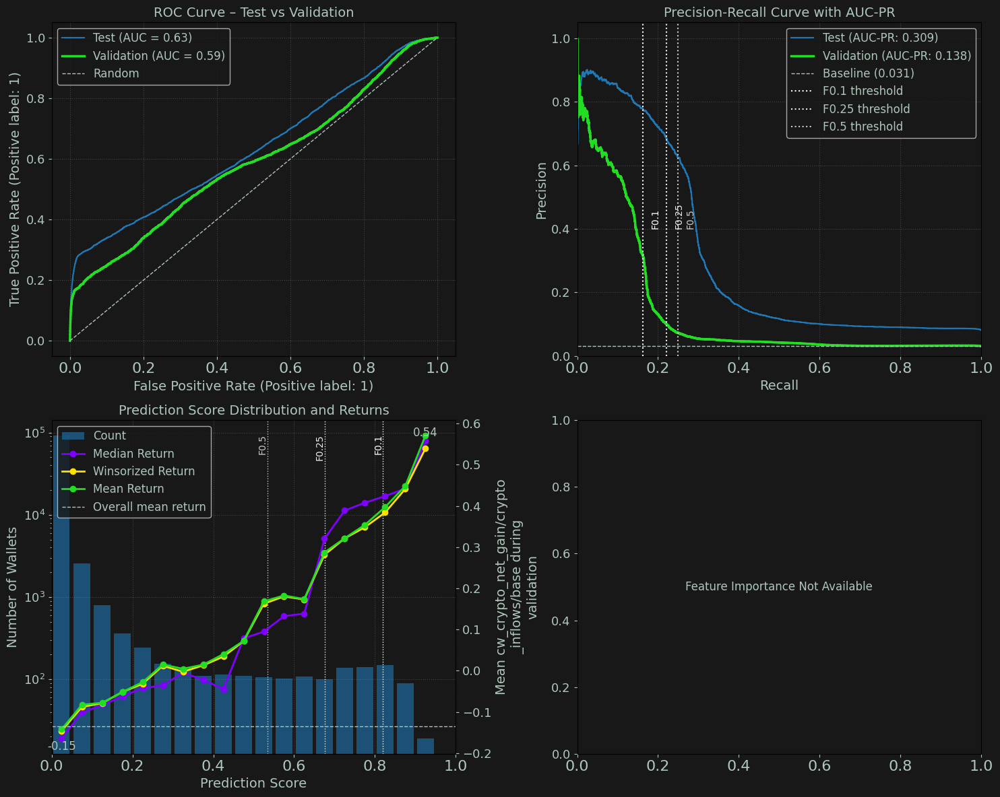

[11/Aug/25 13:40:14] INFO [2800625385.<module>:5] -------------------------------------------------
[11/Aug/25 13:40:14] WARNING [2800625385.<module>:6]                 360: 2025-03-31
[11/Aug/25 13:40:14] INFO [2800625385.<module>:7] -------------------------------------------------
[11/Aug/25 13:40:14] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh360/wscr-dda-951--sh360-0811-131301/output/model.tar.gz
Test Samples:             56,595
Val Positive Samples:     6,429 (8.6%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.653  |  0.690
Val Accuracy:               0.920  |  0.917
Val Precision:              0.569  |  0.606
Val Recall:                 0.257  |  0.285
Val F1 Score:               0.354  |  0.387

Validatio

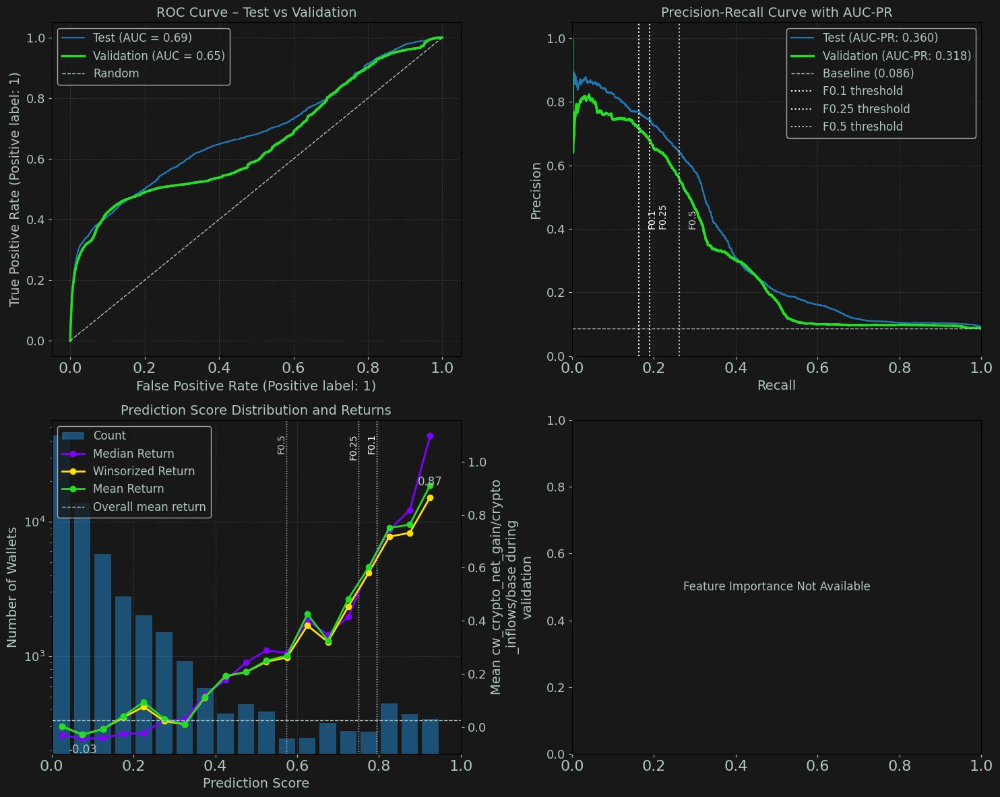

In [16]:
# copy claude chat config cw_ target
for e in evaluators:
    # evaluators[e].summary_report()
    date = (pd.to_datetime('2024-04-05') + timedelta(days=e)).strftime('%Y-%m-%d')
    logger.info('-------------------------------------------------')
    logger.warning(f'                {e}: {date}')
    logger.info('-------------------------------------------------')
    evaluators[e].summary_report()
    evaluators[e].plot_wallet_evaluation()


[11/Aug/25 13:01:41] INFO [771363255.<module>:4] -------------------------------------------------
[11/Aug/25 13:01:41] WARNING [771363255.<module>:5]                    -120
[11/Aug/25 13:01:41] INFO [771363255.<module>:6] -------------------------------------------------
[11/Aug/25 13:01:41] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh-120/wscr-dda-951--sh-120-0811-010138/output/model.tar.gz
Test Samples:             4,732
Val Positive Samples:     382 (1.2%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.668  |  0.832
Val Accuracy:               0.985  |  0.970
Val Precision:              0.037  |  0.481
Val Recall:                 0.008  |  0.188
Val F1 Score:               0.013  |  0.271

Validation Returns    | 

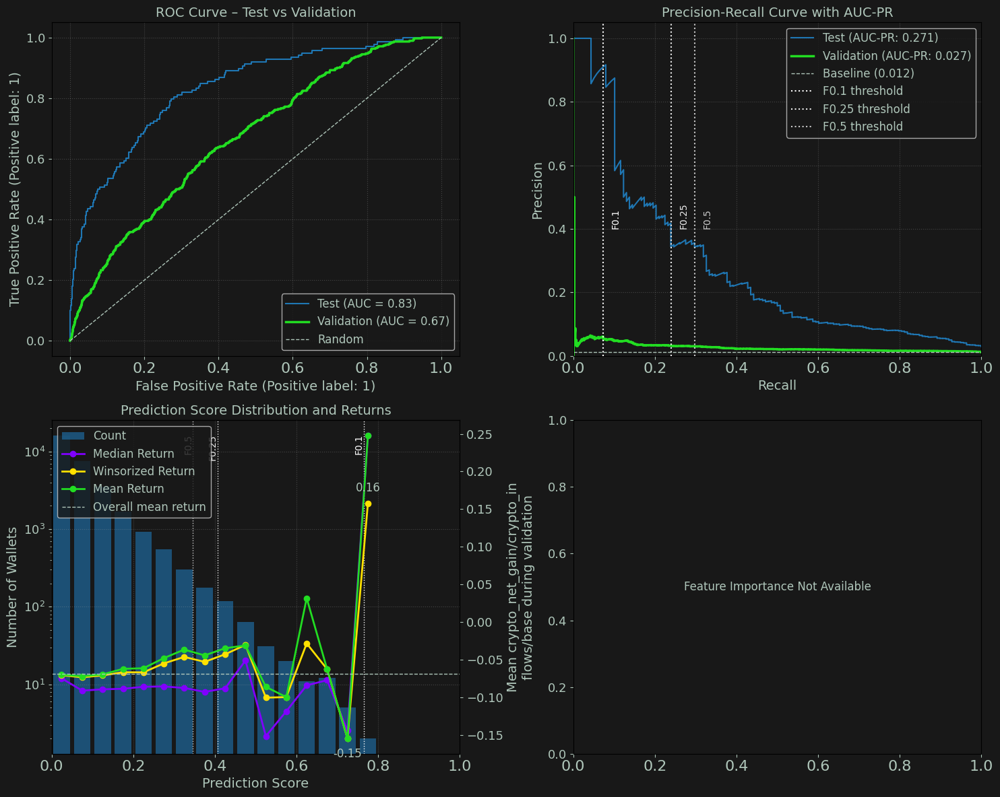

[11/Aug/25 13:01:41] INFO [771363255.<module>:4] -------------------------------------------------
[11/Aug/25 13:01:41] WARNING [771363255.<module>:5]                    -60
[11/Aug/25 13:01:41] INFO [771363255.<module>:6] -------------------------------------------------
[11/Aug/25 13:01:41] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh-60/wscr-dda-951--sh-60-0811-010138/output/model.tar.gz
Test Samples:             9,385
Val Positive Samples:     5,355 (4.7%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.629  |  0.735
Val Accuracy:               0.952  |  0.981
Val Precision:              0.195  |  0.655
Val Recall:                 0.003  |  0.099
Val F1 Score:               0.006  |  0.173

Validation Returns    | C

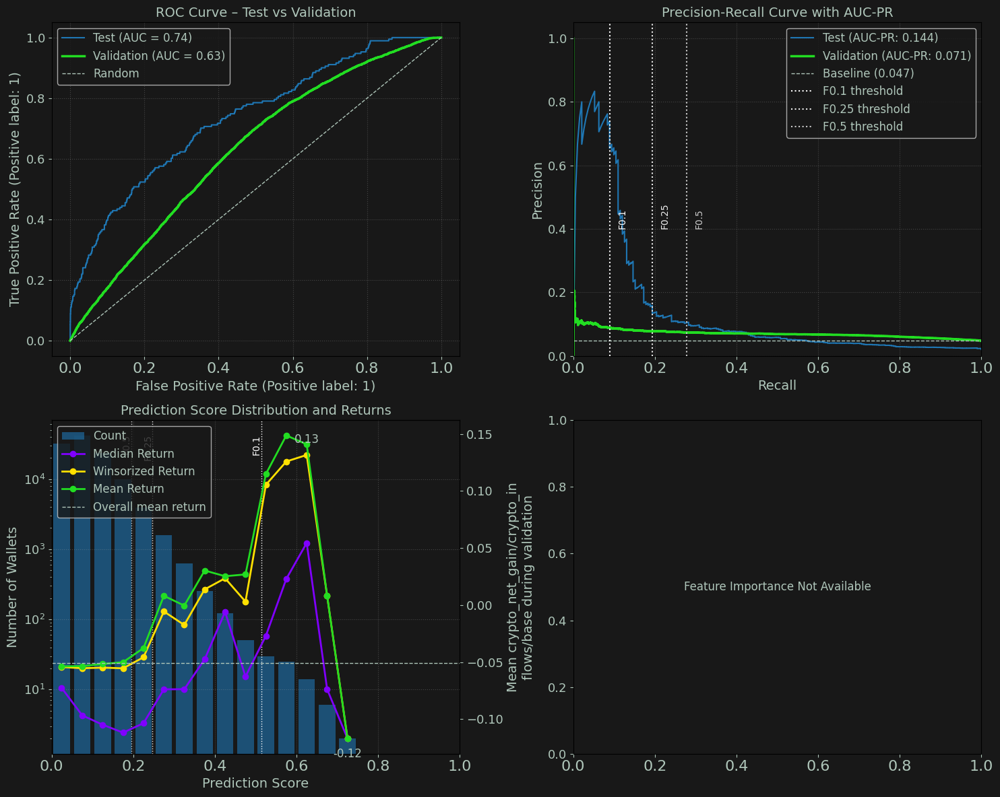

[11/Aug/25 13:01:41] INFO [771363255.<module>:4] -------------------------------------------------
[11/Aug/25 13:01:41] WARNING [771363255.<module>:5]                    0
[11/Aug/25 13:01:41] INFO [771363255.<module>:6] -------------------------------------------------
[11/Aug/25 13:01:41] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh0/wscr-dda-951--sh0-0811-010138/output/model.tar.gz
Test Samples:             26,421
Val Positive Samples:     2,074 (1.3%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.652  |  0.603
Val Accuracy:               0.986  |  0.962
Val Precision:              0.432  |  0.400
Val Recall:                 0.009  |  0.030
Val F1 Score:               0.018  |  0.056

Validation Returns    | Cutoff

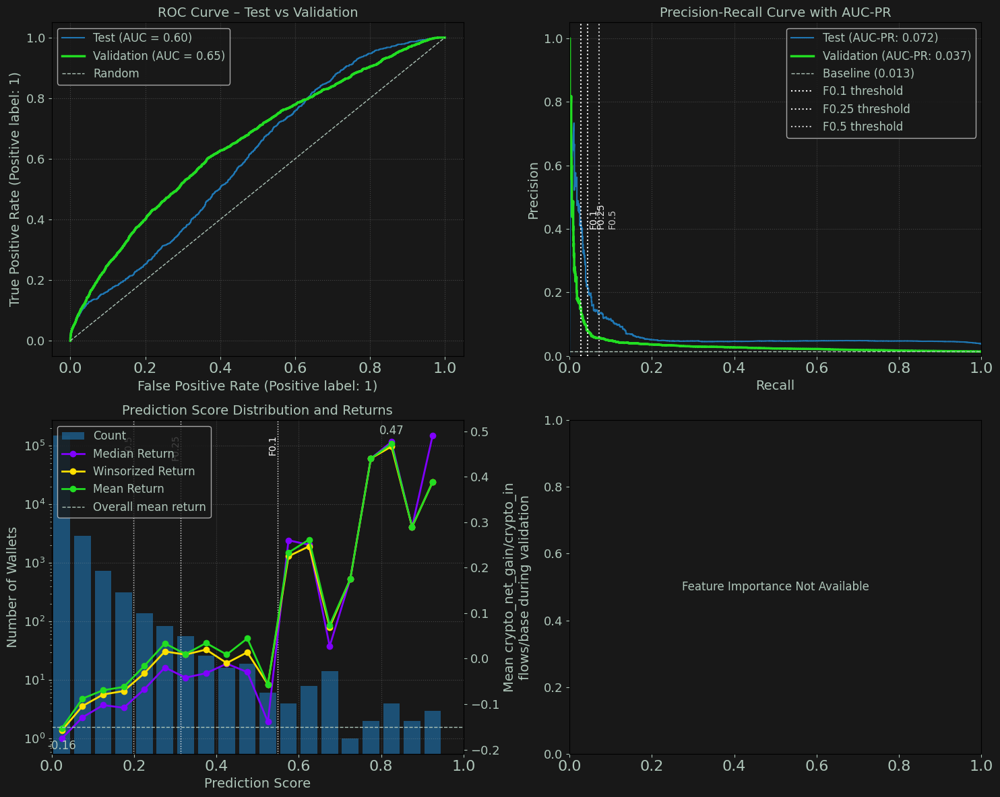

[11/Aug/25 13:01:42] INFO [771363255.<module>:4] -------------------------------------------------
[11/Aug/25 13:01:42] WARNING [771363255.<module>:5]                    120
[11/Aug/25 13:01:42] INFO [771363255.<module>:6] -------------------------------------------------
[11/Aug/25 13:01:42] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh120/wscr-dda-951--sh120-0811-010138/output/model.tar.gz
Test Samples:             53,598
Val Positive Samples:     3,802 (4.5%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.719  |  0.644
Val Accuracy:               0.958  |  0.973
Val Precision:              0.705  |  0.458
Val Recall:                 0.106  |  0.057
Val F1 Score:               0.184  |  0.101

Validation Returns    | 

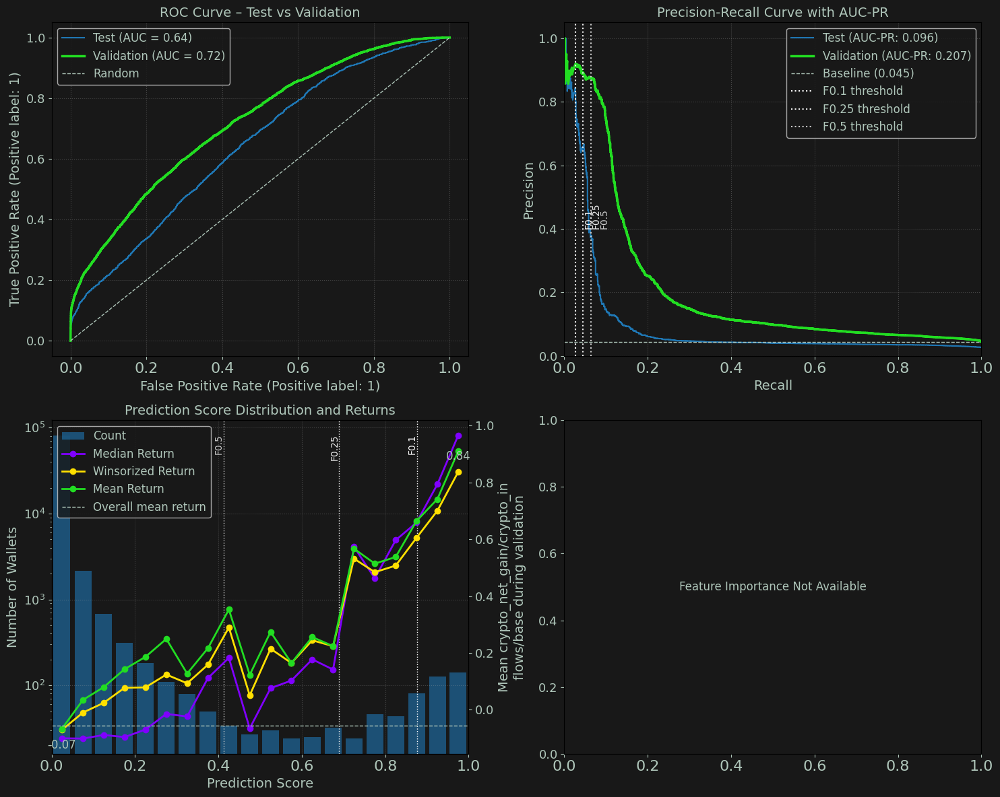

[11/Aug/25 13:01:42] INFO [771363255.<module>:4] -------------------------------------------------
[11/Aug/25 13:01:42] WARNING [771363255.<module>:5]                    180
[11/Aug/25 13:01:42] INFO [771363255.<module>:6] -------------------------------------------------
[11/Aug/25 13:01:42] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh180/wscr-dda-951--sh180-0811-010138/output/model.tar.gz
Test Samples:             51,319
Val Positive Samples:     27,452 (15.8%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.493  |  0.772
Val Accuracy:               0.844  |  0.968
Val Precision:              0.538  |  0.547
Val Recall:                 0.079  |  0.207
Val F1 Score:               0.138  |  0.300

Validation Returns    

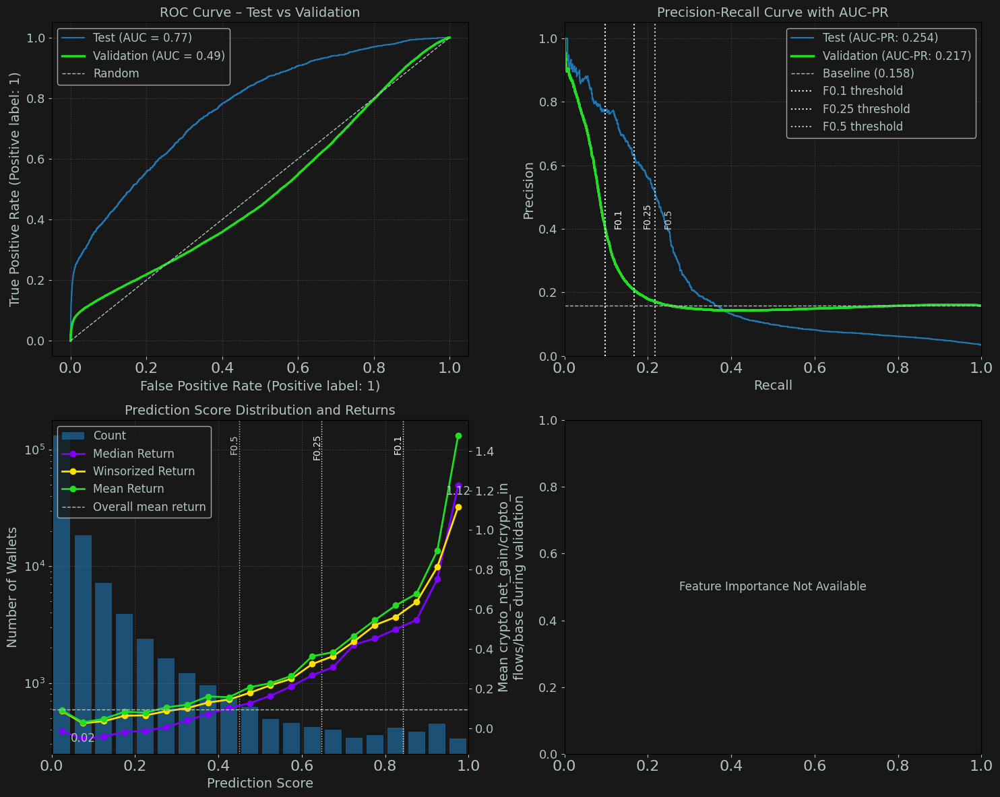

[11/Aug/25 13:01:43] INFO [771363255.<module>:4] -------------------------------------------------
[11/Aug/25 13:01:43] WARNING [771363255.<module>:5]                    240
[11/Aug/25 13:01:43] INFO [771363255.<module>:6] -------------------------------------------------
[11/Aug/25 13:01:43] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh240/wscr-dda-951--sh240-0811-010138/output/model.tar.gz
Test Samples:             61,812
Val Positive Samples:     2,595 (1.5%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.783  |  0.707
Val Accuracy:               0.985  |  0.927
Val Precision:              0.449  |  0.527
Val Recall:                 0.103  |  0.076
Val F1 Score:               0.167  |  0.133

Validation Returns    | 

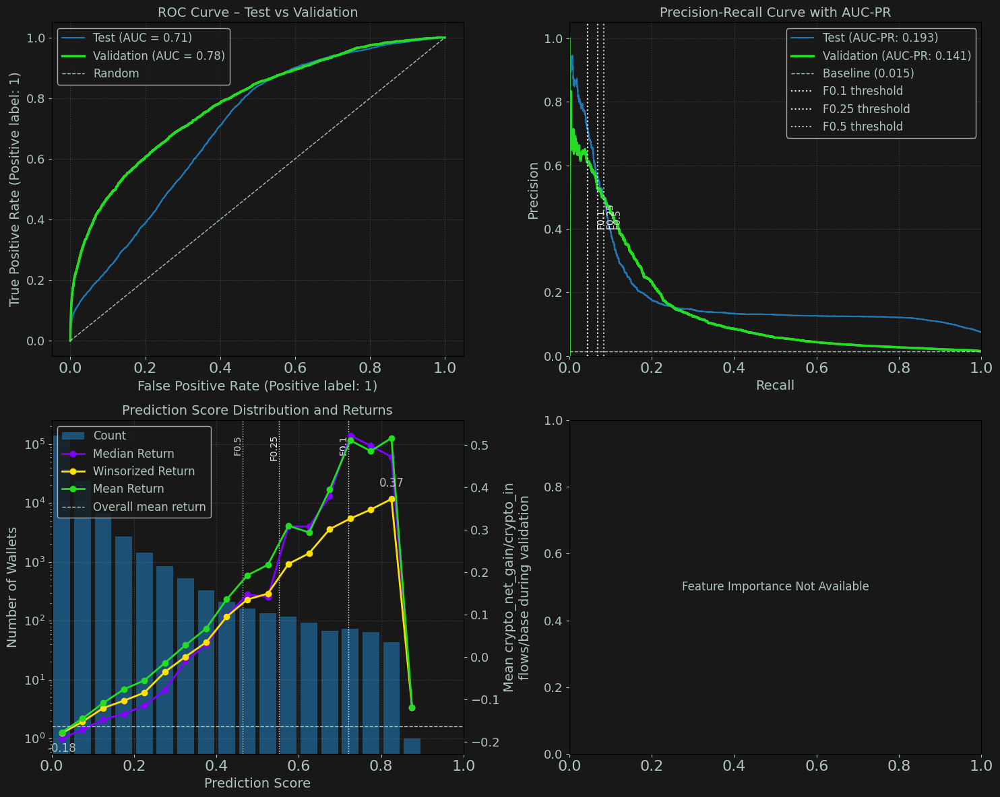

[11/Aug/25 13:01:43] INFO [771363255.<module>:4] -------------------------------------------------
[11/Aug/25 13:01:43] WARNING [771363255.<module>:5]                    300
[11/Aug/25 13:01:43] INFO [771363255.<module>:6] -------------------------------------------------
[11/Aug/25 13:01:43] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh300/wscr-dda-951--sh300-0811-010138/output/model.tar.gz
Test Samples:             63,157
Val Positive Samples:     1,951 (2.0%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.677  |  0.827
Val Accuracy:               0.979  |  0.930
Val Precision:              0.190  |  0.564
Val Recall:                 0.016  |  0.056
Val F1 Score:               0.029  |  0.102

Validation Returns    | 

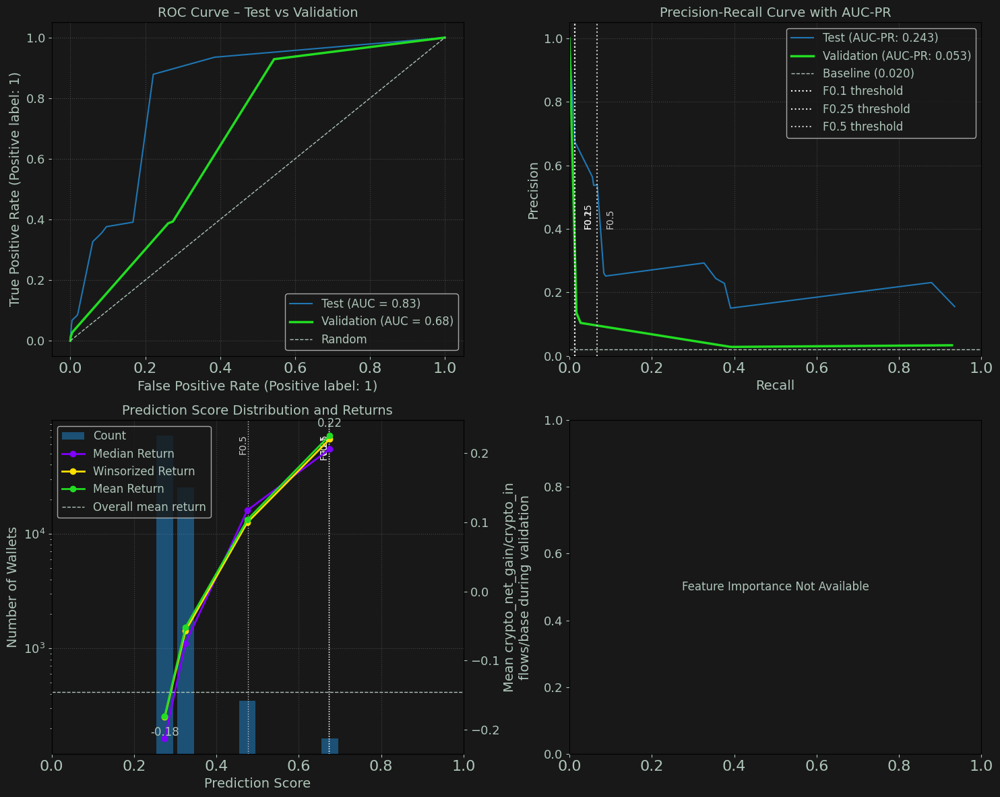

[11/Aug/25 13:01:44] INFO [771363255.<module>:4] -------------------------------------------------
[11/Aug/25 13:01:44] WARNING [771363255.<module>:5]                    360
[11/Aug/25 13:01:44] INFO [771363255.<module>:6] -------------------------------------------------
[11/Aug/25 13:01:44] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.4 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-remass/sh360/wscr-dda-951--sh360-0811-010138/output/model.tar.gz
Test Samples:             56,595
Val Positive Samples:     4,329 (5.8%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.686  |  0.811
Val Accuracy:               0.936  |  0.917
Val Precision:              0.273  |  0.475
Val Recall:                 0.068  |  0.094
Val F1 Score:               0.109  |  0.157

Validation Returns    | 

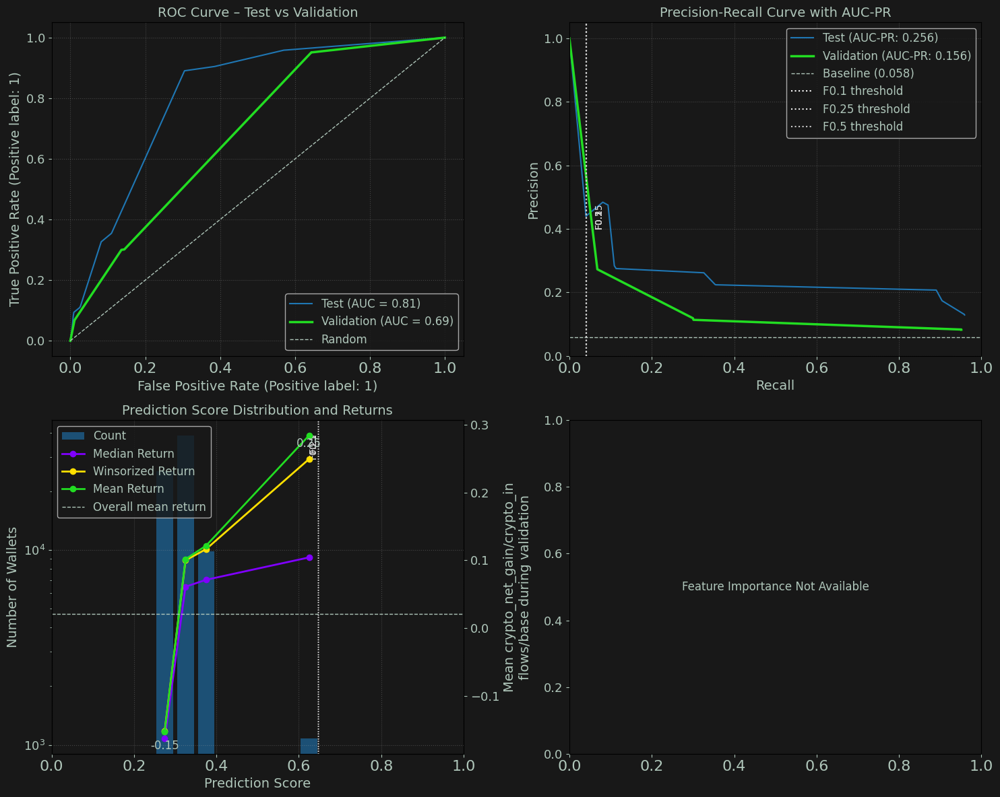

In [5]:
# copy claude chat config
for e in evaluators:
    # evaluators[e].summary_report()
    logger.info('-------------------------------------------------')
    logger.warning(f'                   {e}')
    logger.info('-------------------------------------------------')
    evaluators[e].summary_report()
    evaluators[e].plot_wallet_evaluation()


[11/Aug/25 00:04:51] INFO [1521715847.<module>:4] -------------------------------------------------
[11/Aug/25 00:04:51] WARNING [1521715847.<module>:5]                    -360
[11/Aug/25 00:04:51] INFO [1521715847.<module>:6] -------------------------------------------------
[11/Aug/25 00:04:51] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-360/wscr-dda-951--sh-360-0810-234726/output/model.tar.gz
Test Samples:             8,342
Val Positive Samples:     6,021 (22.9%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.581  |  0.573
Val Accuracy:               0.769  |  0.804
Val Precision:              0.125  |  0.667
Val Recall:                 0.002  |  0.023
Val F1 Score:               0.003  |  0.044

Validation Retu

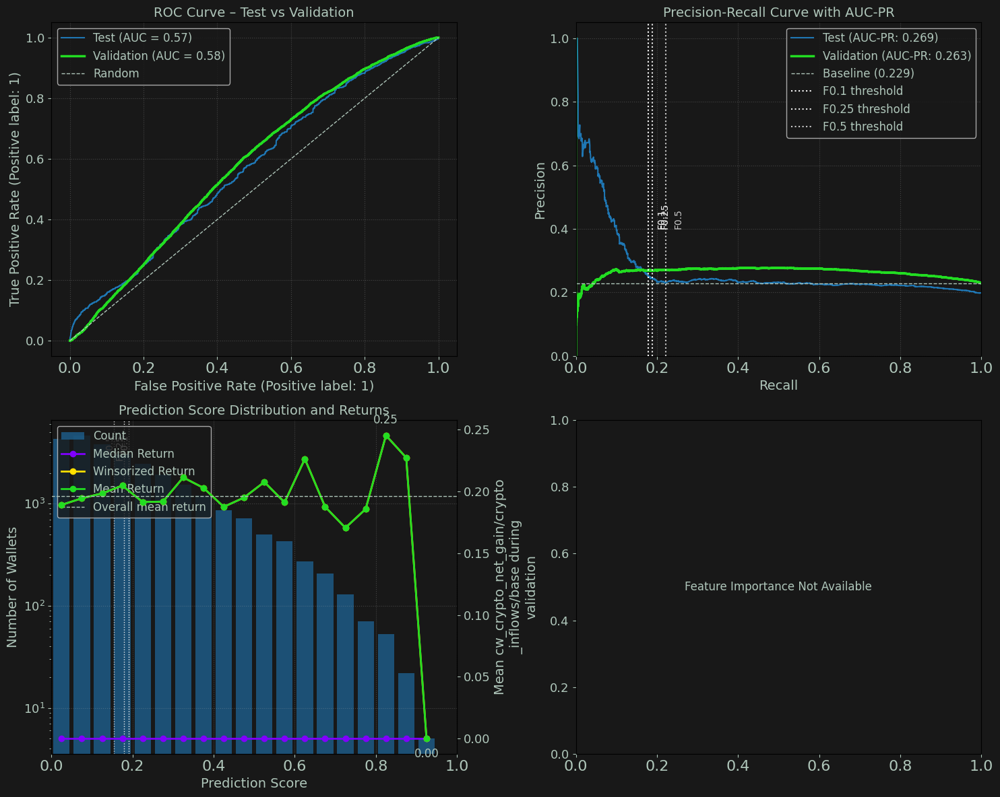

[11/Aug/25 00:04:51] INFO [1521715847.<module>:4] -------------------------------------------------
[11/Aug/25 00:04:51] WARNING [1521715847.<module>:5]                    -300
[11/Aug/25 00:04:51] INFO [1521715847.<module>:6] -------------------------------------------------
[11/Aug/25 00:04:51] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-300/wscr-dda-951--sh-300-0810-234726/output/model.tar.gz
Test Samples:             16,384
Val Positive Samples:     1,884 (3.8%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.532  |  0.593
Val Accuracy:               0.956  |  0.858
Val Precision:              0.103  |  0.722
Val Recall:                 0.020  |  0.203
Val F1 Score:               0.033  |  0.317

Validation Retu

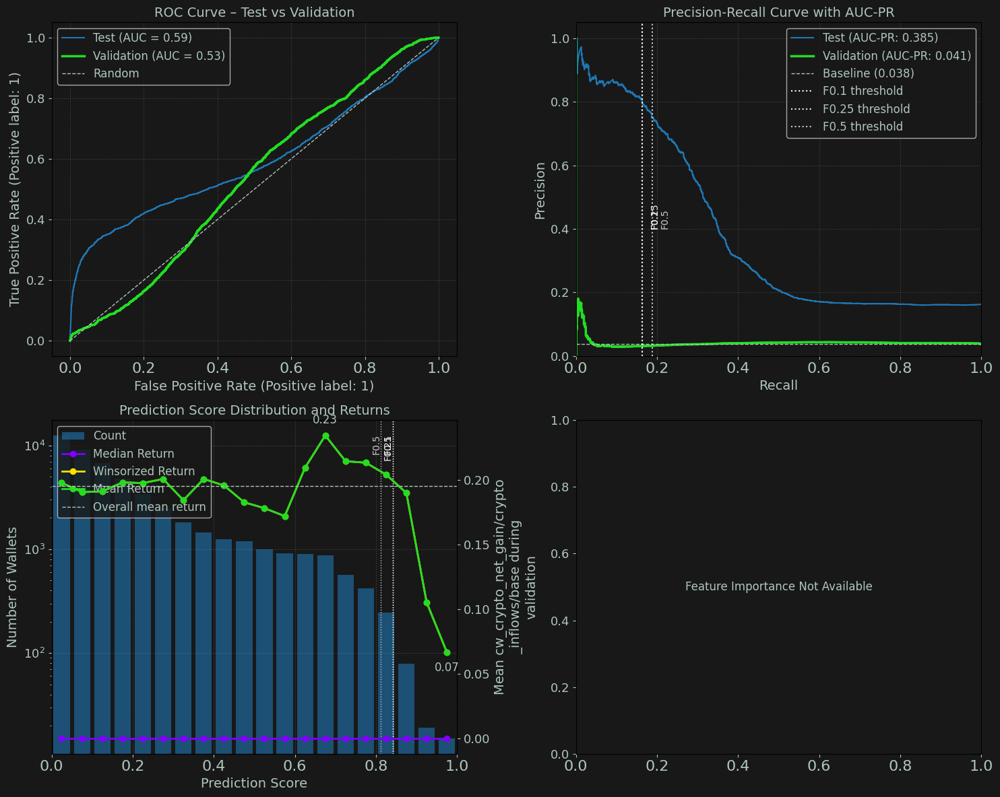

[11/Aug/25 00:04:51] INFO [1521715847.<module>:4] -------------------------------------------------
[11/Aug/25 00:04:51] WARNING [1521715847.<module>:5]                    -240
[11/Aug/25 00:04:51] INFO [1521715847.<module>:6] -------------------------------------------------
[11/Aug/25 00:04:51] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-240/wscr-dda-951--sh-240-0810-234726/output/model.tar.gz
Test Samples:             23,162
Val Positive Samples:     2,035 (4.5%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.564  |  0.697
Val Accuracy:               0.951  |  0.892
Val Precision:              0.000  |  0.743
Val Recall:                 0.000  |  0.234
Val F1 Score:               0.000  |  0.356

Validation Retu

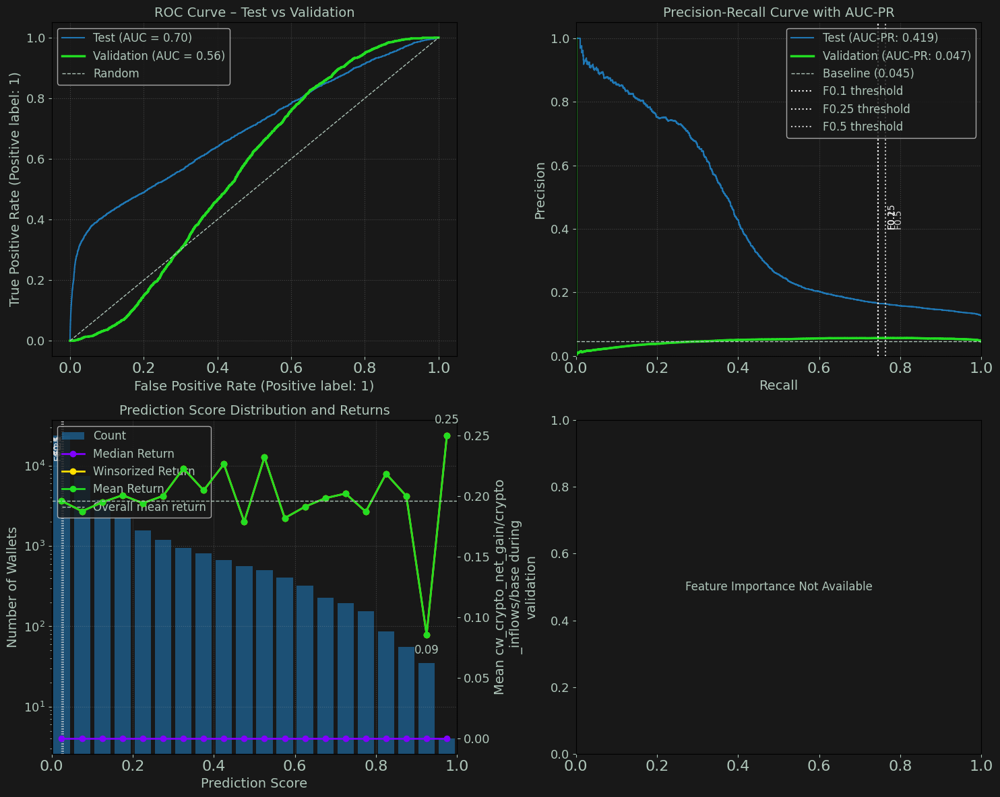

[11/Aug/25 00:04:52] INFO [1521715847.<module>:4] -------------------------------------------------
[11/Aug/25 00:04:52] WARNING [1521715847.<module>:5]                    -180
[11/Aug/25 00:04:52] INFO [1521715847.<module>:6] -------------------------------------------------
[11/Aug/25 00:04:52] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-180/wscr-dda-951--sh-180-0810-234726/output/model.tar.gz
Test Samples:             29,027
Val Positive Samples:     5,569 (17.0%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.492  |  0.738
Val Accuracy:               0.830  |  0.905
Val Precision:              0.000  |  0.765
Val Recall:                 0.000  |  0.221
Val F1 Score:               0.000  |  0.343

Validation Ret

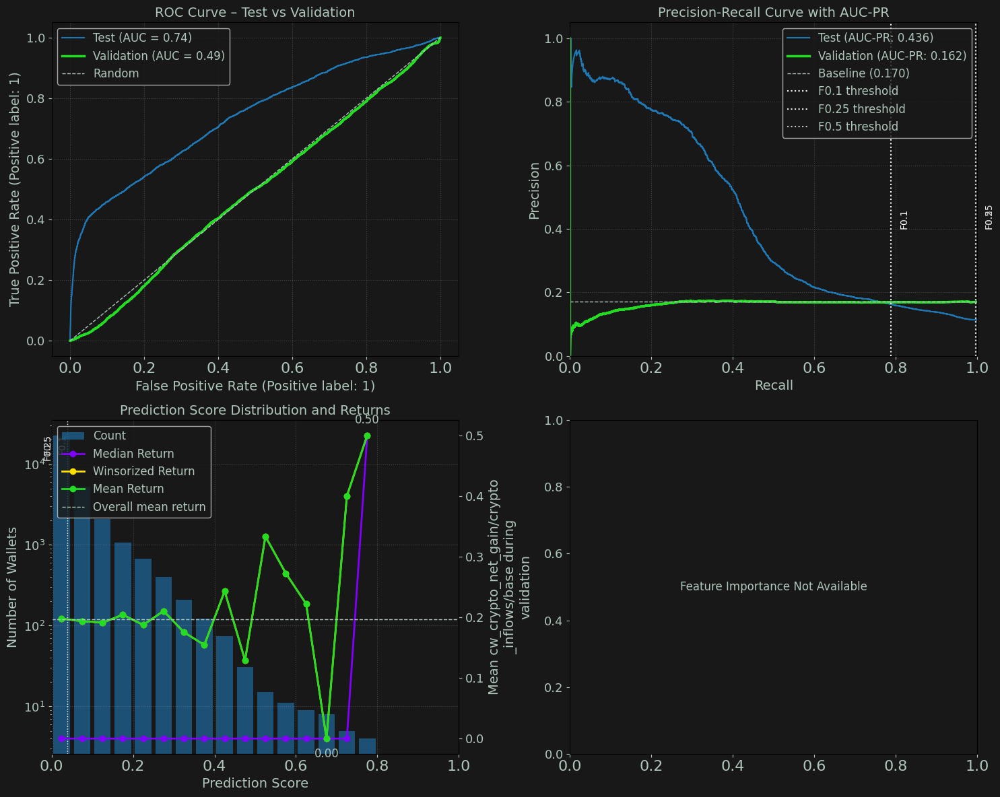

[11/Aug/25 00:04:52] INFO [1521715847.<module>:4] -------------------------------------------------
[11/Aug/25 00:04:52] WARNING [1521715847.<module>:5]                    -120
[11/Aug/25 00:04:52] INFO [1521715847.<module>:6] -------------------------------------------------
[11/Aug/25 00:04:52] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-120/wscr-dda-951--sh-120-0810-234726/output/model.tar.gz
Test Samples:             34,322
Val Positive Samples:     13,368 (29.1%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.513  |  0.786
Val Accuracy:               0.695  |  0.892
Val Precision:              0.322  |  0.711
Val Recall:                 0.043  |  0.260
Val F1 Score:               0.076  |  0.381

Validation Re

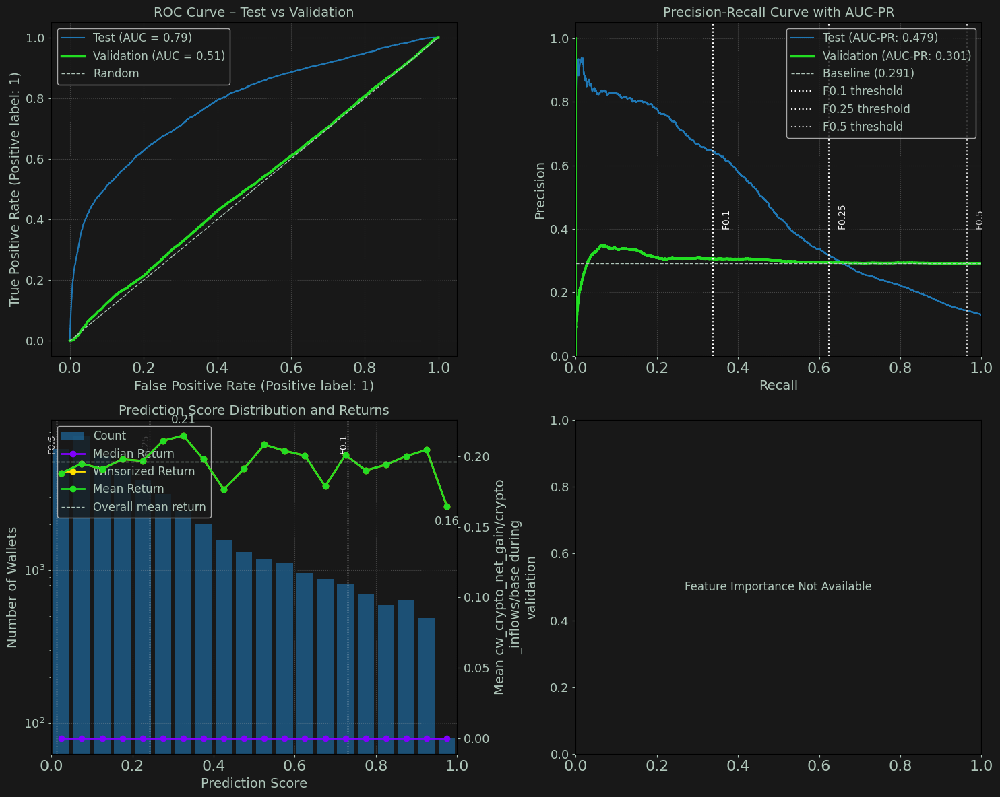

[11/Aug/25 00:04:52] INFO [1521715847.<module>:4] -------------------------------------------------
[11/Aug/25 00:04:52] WARNING [1521715847.<module>:5]                    -60
[11/Aug/25 00:04:52] INFO [1521715847.<module>:6] -------------------------------------------------
[11/Aug/25 00:04:52] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-60/wscr-dda-951--sh-60-0810-234726/output/model.tar.gz
Test Samples:             43,032
Val Positive Samples:     5,458 (8.1%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.439  |  0.774
Val Accuracy:               0.877  |  0.882
Val Precision:              0.069  |  0.721
Val Recall:                 0.042  |  0.355
Val F1 Score:               0.052  |  0.476

Validation Returns

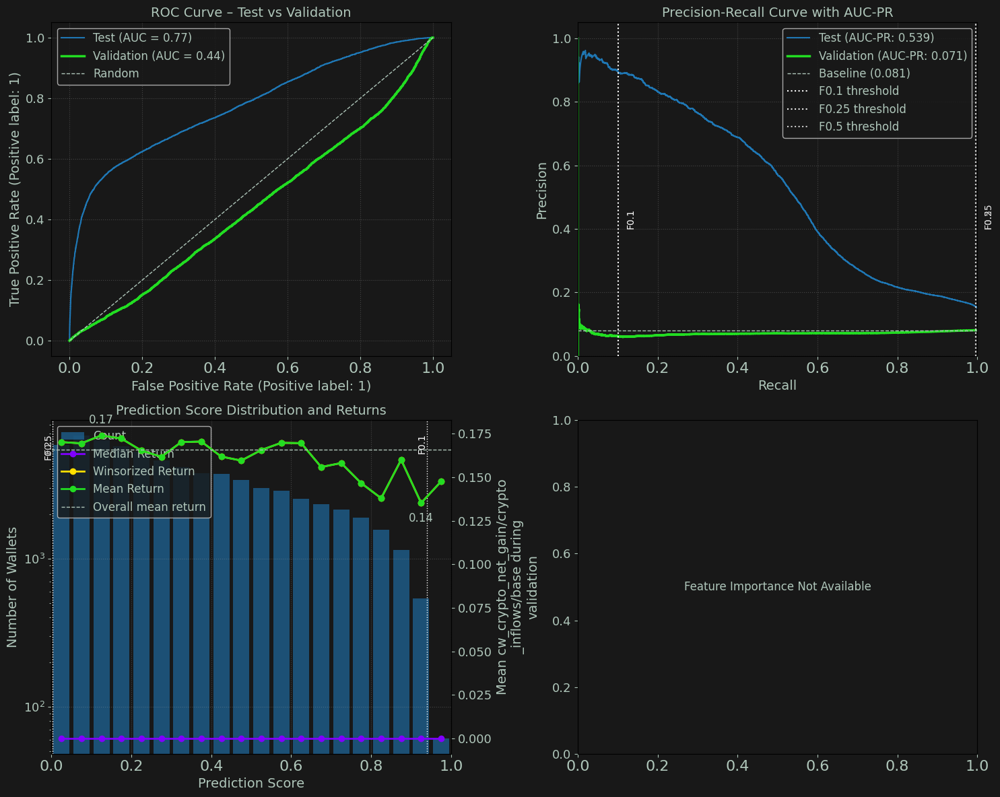

[11/Aug/25 00:04:53] INFO [1521715847.<module>:4] -------------------------------------------------
[11/Aug/25 00:04:53] WARNING [1521715847.<module>:5]                    0
[11/Aug/25 00:04:53] INFO [1521715847.<module>:6] -------------------------------------------------
[11/Aug/25 00:04:53] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh0/wscr-dda-951--sh0-0810-234726/output/model.tar.gz
Test Samples:             46,644
Val Positive Samples:     711 (1.9%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.456  |  0.782
Val Accuracy:               0.962  |  0.894
Val Precision:              0.014  |  0.743
Val Recall:                 0.015  |  0.351
Val F1 Score:               0.015  |  0.476

Validation Returns    | Cu

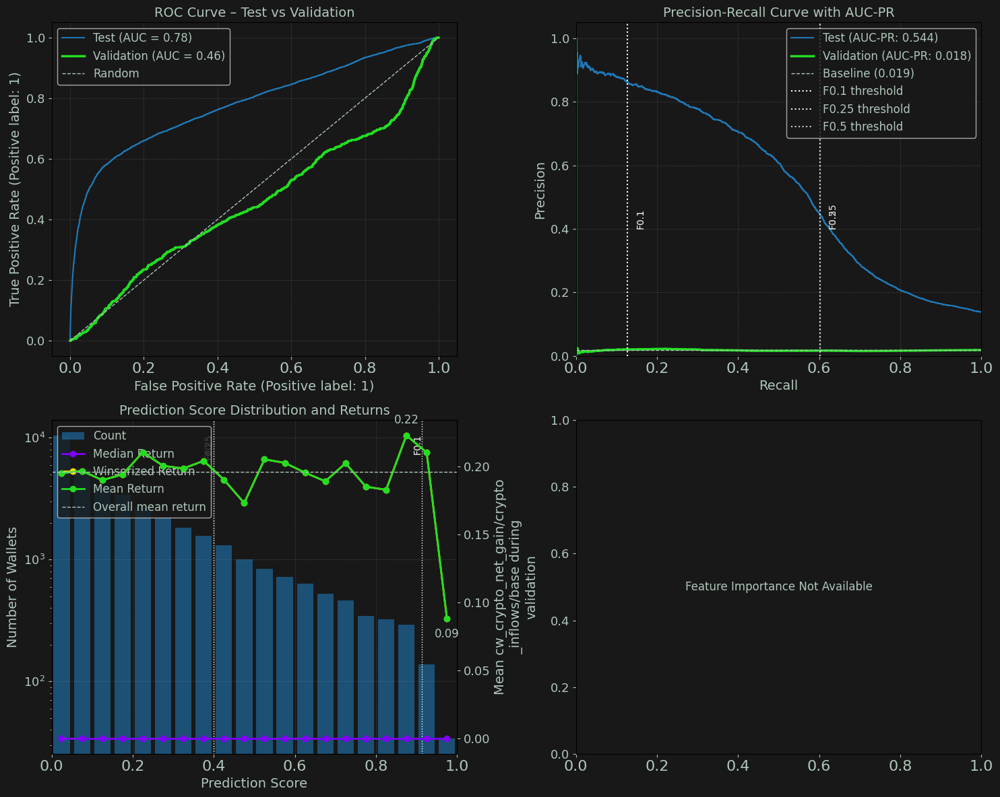

In [49]:
# 2 val offsets cw_ target
for e in evaluators:
    # evaluators[e].summary_report()
    logger.info('-------------------------------------------------')
    logger.warning(f'                   {e}')
    logger.info('-------------------------------------------------')
    evaluators[e].summary_report()
    evaluators[e].plot_wallet_evaluation()


[10/Aug/25 23:47:23] INFO [2686379832.<module>:4] -------------------------------------------------
[10/Aug/25 23:47:23] WARNING [2686379832.<module>:5]                    -360
[10/Aug/25 23:47:23] INFO [2686379832.<module>:6] -------------------------------------------------
[10/Aug/25 23:47:23] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-360/wscr-dda-951--sh-360-0810-232252/output/model.tar.gz
Test Samples:             8,342
Val Positive Samples:     6,021 (22.9%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.581  |  0.513
Val Accuracy:               0.769  |  0.801
Val Precision:              0.125  |  0.200
Val Recall:                 0.002  |  0.001
Val F1 Score:               0.003  |  0.001

Validation Retu

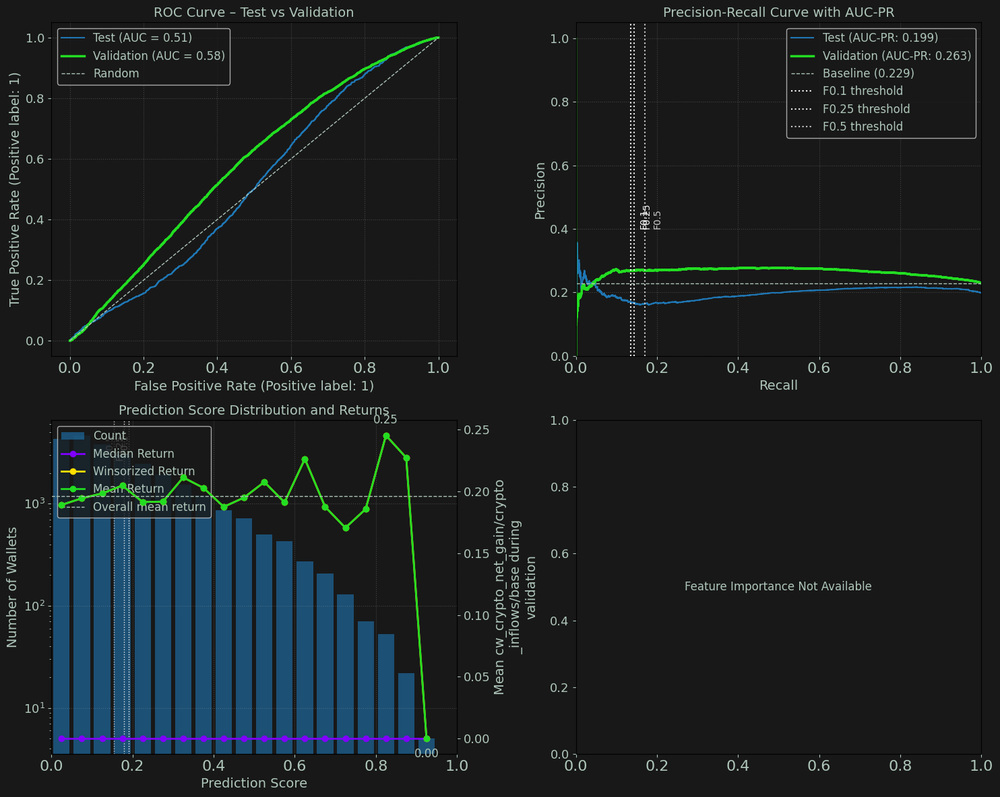

[10/Aug/25 23:47:23] INFO [2686379832.<module>:4] -------------------------------------------------
[10/Aug/25 23:47:23] WARNING [2686379832.<module>:5]                    -300
[10/Aug/25 23:47:23] INFO [2686379832.<module>:6] -------------------------------------------------
[10/Aug/25 23:47:23] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-300/wscr-dda-951--sh-300-0810-232252/output/model.tar.gz
Test Samples:             16,384
Val Positive Samples:     1,884 (3.8%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.512  |  0.575
Val Accuracy:               0.961  |  0.841
Val Precision:              0.020  |  0.716
Val Recall:                 0.001  |  0.038
Val F1 Score:               0.001  |  0.072

Validation Retu

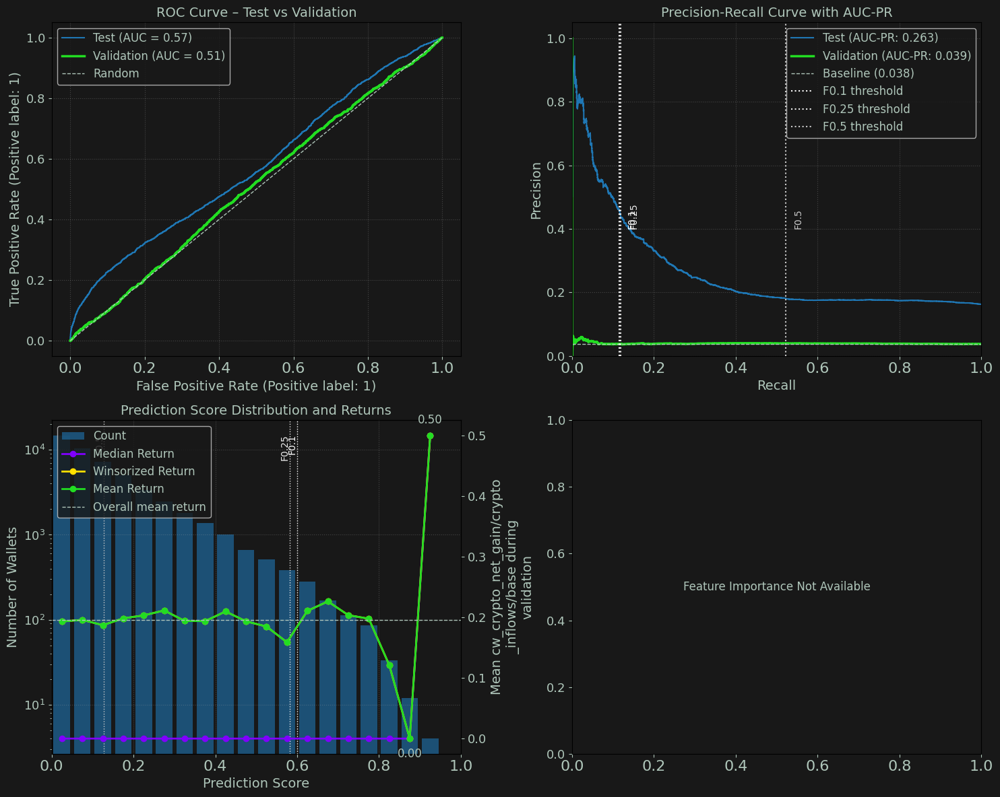

[10/Aug/25 23:47:24] INFO [2686379832.<module>:4] -------------------------------------------------
[10/Aug/25 23:47:24] WARNING [2686379832.<module>:5]                    -240
[10/Aug/25 23:47:24] INFO [2686379832.<module>:6] -------------------------------------------------
[10/Aug/25 23:47:24] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-240/wscr-dda-951--sh-240-0810-232252/output/model.tar.gz
Test Samples:             23,162
Val Positive Samples:     2,035 (4.5%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.513  |  0.636
Val Accuracy:               0.953  |  0.875
Val Precision:              0.073  |  0.731
Val Recall:                 0.004  |  0.039
Val F1 Score:               0.007  |  0.073

Validation Retu

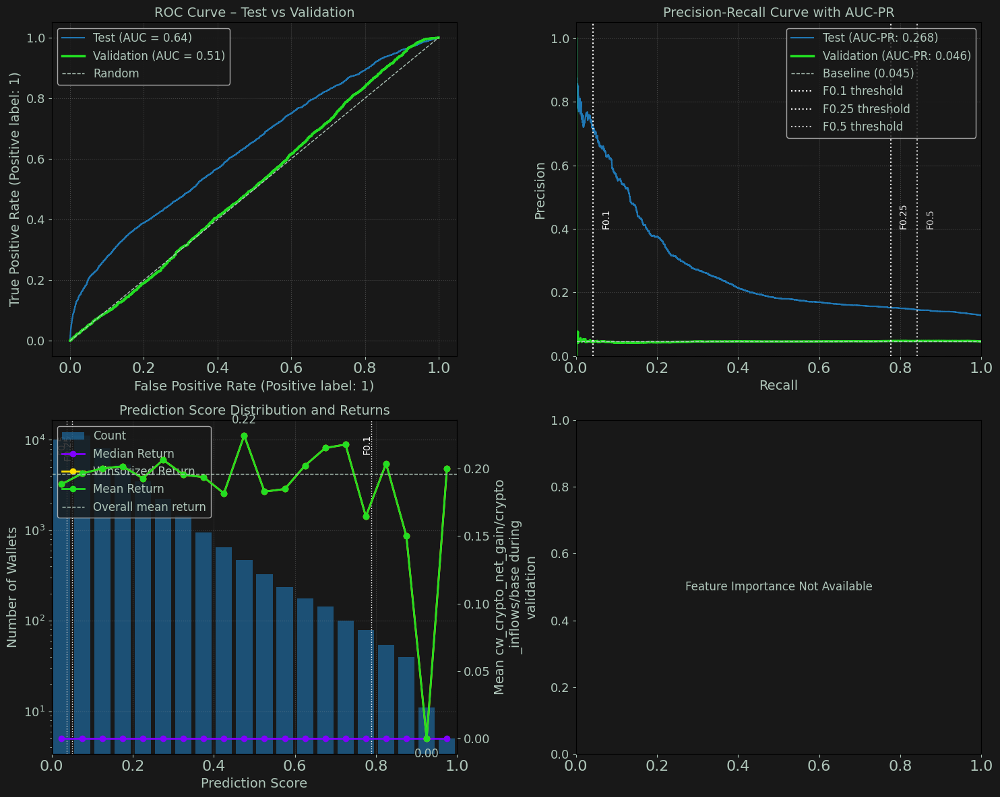

[10/Aug/25 23:47:24] INFO [2686379832.<module>:4] -------------------------------------------------
[10/Aug/25 23:47:24] WARNING [2686379832.<module>:5]                    -180
[10/Aug/25 23:47:24] INFO [2686379832.<module>:6] -------------------------------------------------
[10/Aug/25 23:47:24] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-180/wscr-dda-951--sh-180-0810-232252/output/model.tar.gz
Test Samples:             29,027
Val Positive Samples:     5,569 (17.0%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.496  |  0.671
Val Accuracy:               0.829  |  0.890
Val Precision:              0.222  |  0.779
Val Recall:                 0.000  |  0.035
Val F1 Score:               0.001  |  0.066

Validation Ret

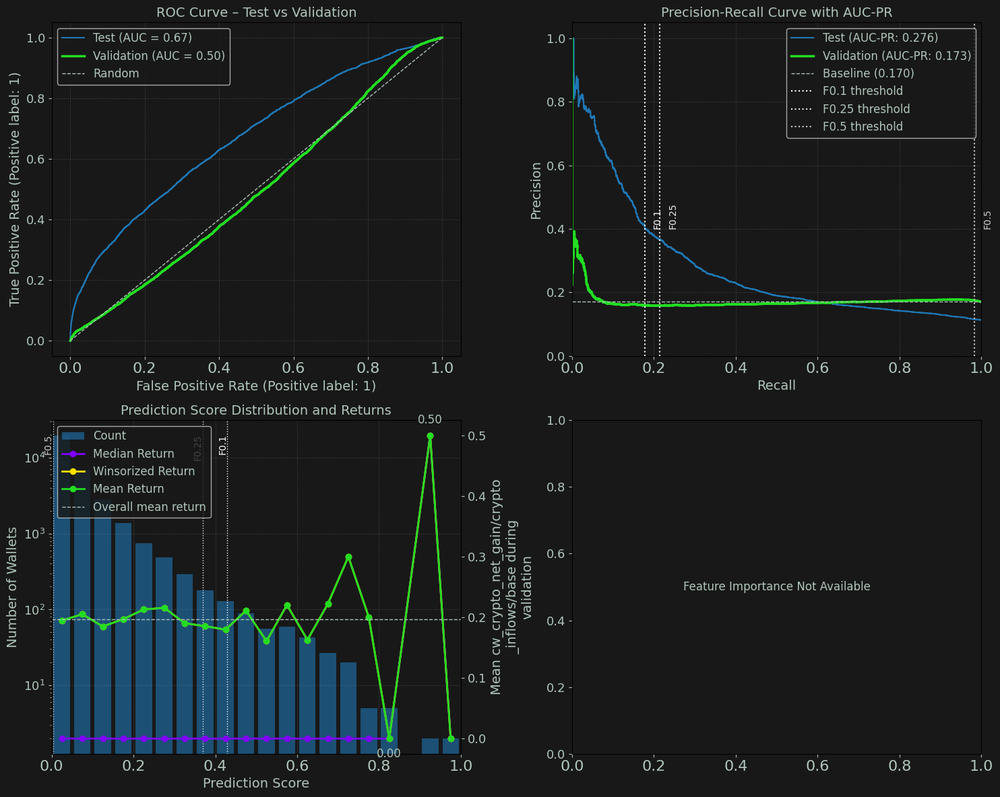

[10/Aug/25 23:47:24] INFO [2686379832.<module>:4] -------------------------------------------------
[10/Aug/25 23:47:24] WARNING [2686379832.<module>:5]                    -120
[10/Aug/25 23:47:24] INFO [2686379832.<module>:6] -------------------------------------------------
[10/Aug/25 23:47:24] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-120/wscr-dda-951--sh-120-0810-232252/output/model.tar.gz
Test Samples:             34,322
Val Positive Samples:     13,368 (29.1%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.478  |  0.662
Val Accuracy:               0.706  |  0.877
Val Precision:              0.166  |  0.672
Val Recall:                 0.002  |  0.071
Val F1 Score:               0.005  |  0.128

Validation Re

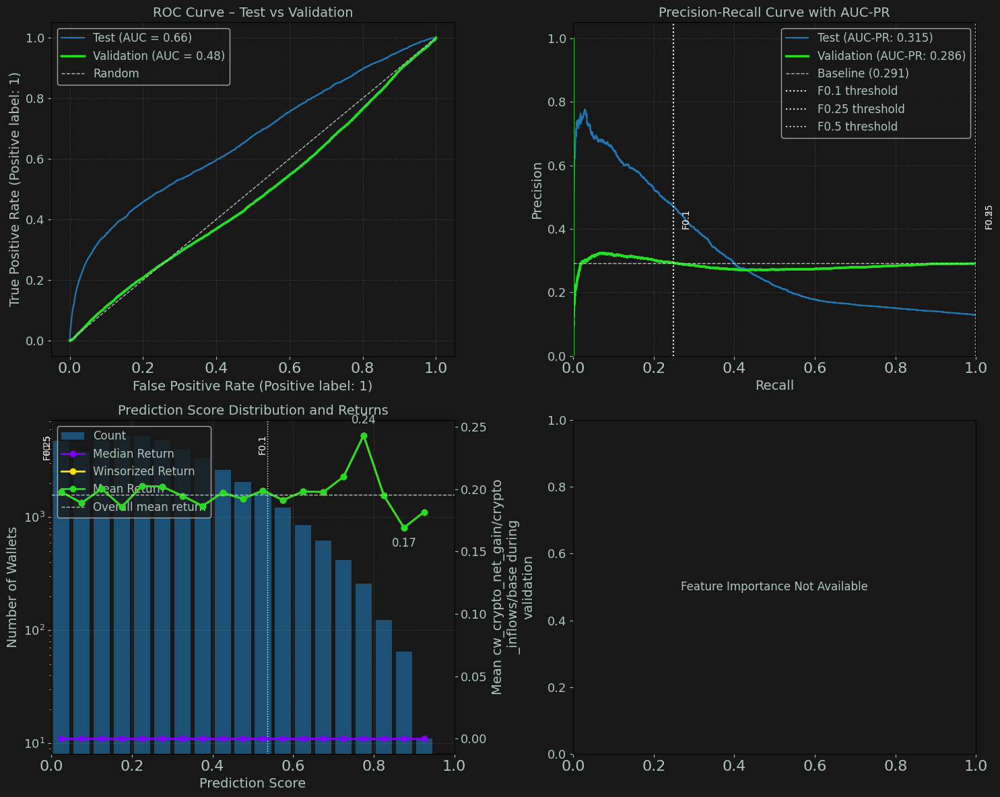

[10/Aug/25 23:47:25] INFO [2686379832.<module>:4] -------------------------------------------------
[10/Aug/25 23:47:25] WARNING [2686379832.<module>:5]                    -60
[10/Aug/25 23:47:25] INFO [2686379832.<module>:6] -------------------------------------------------
[10/Aug/25 23:47:25] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-60/wscr-dda-951--sh-60-0810-232252/output/model.tar.gz
Test Samples:             43,032
Val Positive Samples:     5,458 (8.1%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.455  |  0.734
Val Accuracy:               0.859  |  0.861
Val Precision:              0.061  |  0.607
Val Recall:                 0.051  |  0.216
Val F1 Score:               0.056  |  0.319

Validation Returns

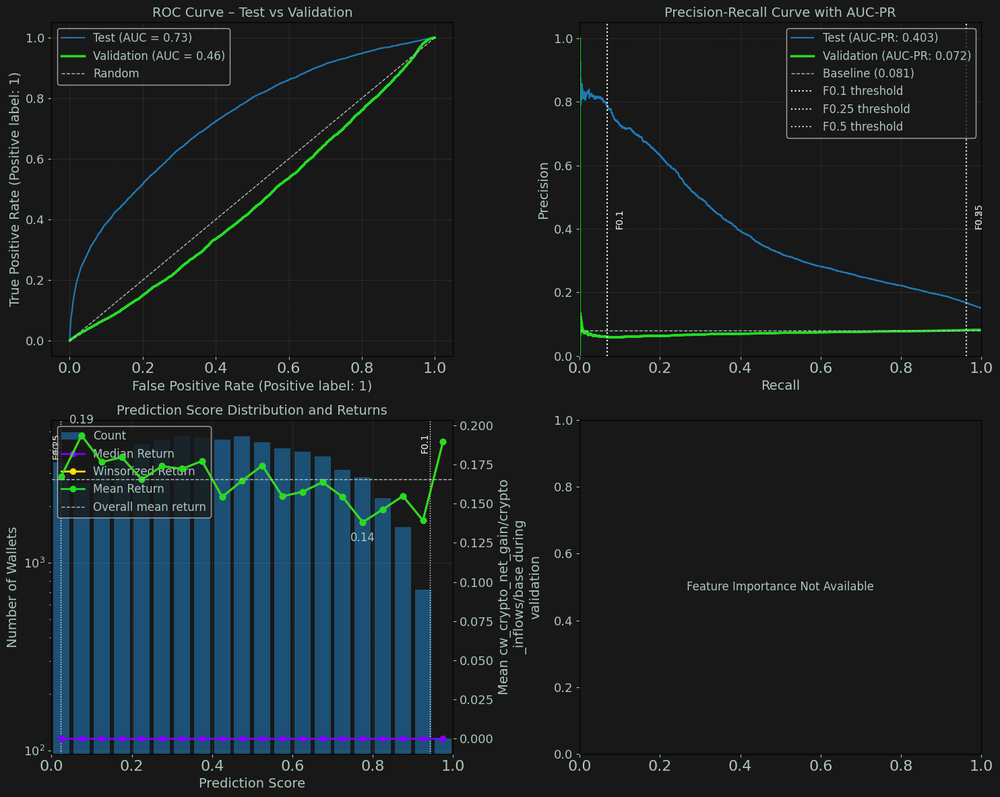

[10/Aug/25 23:47:25] INFO [2686379832.<module>:4] -------------------------------------------------
[10/Aug/25 23:47:25] WARNING [2686379832.<module>:5]                    0
[10/Aug/25 23:47:25] INFO [2686379832.<module>:6] -------------------------------------------------
[10/Aug/25 23:47:25] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: cw_crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh0/wscr-dda-951--sh0-0810-232252/output/model.tar.gz
Test Samples:             46,644
Val Positive Samples:     711 (1.9%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.585  |  0.714
Val Accuracy:               0.981  |  0.875
Val Precision:              0.308  |  0.642
Val Recall:                 0.006  |  0.198
Val F1 Score:               0.011  |  0.303

Validation Returns    | Cu

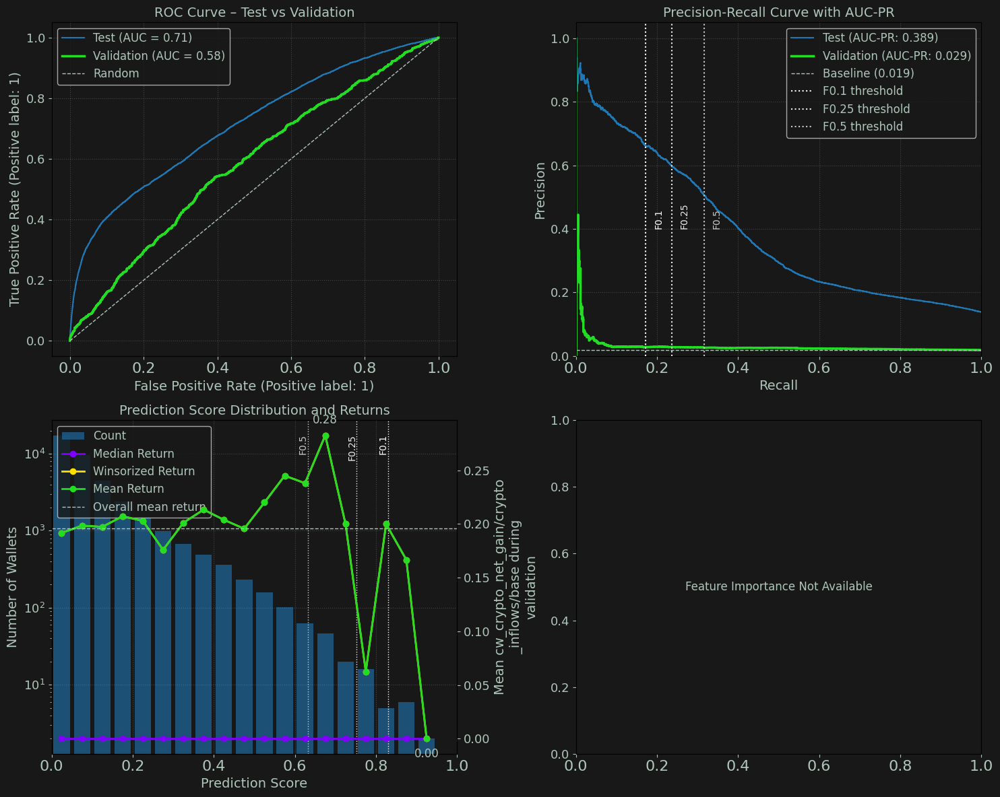

In [45]:
# 2 val offsets
for e in evaluators:
    # evaluators[e].summary_report()
    logger.info('-------------------------------------------------')
    logger.warning(f'                   {e}')
    logger.info('-------------------------------------------------')
    evaluators[e].summary_report()
    evaluators[e].plot_wallet_evaluation()


[10/Aug/25 23:17:32] INFO [3540484021.<module>:3] -------------------------------------------------
[10/Aug/25 23:17:32] WARNING [3540484021.<module>:4]                    -360
[10/Aug/25 23:17:32] INFO [3540484021.<module>:5] -------------------------------------------------
[10/Aug/25 23:17:32] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-360/wscr-dda-951--sh-360-0810-225050/output/model.tar.gz
Test Samples:             30,780
Val Positive Samples:     9,233 (5.1%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.696  |  0.522
Val Accuracy:               0.948  |  0.857
Val Precision:              0.141  |  0.669
Val Recall:                 0.002  |  0.048
Val F1 Score:               0.004  |  0.089

Validation Returns

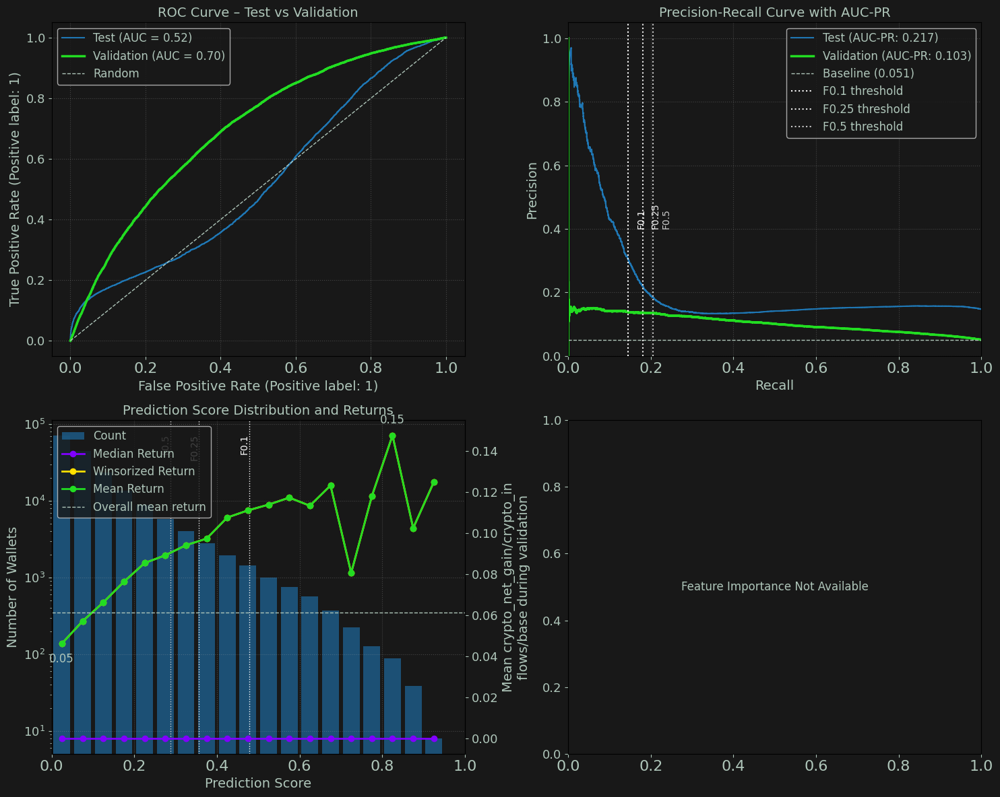

[10/Aug/25 23:17:33] INFO [3540484021.<module>:3] -------------------------------------------------
[10/Aug/25 23:17:33] WARNING [3540484021.<module>:4]                    -300
[10/Aug/25 23:17:33] INFO [3540484021.<module>:5] -------------------------------------------------
[10/Aug/25 23:17:33] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-300/wscr-dda-951--sh-300-0810-225050/output/model.tar.gz
Test Samples:             42,663
Val Positive Samples:     3,376 (1.7%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.560  |  0.601
Val Accuracy:               0.982  |  0.878
Val Precision:              0.016  |  0.702
Val Recall:                 0.001  |  0.073
Val F1 Score:               0.001  |  0.132

Validation Returns

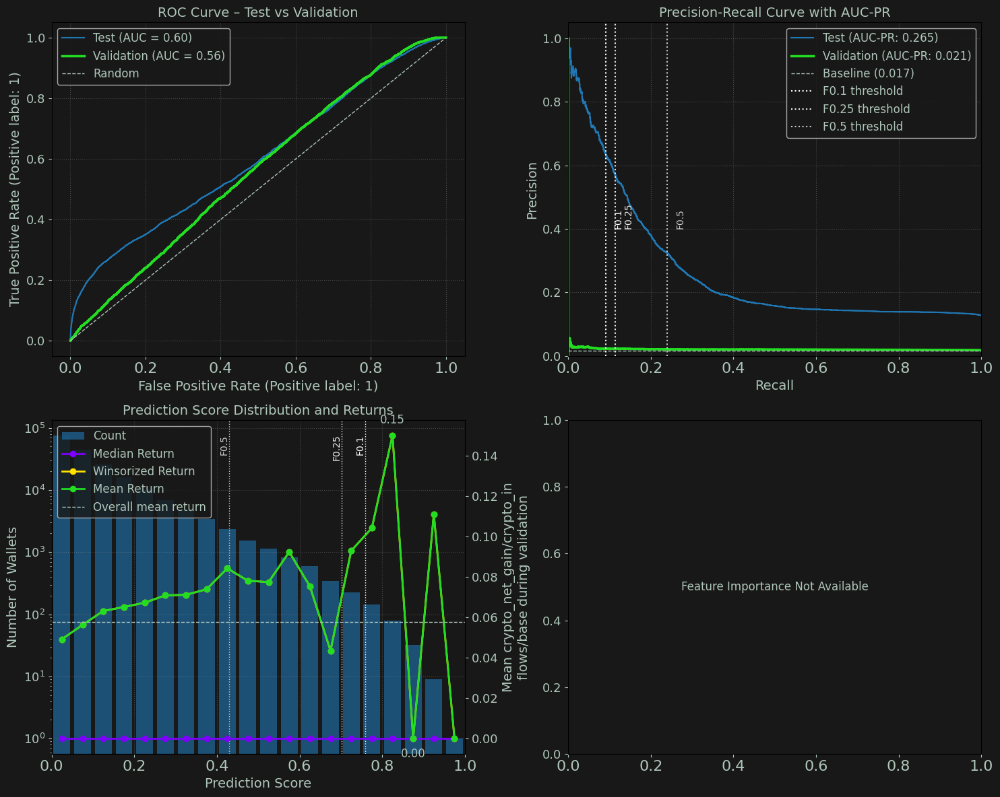

[10/Aug/25 23:17:33] INFO [3540484021.<module>:3] -------------------------------------------------
[10/Aug/25 23:17:33] WARNING [3540484021.<module>:4]                    -240
[10/Aug/25 23:17:33] INFO [3540484021.<module>:5] -------------------------------------------------
[10/Aug/25 23:17:33] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-240/wscr-dda-951--sh-240-0810-225050/output/model.tar.gz
Test Samples:             50,497
Val Positive Samples:     11,871 (7.3%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.537  |  0.668
Val Accuracy:               0.925  |  0.892
Val Precision:              0.045  |  0.694
Val Recall:                 0.001  |  0.073
Val F1 Score:               0.002  |  0.133

Validation Return

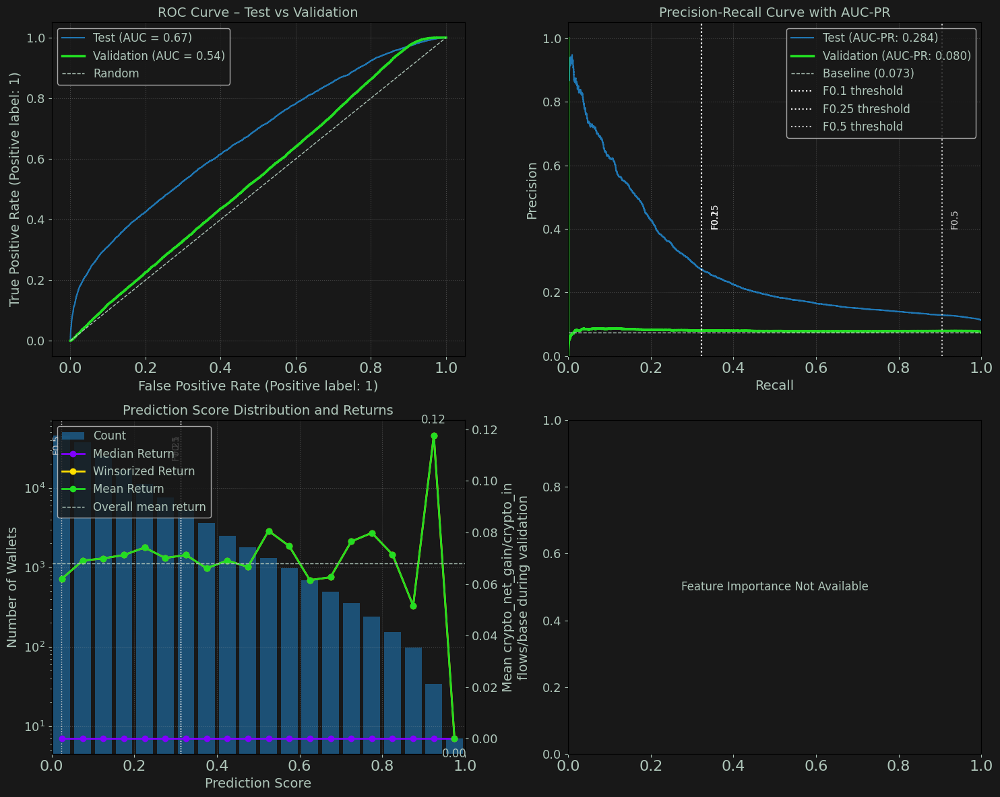

[10/Aug/25 23:17:33] INFO [3540484021.<module>:3] -------------------------------------------------
[10/Aug/25 23:17:33] WARNING [3540484021.<module>:4]                    -180
[10/Aug/25 23:17:33] INFO [3540484021.<module>:5] -------------------------------------------------
[10/Aug/25 23:17:33] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-180/wscr-dda-951--sh-180-0810-225050/output/model.tar.gz
Test Samples:             57,259
Val Positive Samples:     31,978 (16.8%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.385  |  0.665
Val Accuracy:               0.831  |  0.905
Val Precision:              0.083  |  0.670
Val Recall:                 0.001  |  0.053
Val F1 Score:               0.001  |  0.099

Validation Retur

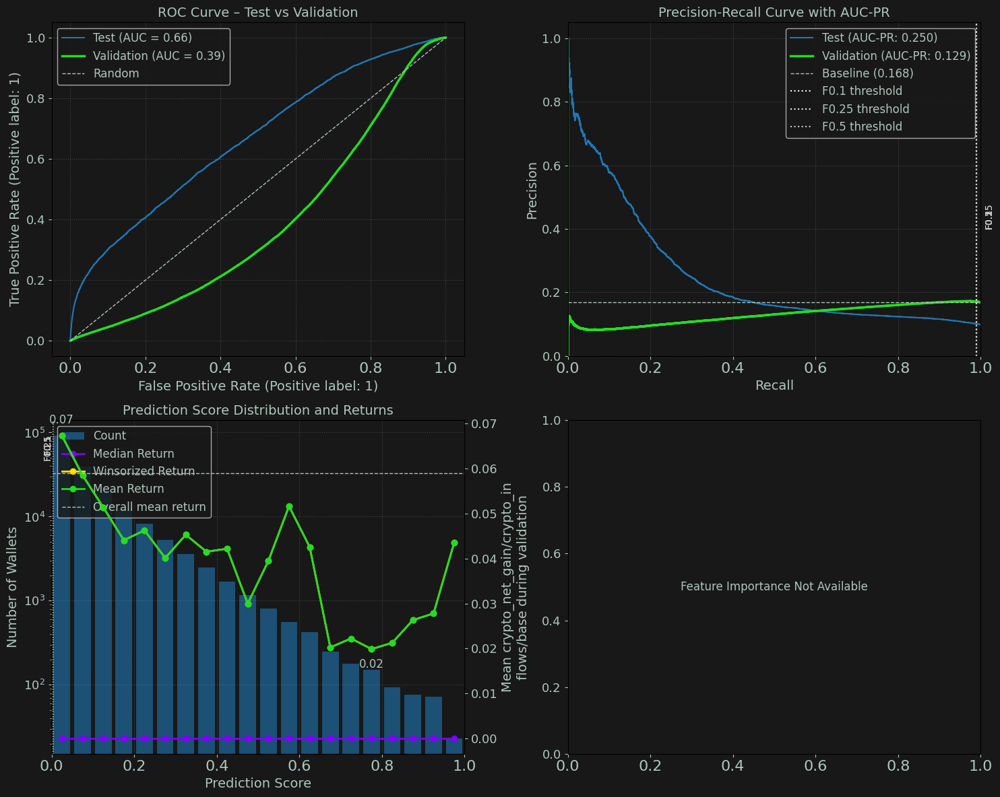

[10/Aug/25 23:17:34] INFO [3540484021.<module>:3] -------------------------------------------------
[10/Aug/25 23:17:34] WARNING [3540484021.<module>:4]                    -120
[10/Aug/25 23:17:34] INFO [3540484021.<module>:5] -------------------------------------------------
[10/Aug/25 23:17:34] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-120/wscr-dda-951--sh-120-0810-225050/output/model.tar.gz
Test Samples:             63,266
Val Positive Samples:     26,059 (11.2%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.508  |  0.654
Val Accuracy:               0.883  |  0.892
Val Precision:              0.082  |  0.681
Val Recall:                 0.004  |  0.078
Val F1 Score:               0.007  |  0.140

Validation Retur

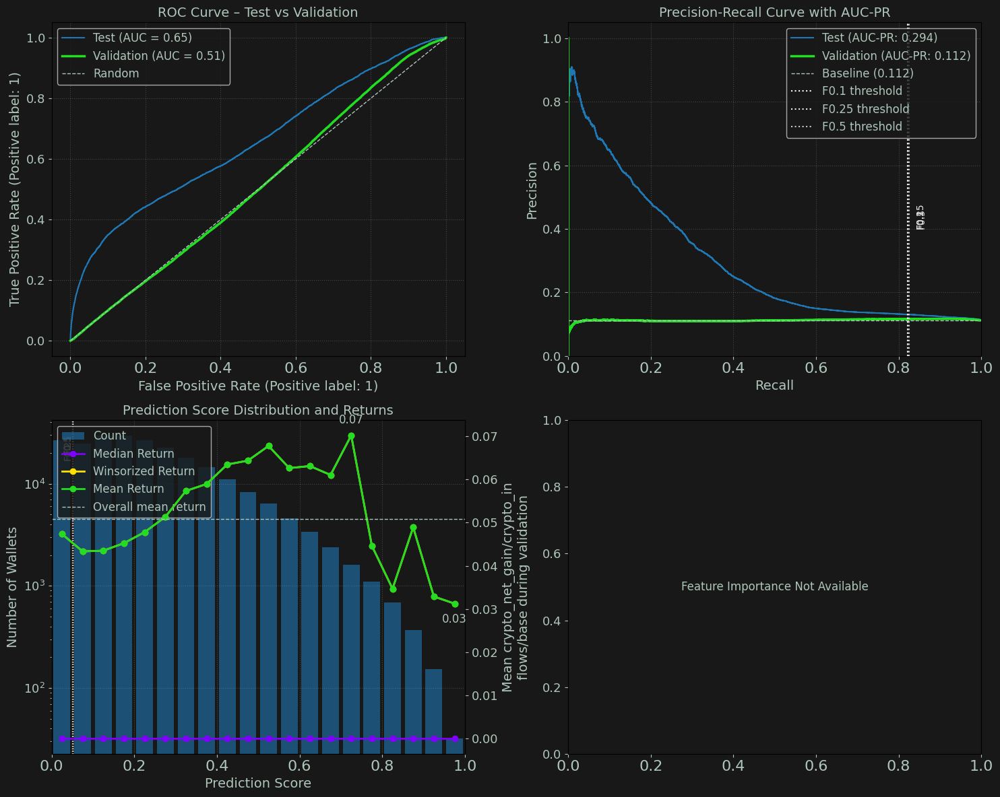

[10/Aug/25 23:17:34] INFO [3540484021.<module>:3] -------------------------------------------------
[10/Aug/25 23:17:34] WARNING [3540484021.<module>:4]                    -60
[10/Aug/25 23:17:34] INFO [3540484021.<module>:5] -------------------------------------------------
[10/Aug/25 23:17:34] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh-60/wscr-dda-951--sh-60-0810-225050/output/model.tar.gz
Test Samples:             74,771
Val Positive Samples:     5,428 (2.8%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.561  |  0.783
Val Accuracy:               0.905  |  0.893
Val Precision:              0.040  |  0.674
Val Recall:                 0.103  |  0.267
Val F1 Score:               0.058  |  0.382

Validation Returns   

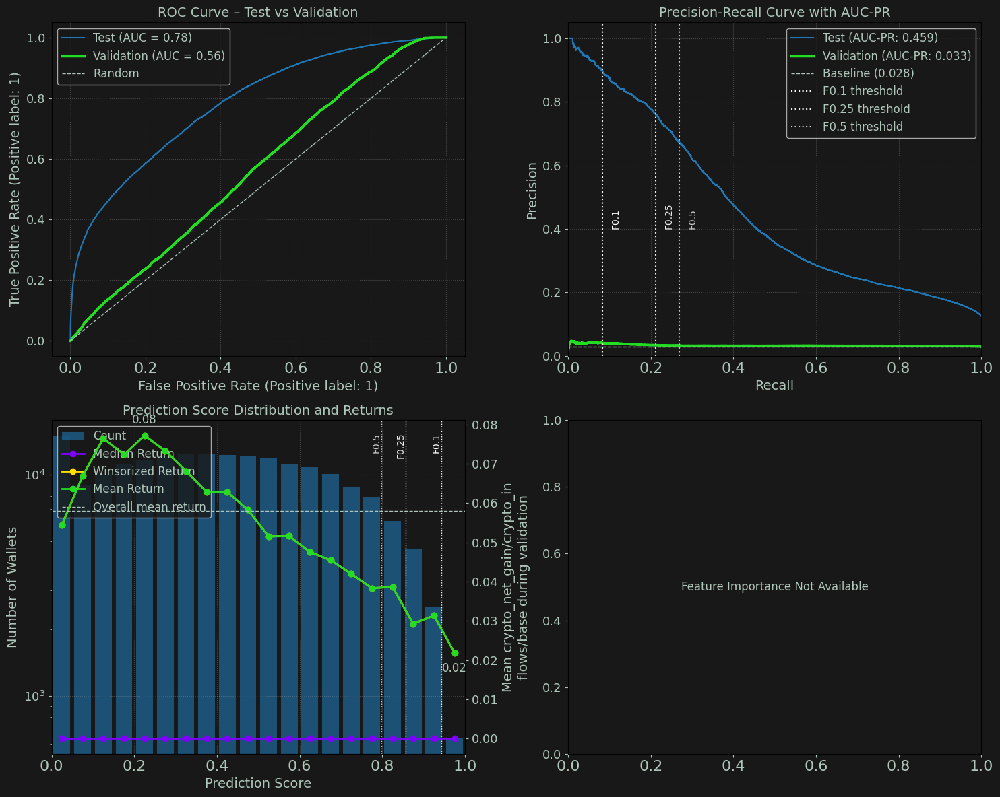

[10/Aug/25 23:17:35] INFO [3540484021.<module>:3] -------------------------------------------------
[10/Aug/25 23:17:35] WARNING [3540484021.<module>:4]                    0
[10/Aug/25 23:17:35] INFO [3540484021.<module>:5] -------------------------------------------------
[10/Aug/25 23:17:35] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-pr58-1/sh0/wscr-dda-951--sh0-0810-225050/output/model.tar.gz
Test Samples:             80,596
Val Positive Samples:     4,192 (3.7%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.820  |  0.740
Val Accuracy:               0.960  |  0.902
Val Precision:              0.186  |  0.732
Val Recall:                 0.026  |  0.244
Val F1 Score:               0.045  |  0.366

Validation Returns    | Cut

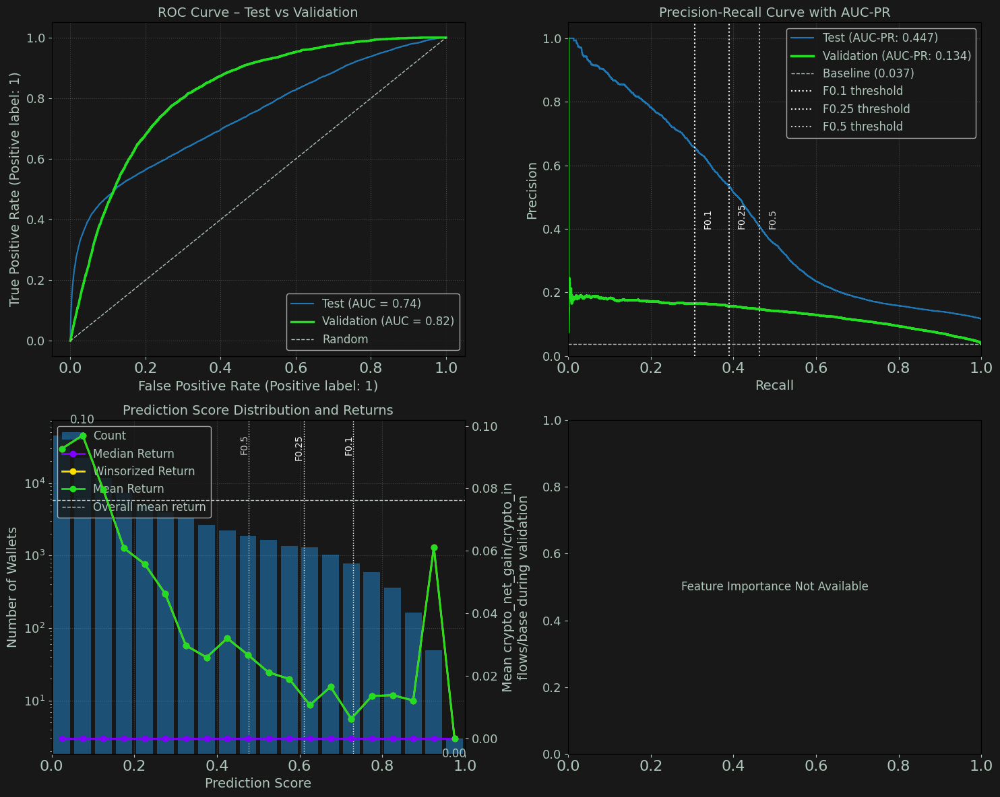

In [ ]:
# roll forward config
for e in evaluators:
    # evaluators[e].summary_report()
    logger.info('-------------------------------------------------')
    logger.warning(f'                   {e}')
    logger.info('-------------------------------------------------')
    evaluators[e].summary_report()
    evaluators[e].plot_wallet_evaluation()


[10/Aug/25 22:08:46] INFO [model_evaluation.summary_report:1097] 
Model Performance Summary
Objective: classification
Target: crypto_net_gain/crypto_inflows/base 0.3 to 
ID: s3://wallet-script-models/model-outputs/dda-951-eval-al-pr58/sh0/wscr-dda-951--sh0-0810-215718/output/model.tar.gz
Test Samples:             80,596
Val Positive Samples:     3,948 (5.2%)
Number of Features:       231

Classification Metrics:      Val   |  Test
-------------------------------------------
Val ROC AUC:                0.787  |  0.740
Val Accuracy:               0.943  |  0.902
Val Precision:              0.180  |  0.732
Val Recall:                 0.026  |  0.244
Val F1 Score:               0.046  |  0.366

Validation Returns    | Cutoff |  Mean   |  W-Mean
--------------------------------------------------
Overall Average       |    n/a |   0.077 |   0.077
Param Threshold       |   0.80 |   0.121 |   0.121
5 Highest Scores      |   0.95 |   0.200 |   0.200
Top 1% Scores         |   0.78 |   0.118 |   

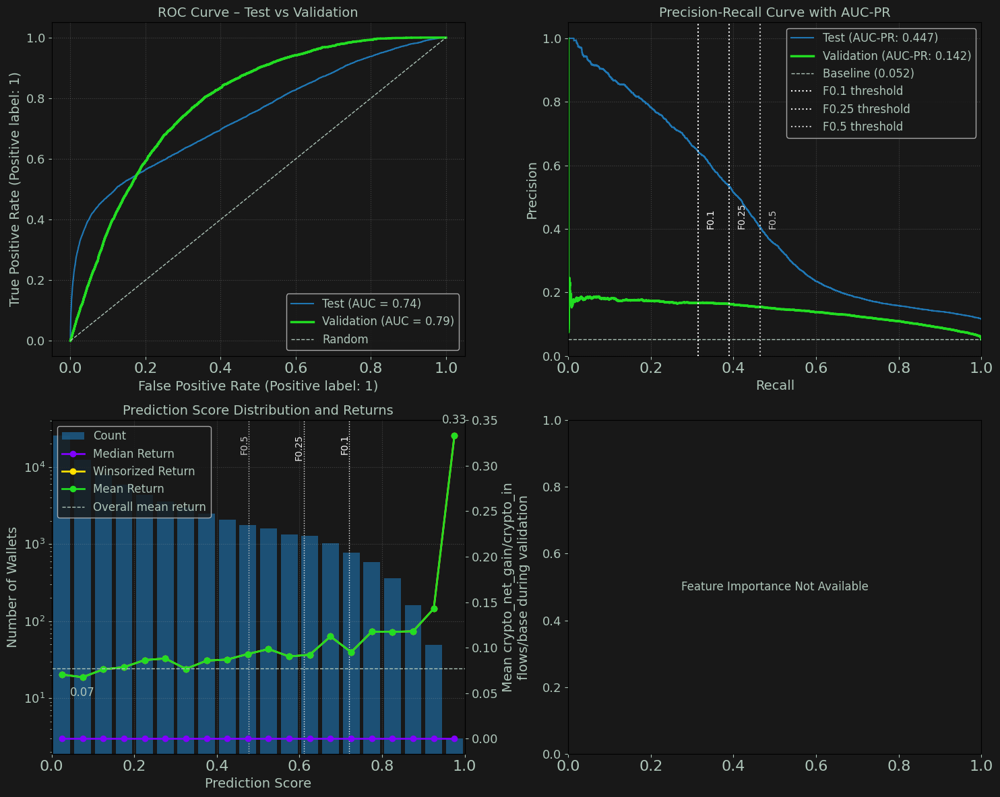

In [ ]:
for e in evaluators:
    # evaluators[e].summary_report()
    evaluators[e].plot_wallet_evaluation()


[08/Aug/25 19:19:36] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:690] Building evaluators for 2 epoch shifts using 4 threads...
[08/Aug/25 19:19:37] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0808-190236): s3://wallet-script-models/model-outputs/dda-951-eval-all-dev/sh60/wscr-dda-951--sh60-0808-190236/output/model.tar.gz
[08/Aug/25 19:19:37] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0808-190236): s3://wallet-script-models/model-outputs/dda-951-eval-all-dev/sh0/wscr-dda-951--sh0-0808-190236/output/model.tar.gz


Unique offset_date values in data: [1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0]
Target offset_days after 60 shift: [1350, 1380, 1410, 1440, 1470, 1500, 1530, 1560, 1590, 1620, 1650]
Unique offset_date values in data: [1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0]
Target offset_days after 60 shift: [1350, 1380, 1410, 1440, 1470, 1500, 1530, 1560, 1590, 1620, 1650]
No custom filters configured, returning unfiltered data
Unique offset_date values in data: [1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0]
Target offset_days after 0 shift: [1290, 1320, 1350, 1380, 1410, 1440, 1470, 1500, 1530, 1560, 1590]
Unique offset_date values in data: [1290.0, 1320.0, 1350.0, 1380.0, 1410.0, 1440.0, 1470.0, 1500.0, 1530.0, 1560.0, 1590.0, 1620.0, 1650.0]
Target offset_days after 0 shift: [1290, 1320, 1350, 1380, 1410, 1440, 1470, 15

[08/Aug/25 19:19:38] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:707] ✓ Built evaluator for epoch_shift=60
[08/Aug/25 19:19:38] MILESTONE [workflow_orchestrator.build_all_epoch_shift_evaluators:707] ✓ Built evaluator for epoch_shift=0


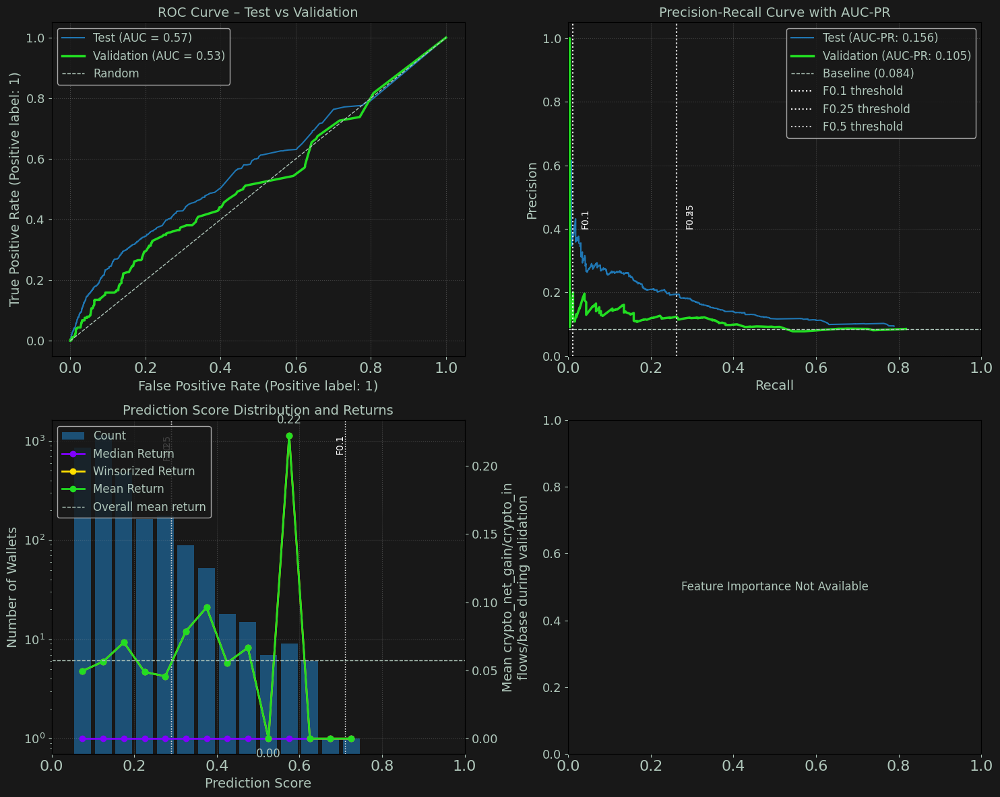

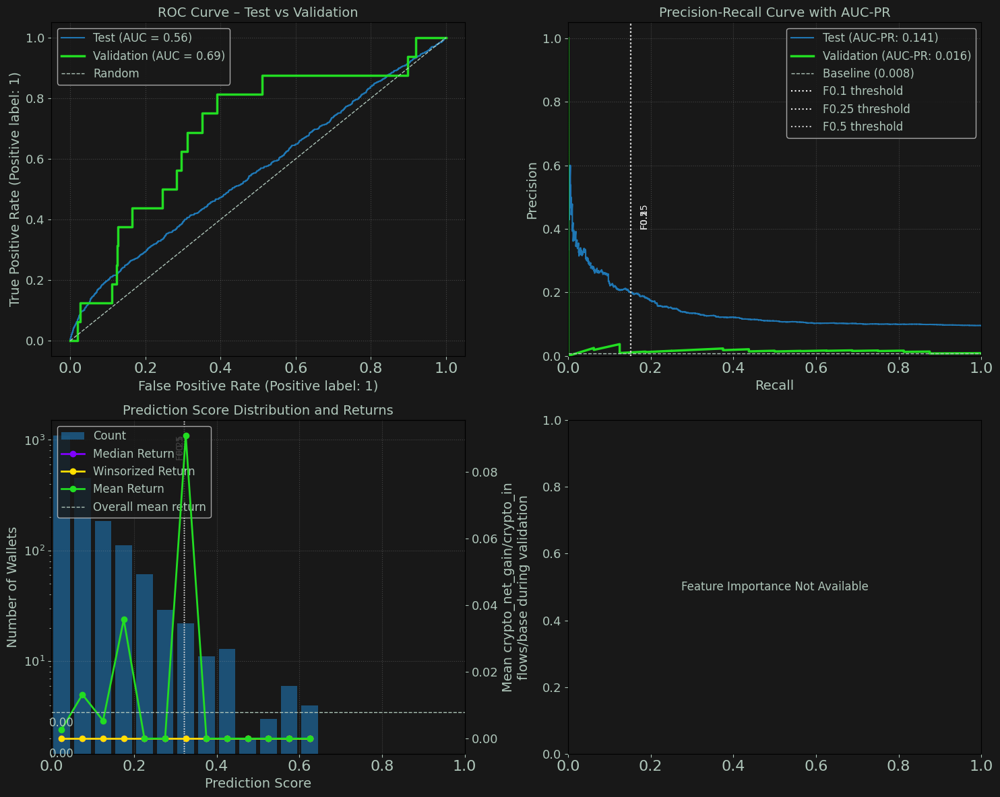

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


workflow_orch = wo.WalletWorkflowOrchestrator(sage_wallets_config,sage_wallets_modeling_config)
evaluators = workflow_orch.build_all_epoch_shift_evaluators()


In [8]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


# Load S3 URIs
workflow_orch = wo.WalletWorkflowOrchestrator(sage_wallets_config,sage_wallets_modeling_config)
s3_uris = workflow_orch.retrieve_training_data_uris(['concat'])

workflow_orch.predict_all_epoch_shifts()

[08/Aug/25 18:29:57] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:640] Starting predictions for 7 epoch shifts using 10 threads...
[08/Aug/25 18:29:58] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0808-182128): s3://wallet-script-models/model-outputs/dda-951-eval-all/sh240/wscr-dda-951--sh240-0808-182128/output/model.tar.gz
[08/Aug/25 18:29:58] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0808-182128): s3://wallet-script-models/model-outputs/dda-951-eval-all/sh-60/wscr-dda-951--sh-60-0808-182128/output/model.tar.gz
[08/Aug/25 18:29:58] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0808-182128): s3://wallet-script-models/model-outputs/dda-951-eval-all/sh0/wscr-dda-951--sh0-0808-182128/output/model.tar.gz
[08/Aug/25 18:29:58] INFO [wallet_modeler.load_existing_model:225] Loaded most recent script-mode model (timestamp: 0808-1821

...

[08/Aug/25 18:30:06] WARNING [session.submit:4116] Using already existing model: wscr-dda-951--sh60-0808-182128
[08/Aug/25 18:30:06] INFO [wallet_modeler._execute_batch_transform:624] Starting batch transform job: wallet-scoring-sh60-183006-concat-val
[08/Aug/25 18:30:06] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh60-183006-concat-val


.

[08/Aug/25 18:30:09] WARNING [session.submit:4116] Using already existing model: wscr-dda-951--sh240-0808-182128
[08/Aug/25 18:30:10] INFO [wallet_modeler._execute_batch_transform:624] Starting batch transform job: wallet-scoring-sh240-183009-concat-val
[08/Aug/25 18:30:10] INFO [session.submit:3962] Creating transform job with name: wallet-scoring-sh240-183009-concat-val


..............................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................!

[08/Aug/25 18:34:40] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh-60/wallet-scoring-sh-60-183004-concat-test/test.csv.out



..

[08/Aug/25 18:34:41] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh-60/test.csv.out.
[08/Aug/25 18:34:41] INFO [wallet_modeler.None:296] (4m42s) Completed predict_with_batch_transform.


...........................!

[08/Aug/25 18:34:54] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh240/wallet-scoring-sh240-182959-concat-test/test.csv.out



...

[08/Aug/25 18:34:54] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh240/test.csv.out.
[08/Aug/25 18:34:54] INFO [wallet_modeler.None:296] (4m56s) Completed predict_with_batch_transform.


..............................!

[08/Aug/25 18:35:11] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh0/wallet-scoring-sh0-183002-concat-test/test.csv.out



.

[08/Aug/25 18:35:11] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh0/test.csv.out.
[08/Aug/25 18:35:11] INFO [wallet_modeler.None:296] (5m13s) Completed predict_with_batch_transform.
[08/Aug/25 18:35:11] ERROR [workflow_orchestrator.predict_all_epoch_shifts:664] ✗ Failed predictions for epoch_shift=0: An error occurred (ThrottlingException) when calling the CreateModel operation (reached max retries: 4): Rate exceeded


.....!

[08/Aug/25 18:35:14] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh120/wallet-scoring-sh120-182959-concat-test/test.csv.out



..

[08/Aug/25 18:35:15] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh120/test.csv.out.
[08/Aug/25 18:35:15] INFO [wallet_modeler.None:296] (5m16s) Completed predict_with_batch_transform.
[08/Aug/25 18:35:15] ERROR [workflow_orchestrator.predict_all_epoch_shifts:664] ✗ Failed predictions for epoch_shift=120: An error occurred (ThrottlingException) when calling the CreateModel operation (reached max retries: 4): Rate exceeded


..!

[08/Aug/25 18:35:17] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh180/wallet-scoring-sh180-182959-concat-test/test.csv.out


[08/Aug/25 18:35:18] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh180/test.csv.out.
[08/Aug/25 18:35:18] INFO [wallet_modeler.None:296] (5m19s) Completed predict_with_batch_transform.


.........!

[08/Aug/25 18:35:24] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh300/wallet-scoring-sh300-183004-concat-test/test.csv.out



..

[08/Aug/25 18:35:25] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh300/test.csv.out.
[08/Aug/25 18:35:25] INFO [wallet_modeler.None:296] (5m26s) Completed predict_with_batch_transform.


....!

[08/Aug/25 18:35:30] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh60/wallet-scoring-sh60-183002-concat-test/test.csv.out



.

[08/Aug/25 18:35:30] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh60/test.csv.out.
[08/Aug/25 18:35:30] INFO [wallet_modeler.None:296] (5m31s) Completed predict_with_batch_transform.


..................!

[08/Aug/25 18:35:49] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh-60/wallet-scoring-sh-60-182959-concat-val/val.csv.out



.

[08/Aug/25 18:35:50] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh-60/val.csv.out.
[08/Aug/25 18:35:50] INFO [wallet_modeler.None:296] (5m52s) Completed predict_with_batch_transform.
[08/Aug/25 18:35:50] INFO [wallet_modeler.None:351] (5m52s) Completed batch_predict_test_and_val.
[08/Aug/25 18:35:50] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:662] ✓ Completed predictions for epoch_shift=-60


....!

[08/Aug/25 18:35:56] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh60/wallet-scoring-sh60-183006-concat-val/val.csv.out


[08/Aug/25 18:35:57] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh60/val.csv.out.
[08/Aug/25 18:35:57] INFO [wallet_modeler.None:296] (5m59s) Completed predict_with_batch_transform.
[08/Aug/25 18:35:57] INFO [wallet_modeler.None:351] (5m59s) Completed batch_predict_test_and_val.
[08/Aug/25 18:35:57] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:662] ✓ Completed predictions for epoch_shift=60


!

[08/Aug/25 18:35:58] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh180/wallet-scoring-sh180-183004-concat-val/val.csv.out


[08/Aug/25 18:35:59] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh180/val.csv.out.
[08/Aug/25 18:35:59] INFO [wallet_modeler.None:296] (6m0s) Completed predict_with_batch_transform.
[08/Aug/25 18:35:59] INFO [wallet_modeler.None:351] (6m0s) Completed batch_predict_test_and_val.
[08/Aug/25 18:35:59] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:662] ✓ Completed predictions for epoch_shift=180


..!

[08/Aug/25 18:36:05] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh300/wallet-scoring-sh300-182959-concat-val/val.csv.out



!

[08/Aug/25 18:36:05] INFO [wallet_modeler._execute_batch_transform:641] Batch transform completed. Predictions at: s3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh240/wallet-scoring-sh240-183009-concat-val/val.csv.out
[08/Aug/25 18:36:05] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh300/val.csv.out.
[08/Aug/25 18:36:05] INFO [wallet_modeler.None:296] (6m7s) Completed predict_with_batch_transform.
[08/Aug/25 18:36:05] INFO [wallet_modeler.None:351] (6m7s) Completed batch_predict_test_and_val.
[08/Aug/25 18:36:05] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:662] ✓ Completed predictions for epoch_shift=300


[08/Aug/25 18:36:06] INFO [s3_utils.download_from_uri:69] Stored file at ..//s3_downloads/wallet_predictions/dda_951_eval_all/sh240/val.csv.out.
[08/Aug/25 18:36:06] INFO [wallet_modeler.None:296] (6m7s) Completed predict_with_batch_transform.
[08/Aug/25 18:36:06] INFO [wallet_modeler.None:351] (6m7s) Completed batch_predict_test_and_val.
[08/Aug/25 18:36:06] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:662] ✓ Completed predictions for epoch_shift=240
[08/Aug/25 18:36:06] MILESTONE [workflow_orchestrator.predict_all_epoch_shifts:669] Epoch shift predictions complete: 5/7 successful


{0: {'error': 'An error occurred (ThrottlingException) when calling the CreateModel operation (reached max retries: 4): Rate exceeded'},
 120: {'error': 'An error occurred (ThrottlingException) when calling the CreateModel operation (reached max retries: 4): Rate exceeded'},
 -60: {'test': {'transform_job_name': 'wallet-scoring-sh-60-183004-concat-test',
   'predictions_uri': 's3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh-60/wallet-scoring-sh-60-183004-concat-test/test.csv.out',
   'input_data_uri': 's3://wallet-training-data/training-data-concatenated/dda-951-eval-all/test.csv'},
  'val': {'transform_job_name': 'wallet-scoring-sh-60-182959-concat-val',
   'predictions_uri': 's3://wallet-training-data/validation-data-scored/dda-951-eval-all/sh-60/wallet-scoring-sh-60-182959-concat-val/val.csv.out',
   'input_data_uri': 's3://wallet-training-data/training-data-concatenated/dda-951-eval-all/val.csv'},
  'model_uri': 's3://wallet-script-models/model-outputs/dda-951-

#### predict and filter data by epoch_shift

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


# Load S3 URIs
workflow_orch = wo.WalletWorkflowOrchestrator(sage_wallets_config,sage_wallets_modeling_config)
s3_uris = workflow_orch.retrieve_training_data_uris(['concat'])

epoch_shift = sage_wallets_config['training_data']['epoch_shifts'][0]

# Create modeler with epoch_shift as the date_suffix
shift_s3_uris = {f'sh{epoch_shift}': s3_uris['concat']}
concat_modeler = wm.WalletModeler(
    wallets_config=sage_wallets_config,
    modeling_config=sage_wallets_modeling_config,
    date_suffix=f'sh{epoch_shift}',
    s3_uris=shift_s3_uris,
    override_approvals=None
)

# Load the existing concatenated model
model_info = concat_modeler.load_existing_model(epoch_shift=epoch_shift)

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')

epoch_shift = sage_wallets_config['training_data']['epoch_shifts'][0]

date_suffix = f'sh{epoch_shift}'
y_test_pred = sime.load_bt_sagemaker_predictions('test', sage_wallets_config, date_suffix)
y_test      = sime.load_concatenated_y('test', sage_wallets_config, sage_wallets_modeling_config)
y_val_pred  = sime.load_bt_sagemaker_predictions('val', sage_wallets_config, date_suffix)
y_val       = sime.load_concatenated_y('val', sage_wallets_config, sage_wallets_modeling_config)


target_var = sage_wallets_modeling_config['target']['target_var']
y_test.columns = [target_var]
y_val.columns = [target_var]

# Single function call for complete evaluation
evaluator = sime.create_concatenated_sagemaker_evaluator(
    sage_wallets_config,
    sage_wallets_modeling_config,
    model_info['model_uri'],
    y_test_pred,
    y_test,
    y_val_pred,
    y_val,
    epoch_shift
)

In [ ]:
evaluator.summary_report()
evaluator.plot_wallet_evaluation()
# u.notify('soft_twinkle_musical')


### Single Model Sequence

#### train

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


workflow_orch = wo.WalletWorkflowOrchestrator(
    sage_wallets_config,
    sage_wallets_modeling_config
)
concat_uris = workflow_orch.upload_concatenated_training_data(overwrite_existing=False)
modeling_results = workflow_orch.train_concatenated_offsets_model(concat_uris)

#### evaluate HPO outcomes

In [ ]:
player = u.AmbientPlayer()
player.stop_all_players()

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')

workflow_orch = wo.WalletWorkflowOrchestrator(
    sage_wallets_config,
    sage_wallets_modeling_config
)
workflow_orch.get_hpo_results('concat')

In [ ]:
# Get the best hyperparameters
best_params = modeling_results['tuner'].best_training_job()

# Or more detailed info
analytics = modeling_results['tuner'].analytics()
best_job_df = analytics.dataframe()

# The best parameters are in the hyperparameters columns
print(best_params)
print(best_job_df.loc[0, ['eta', 'max_depth', 'subsample', 'FinalObjectiveValue']])

#### load existing model

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')

# Load S3 URIs
workflow_orch = wo.WalletWorkflowOrchestrator(sage_wallets_config,sage_wallets_modeling_config)
s3_uris = workflow_orch.retrieve_training_data_uris(['concat'])

# Create modeler with 'concat' as the date_suffix
concat_modeler = wm.WalletModeler(
    wallets_config=sage_wallets_config,
    modeling_config=sage_wallets_modeling_config,
    date_suffix='concat',
    s3_uris=s3_uris,
    override_approvals=None
)

# Step 2: Load the existing concatenated model
model_info = concat_modeler.load_existing_model(modeling_results['model_uri'])


In [ ]:
model_info

#### predict

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')

pred_results = concat_modeler.batch_predict_test_and_val()

#### evaluate

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')

date_suffix = 'concat'
y_test_pred = sime.load_bt_sagemaker_predictions('test', sage_wallets_config, date_suffix)
y_test      = sime.load_concatenated_y('test', sage_wallets_config, sage_wallets_modeling_config)
y_val_pred  = sime.load_bt_sagemaker_predictions('val', sage_wallets_config, date_suffix)
y_val       = sime.load_concatenated_y('val', sage_wallets_config, sage_wallets_modeling_config)


target_var = sage_wallets_modeling_config['target']['target_var']
y_test.columns = [target_var]
y_val.columns = [target_var]

# Single function call for complete evaluation
evaluator = sime.create_concatenated_sagemaker_evaluator(
    sage_wallets_config,
    sage_wallets_modeling_config,
    model_info['model_uri'],
    y_test_pred,
    y_test,
    y_val_pred,
    y_val,
)

In [ ]:
# auc pr 0.4 all history
logger.info(modeling_results['model_uri'])
evaluator.summary_report()
evaluator.plot_wallet_evaluation()
# u.notify('soft_twinkle_musical')


In [ ]:
# auc pr 0.4 all history
logger.info(modeling_results['model_uri'])
evaluator.summary_report()
evaluator.plot_wallet_evaluation()
# u.notify('soft_twinkle_musical')


In [ ]:
# auc pr 0.4 mktcap 20M-4B
logger.info(modeling_results['model_uri'])
evaluator.summary_report()
evaluator.plot_wallet_evaluation()
# u.notify('soft_twinkle_musical')


In [ ]:
# auc pr mktcap 20M-4B, z score 1.5
evaluator.summary_report()
evaluator.plot_wallet_evaluation()
u.notify('soft_twinkle_musical')


In [ ]:
# auc pr mktcap 20M-4B, inflows $5k
evaluator.summary_report()
evaluator.plot_wallet_evaluation()
u.notify('soft_twinkle_musical')


In [ ]:
# auc pr mktcap 20M-4B, z score 1.5
evaluator.summary_report()
evaluator.plot_wallet_evaluation()
u.notify('soft_twinkle_musical')


## Temporal cv model

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


date_suffixes = [
    '231008',
    '231107',
    '240306',
    '241101',
    '250301'
]
workflow_orch = wo.WalletWorkflowOrchestrator(sage_wallets_config,sage_wallets_modeling_config)
workflow_orch.load_all_training_data(date_suffixes)
s3_uris = workflow_orch.retrieve_training_data_uris(date_suffixes)

In [ ]:
sm.train_temporal_cv_script_model(sage_wallets_config,sage_wallets_modeling_config,cv_s3_uri)

### Predict Using Endpoints

#### deploy endpoint for predictions

In [ ]:
modeler.list_active_endpoints()

In [ ]:
modeler.deploy_endpoint()

#### load and preprocess test/val dfs

In [ ]:
x_test = pd.read_parquet(
    Path("../s3_uploads/wallet_training_data_queue") /
    sage_wallets_config['training_data']['local_directory'] /
    f"x_test_{date_suffix}.parquet"
)
x_val = pd.read_parquet(
    Path("../s3_uploads/wallet_training_data_queue") /
    sage_wallets_config['training_data']['local_directory'] /
    f"x_val_{date_suffix}.parquet"
)




In [ ]:
preprocessor = SageWalletsPreprocessor(sage_wallets_config)
x_test_processed = preprocessor.preprocess_x_df(x_test)
x_val_processed = preprocessor.preprocess_x_df(x_val)

logger.info(f"Preprocessed X_test {x_test_processed.shape} and "
            f"X_val {x_val_processed.shape}.")

#### predict

In [ ]:
y_test_pred = modeler.predict_using_endpoint(x_test_processed, 'test')
y_val_pred = modeler.predict_using_endpoint(x_val_processed, 'val')

#### delete all endpoints

In [ ]:
modeler.delete_all_endpoints()

In [ ]:
modeler.list_active_endpoints()
modeler.list_all_endpoints()

# Model Evaluation

### Analyze predictions

In [ ]:
[importlib.reload(module) for module in modules]
sage_wallets_config = ucv.load_sage_wallets_config('../config/sage_wallets_config.yaml')
sage_wallets_modeling_config = ucv.load_sage_wallets_modeling_config('../config/sage_wallets_modeling_config.yaml')


date_suffixes = [
    '231008',
    # '240306'
]
date_suffix = date_suffixes[0]

In [ ]:
y_test_pred = sime.load_bt_sagemaker_predictions('test', sage_wallets_config, date_suffix)
y_val_pred = sime.load_bt_sagemaker_predictions('val', sage_wallets_config, date_suffix)

In [ ]:
# Single function call for complete evaluation
evaluator = sime.run_sagemaker_evaluation(
    sage_wallets_config,
    sage_wallets_modeling_config,
    date_suffix,
    y_test_pred,
    y_val_pred
)

In [ ]:
evaluator.y_validation

In [ ]:
evaluator.y_validation_pred_proba

In [ ]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

fpr, tpr, _ = roc_curve(evaluator.y_validation, evaluator.y_validation_pred_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.3f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label='Random classifier')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Validation Set')
plt.legend(loc="lower right")
plt.grid(True, alpha=0.3)
plt.show()

In [ ]:
evaluator.summary_report()
evaluator.plot_wallet_evaluation()


In [ ]:
def load_sagemaker_predictions(
    data_type: str,
    sage_wallets_config: dict,
    sage_wallets_modeling_config: dict,
    date_suffix: str
) -> tuple[pd.Series, pd.Series]:
    """
    Load SageMaker predictions and corresponding actuals for a given data type.

    Params:
    - data_type (str): Either 'test' or 'val'
    - sage_wallets_config (dict): Configuration for training data paths
    - sage_wallets_modeling_config (dict): Configuration for model parameters
    - date_suffix (str): Date suffix for file naming

    Returns:
    - tuple: (predictions_series, actuals_series) with aligned indices
    """
    # Load predictions
    pred_path = Path(sage_wallets_modeling_config['metaparams']['endpoint_preds_dir']) / \
                f"endpoint_y_pred_{data_type}_{sage_wallets_config['training_data']['local_directory']}_{date_suffix}.csv"
    pred_df = pd.read_csv(pred_path)

    if 'score' not in pred_df.columns:
        raise ValueError(f"SageMaker predictions are missing the 'score' column. "
                        f"Available columns: {pred_df.columns}")
    pred_series = pred_df['score']

    # Load actuals
    training_data_path = (
        Path(f"../s3_uploads") / "wallet_training_data_queue" /
        f"{sage_wallets_config['training_data']['local_directory']}"
    )
    actuals_path = training_data_path / f"y_{data_type}_{date_suffix}.parquet"
    actuals_df = pd.read_parquet(actuals_path)

    if len(actuals_df.columns) > 1:
        raise ValueError(f"Found unexpected columns in y_{data_type}_df. "
                        f"Expected 1 column, found {actuals_df.columns}.")
    actuals_series = actuals_df.iloc[:, 0]

    # Validate lengths and align indices
    if len(pred_series) != len(actuals_series):
        raise ValueError(f"Length of y_{data_type}_pred ({len(pred_series)}) does "
                        f"not match length of y_{data_type}_true ({len(actuals_series)}).")

    pred_series.index = actuals_series.index

    return pred_series, actuals_series

In [ ]:
# Load predictions and actuals
y_test_pred_series, y_test_true_series = load_sagemaker_predictions(
    'test', sage_wallets_config, sage_wallets_modeling_config, date_suffix
)
y_val_pred_series, y_val_true_series = load_sagemaker_predictions(
    'val', sage_wallets_config, sage_wallets_modeling_config, date_suffix
)

# Load remaining training data
training_data_path = (
    Path(f"../s3_uploads") / "wallet_training_data_queue" /
    f"{sage_wallets_config['training_data']['local_directory']}"
)
X_train = pd.read_parquet(training_data_path / f"x_train_{date_suffix}.parquet")
y_train = pd.read_parquet(training_data_path / f"y_train_{date_suffix}.parquet")
X_test = pd.read_parquet(training_data_path / f"x_test_{date_suffix}.parquet")
X_val = pd.read_parquet(training_data_path / f"x_val_{date_suffix}.parquet")

# Identify target variable and model type
target_variable = y_val_true_series.name or y_train.columns[0]
objective = sage_wallets_modeling_config['training']['hyperparameters']['objective']
model_type = 'regression' if objective[:3] == 'reg' else 'unknown'

In [ ]:
# Create model_id and modeling_config
model_id = f"sagemaker_{sage_wallets_config['training_data']['local_directory']}_{date_suffix}"

modeling_config = {
    'target_variable': target_variable,
    'model_type': model_type,
    'returns_winsorization': 0.005,  # Default for winsorizing returns
    'training_data': {
        'modeling_period_duration': 30  # Default performance window
    },
    'sagemaker_metadata': {
        'objective': objective,
        'local_directory': sage_wallets_config['training_data']['local_directory'],
        'date_suffix': date_suffix
    }
}

# Create minimal wallet_model_results for SageMaker evaluation
wallet_model_results = {
    'model_id': model_id,
    'modeling_config': modeling_config,
    'model_type': model_type,

    # Training data
    'X_train': X_train,
    'X_test': X_test,
    'y_train': y_train,
    'y_test': y_test_true_series,
    'y_pred': y_test_pred_series,
    'training_cohort_pred': None,
    'training_cohort_actuals': None,

    # Validation data
    'X_validation': X_val,
    'y_validation': y_val_true_series,
    'y_validation_pred': y_val_pred_series,
    'validation_target_vars_df': None,

    # Fixed mock pipeline
    'pipeline': type('MockPipeline', (), {
        'named_steps': {'estimator': type('MockModel', (), {
            'get_params': lambda self: {'objective': objective}  # Accept self argument
        })()},
        '__getitem__': lambda self, key: type('MockTransformer', (), {
            'transform': lambda self, X: X  # Accept self argument
        })()
    })()
}

# Create evaluator
wallet_evaluator = wime.RegressorEvaluator(wallet_model_results)

# Run basic evaluation
wallet_evaluator.summary_report()
wallet_evaluator.plot_wallet_evaluation()

In [ ]:
target_variable